In [1]:
%matplotlib inline
import caffe
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from matplotlib.patches import Rectangle
import matplotlib.gridspec as gridspec
import math
import scipy
import seaborn as sns
import PIL.Image
from cStringIO import StringIO
import IPython.display

In [2]:
net = caffe.Net("affinity_g0_p1_rec1_astrat0_b1_h4.model",
                caffe.TEST,
                weights="weights/plain_iter_150000.caffemodel")

#now use matplotlib to make bar graphs of each list in all_weights

elements = ["AliphaticCarbonXSHydrophobe",
            "AliphaticCarbonXSNonHydrophobe",
            "AromaticCarbonXSHydrophobe",
            "AromaticCarbonXSNonHydrophobe",
            "Calcium",
            "Iron",
            "Magnesium",
            "Nitrogen",
            "NitrogenXSAcceptor",
            "NitrogenXSDonor",
            "NitrogenXSDonorAcceptor",
            "OxygenXSAcceptor",
            "OxygenXSDonorAcceptor",
            "Phosphorus",
            "Sulfur",
            "Zinc",
            "AliphaticCarbonXSHydrophobe",
            "AliphaticCarbonXSNonHydrophobe",
            "AromaticCarbonXSHydrophobe",
            "AromaticCarbonXSNonHydrophobe",
            "Bromine",
            "Chlorine",
            "Fluorine",
            "Nitrogen",
            "NitrogenXSAcceptor",
            "NitrogenXSDonor",
            "NitrogenXSDonorAcceptor",
            "Oxygen",
            "OxygenXSAcceptor",
            "OxygenXSDonorAcceptor",
            "Phosphorus",
            "Sulfur",
            "SulfurAcceptor",
            "Iodine",
            "Boron"]

#the fourth layer is the first convolutional layer
conv = net.layers[4]
#zero represents the weights
weights = conv.blobs[0].data

all_weights = []

for filter in weights:
    means = filter.mean(axis=(1,2,3))
    all_weights.append(means)

In [3]:
def make_plot(x,y,lim=None,title="Test"):
    fig,ax = plt.subplots(figsize=(20,10))
    ax.bar(range(len(x)),y,width=0.8, color='r')
    ax.set_xticks(range(len(x)),x)
    ax.tick_params(labelsize=16)
    ax.set_xticklabels(x,rotation='vertical')
    plt.xticks(range(len(x)),x)
    plt.title(title,size=20)
    if(lim != None):
         plt.ylim(lim)
            
def scatter3d(x,y,z, cs,name ,colorsMap='RdBu',rotate=(0,0)):
    cm = plt.get_cmap(colorsMap)
    cNorm = matplotlib.colors.Normalize(vmin=min(cs), vmax=max(cs))
    scalarMap = matplotlib.cm.ScalarMappable(norm=cNorm, cmap=cm)
    fig = plt.figure()
    ax = Axes3D(fig)
    ax.scatter(x, y, z, c=scalarMap.to_rgba(cs),s=80)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.view_init(rotate[0],rotate[1])
    scalarMap.set_array(cs)
    fig.colorbar(scalarMap,label=name)
    plt.show()

norms = np.mean(weights,axis=(0,2,3,4))
def calculate_deviation(arr):
    mean = np.mean(arr)
    deviation_x = 0
    deviation_y = 0
    deviation_z = 0
    for i in range(3):
        for j in range(3):
            deviation_x+=np.abs(((arr[0][i][j]-arr[2][i][j])/mean))
    for i in range(3):
        for j in range(3):
            deviation_y+=np.abs(((arr[i][0][j]-arr[i][2][j])/mean))
    
    for i in range(3):
        for j in range(3):
            deviation_z+=np.abs(((arr[i][j][0]-arr[i][j][2])/mean))
    
    return (deviation_x,deviation_y,deviation_z)

def compute_product_two(arr1,arr2):
    arr1_c = arr1.flatten()
    arr2_c = arr2.flatten()
    diff = np.mean(np.multiply(arr1_c,arr2_c))
    return diff
def compute_difference_two(arr1,arr2):
    arr1_c = arr1.flatten()
    arr2_c = arr2.flatten()
    diff = np.mean(np.subtract(arr1_c,arr2_c))
    return diff
#function to compute the symetry of a 3x3x3 array
def compute_symetry(arr):
    #this computes the symetry of the 3x3x3 sections by comparing each value to the one across each axis
    sym = 0
    for i in range(3):
        for j in range(3):
            sym+=abs(arr[0][i][j]-arr[2][i][j])
            sym+=abs(arr[i][0][j]-arr[i][2][j])
            sym+=abs(arr[i][j][0]-arr[i][j][2])
    return sym
#function to compute the symetry of a 3x3x3 array
def compute_edge_index(arr):
    #this computes the symetry of the 3x3x3 sections by comparing each value to the one across each axis
    sym_x = 0
    sym_y =0
    sym_z = 0
    for i in range(3):
        for j in range(3):
            sym_x+=abs(arr[0][i][j]-arr[2][i][j])
            sym_y+=abs(arr[i][0][j]-arr[i][2][j])
            sym_z+=abs(arr[i][j][0]-arr[i][j][2])
    return (sym_x,sym_y,sym_z)


def showarray(a, fmt='png'):
    a = np.uint8(a)
    f = StringIO()
    PIL.Image.fromarray(a).save(f, fmt)
    IPython.display.display(IPython.display.Image(data=f.getvalue()))

def create_image(arr,scale=30):
    maximum = np.amax(arr)
    minimum = np.amin(arr)
    range_ = maximum-minimum
    if range_ ==0:
        range_ = 2
    img = np.array([((num+abs(minimum))/range_ * 255) for num in arr.flatten()]).reshape(3,3,3)
    print("create")
    img=scipy.misc.imresize(img,(300,300),interp='nearest')
    showarray(img)
    
def display_heatmap_grid((x,y), data,colorbar):
    fig, axn = plt.subplots(x,y,sharex=True, sharey=True,figsize=(6*y,6.5*x))
    cbar_ax = fig.add_axes([.1, -.04, .8, .05])
    fig.set_facecolor('white')
    cbar_ax.tick_params(labelsize=48)
    plt.rcParams["axes.grid"] = True
    #fig.suptitle('Heatmaps of the CNN Filter Pairwise Weight Comparison of Chemical Elements', fontsize=18, family="sans-serif",y=.995)
    for i,ax in enumerate(axn.flat):
        sns.heatmap(data[i],cmap='seismic_r',ax = ax,  cbar = i==0,robust=False, vmin=colorbar[0], vmax=colorbar[1],cbar_kws = dict(use_gridspec=True,orientation="horizontal"),cbar_ax =None if i else cbar_ax)
        ax.invert_yaxis()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    fig.tight_layout(rect=[0, 0.03, 1, 0.95],pad=.5)
    rect = Rectangle((0.0, 0.03), 1, .92, facecolor='black', edgecolor='none',
                 transform=fig.transFigure, zorder=-1)
    fig.patches.append(rect)
    fig.savefig("/home/alec/fig.pdf")
    
def apply_operation(data,func):
    vals = []
    for filter in data:
        diff =[]
        for i,elem in enumerate(filter):
            elem_diff = []
            for j,elem1 in enumerate(filter):
                elem_diff.append(func(elem,elem1))
             #elem_diff.insert(16,0.0)
            diff.append(elem_diff)
    
        #diff.insert(16,np.asarray(np.zeros((36))))
        vals.append(diff)
    return vals


/usr/lib/python2.7/dist-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


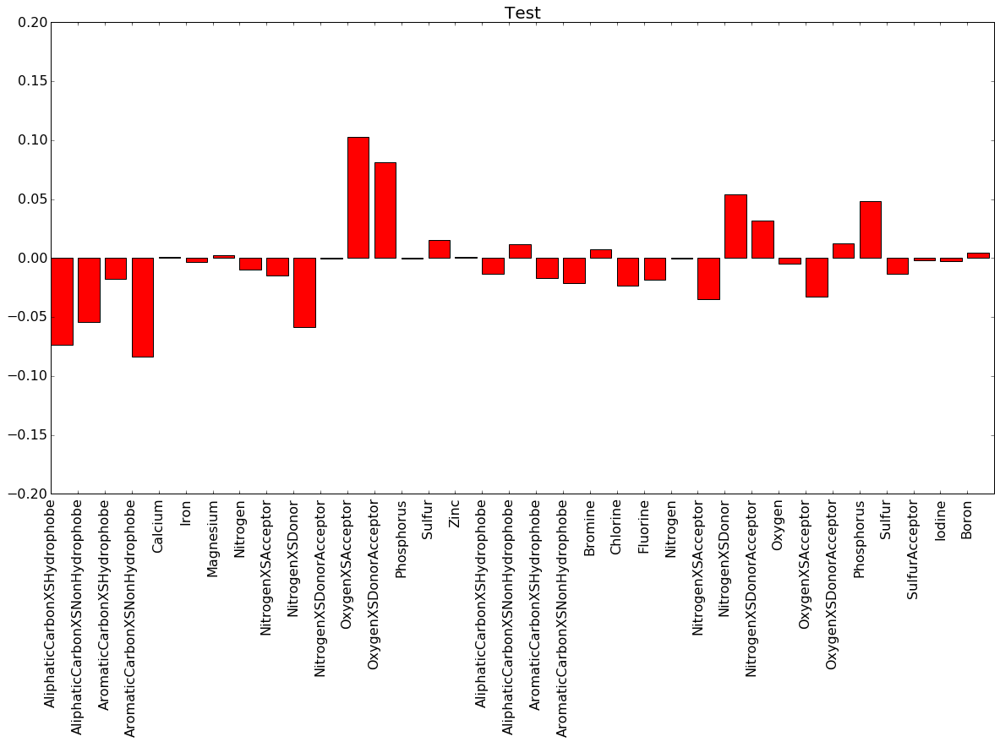

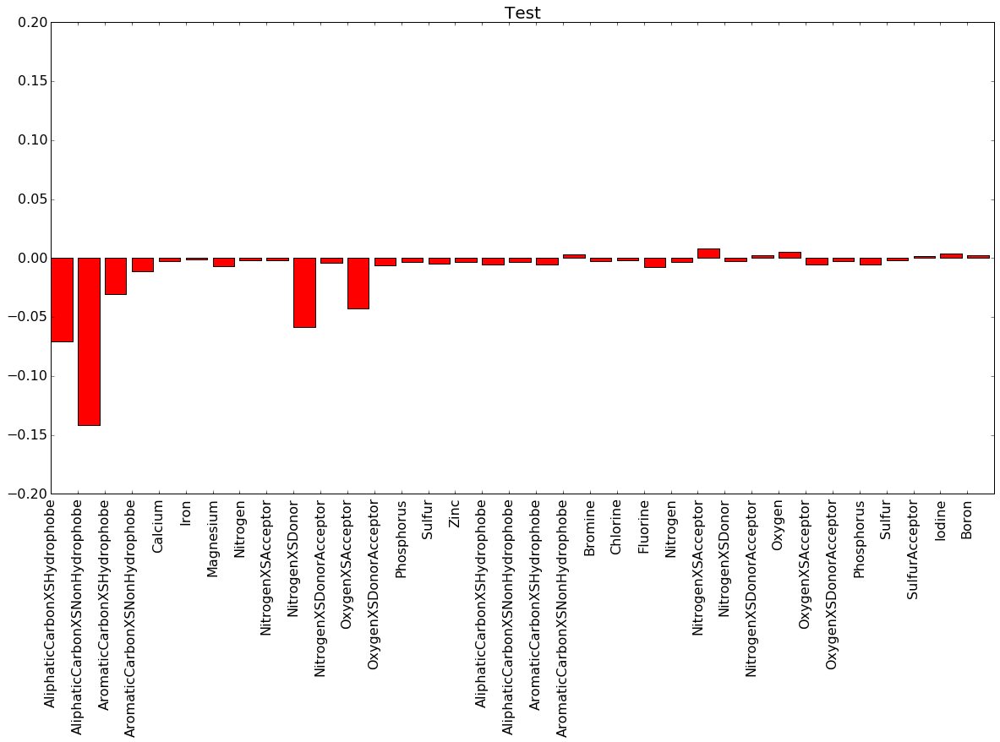

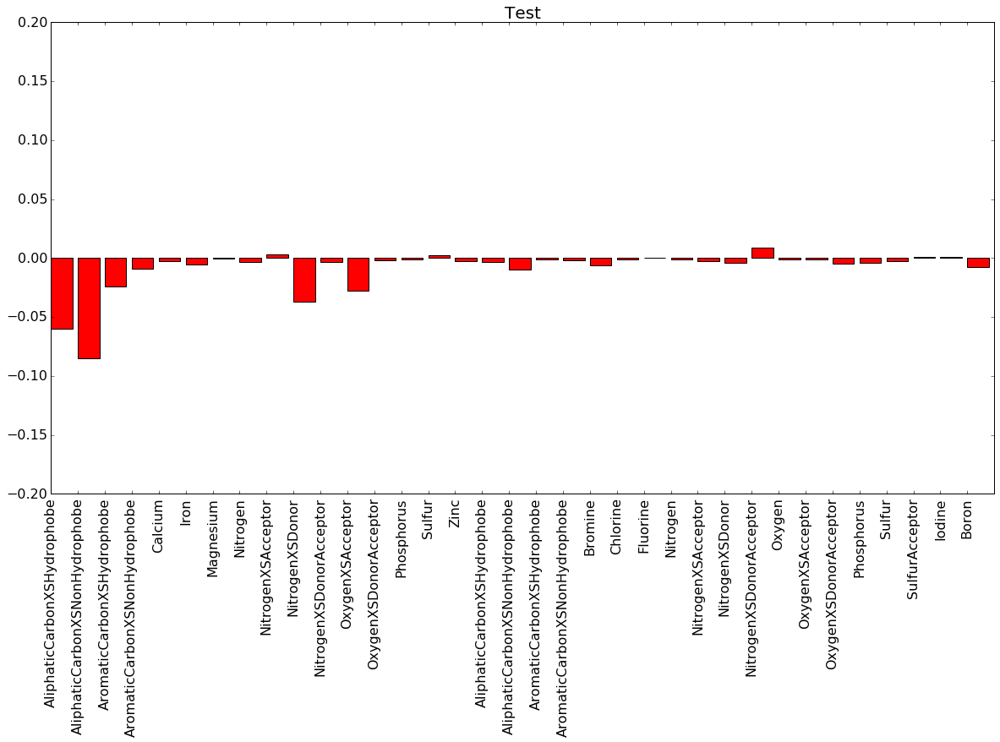

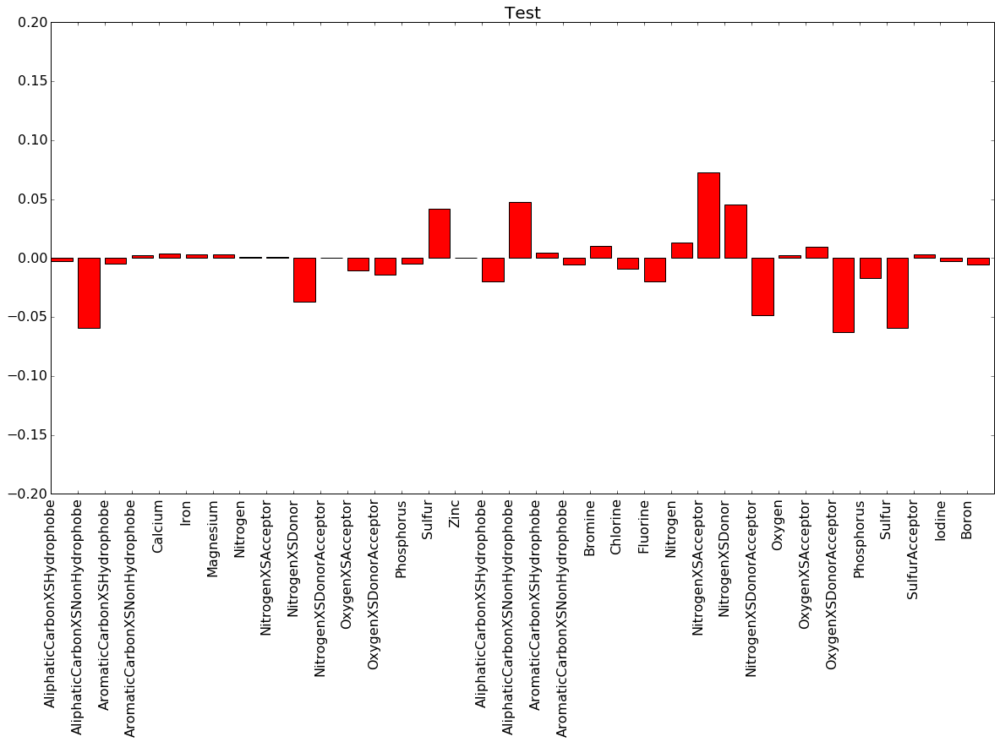

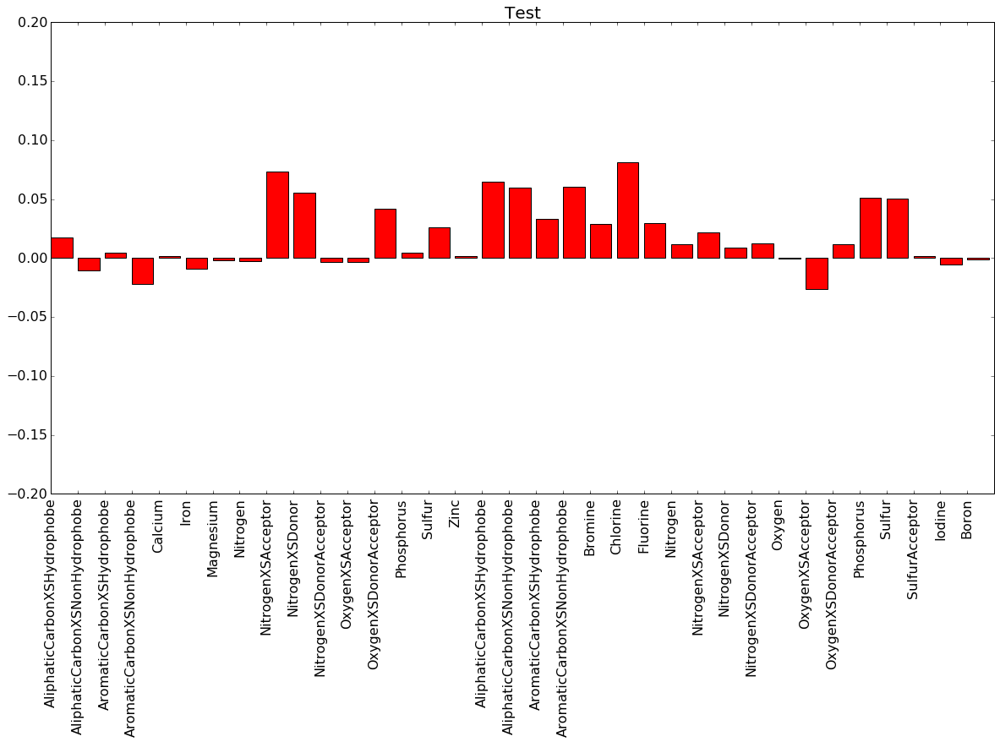

...

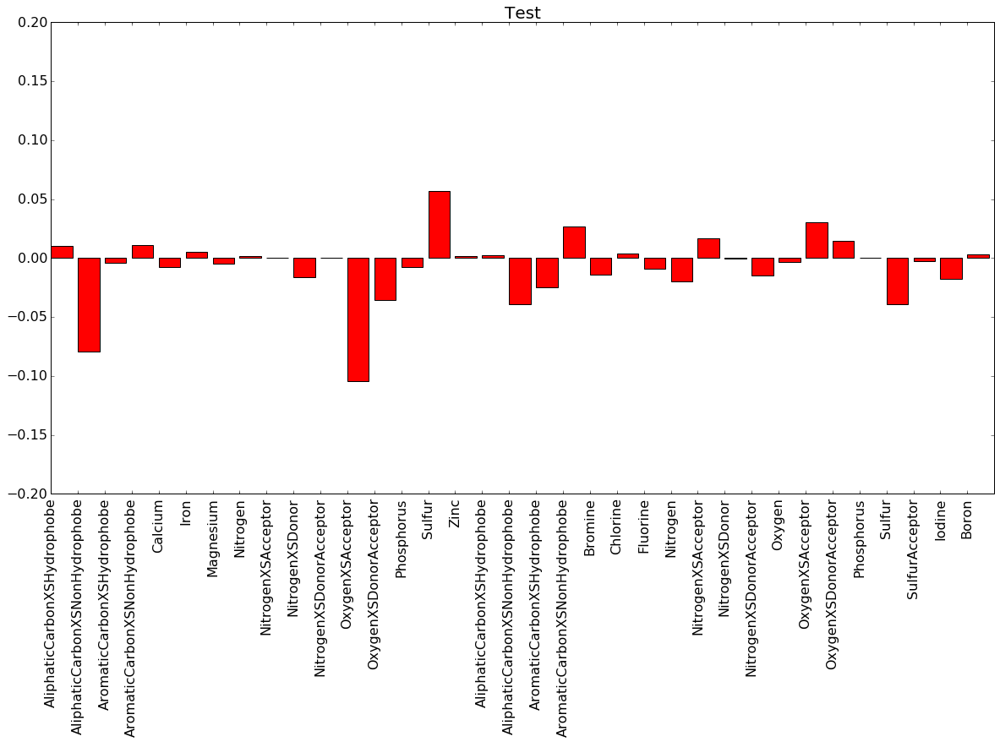

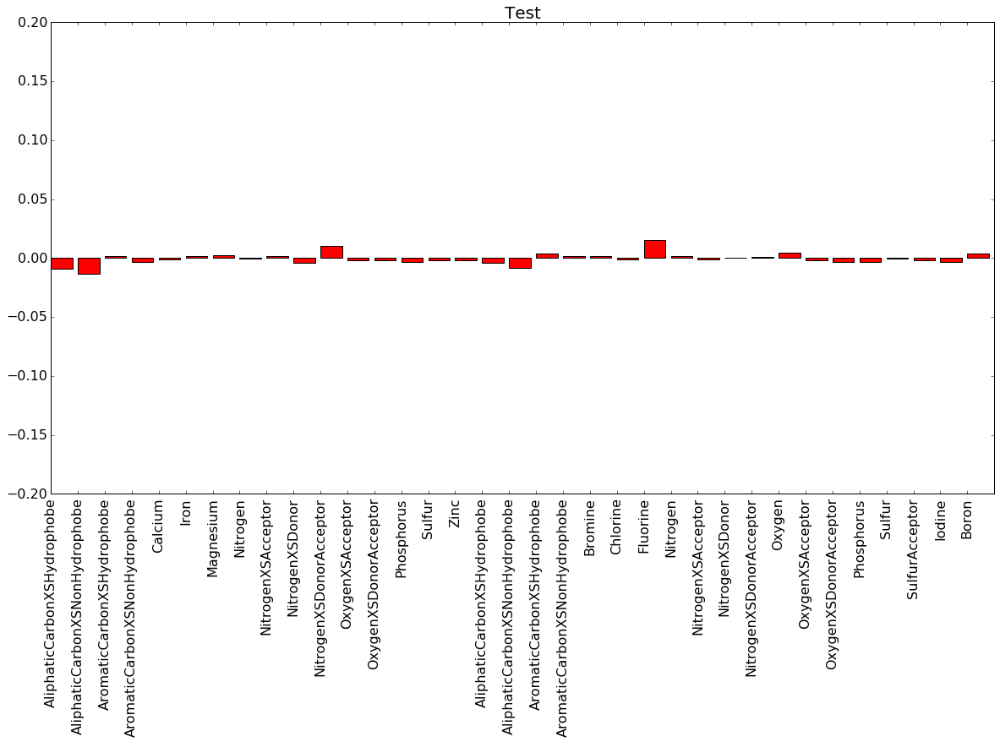

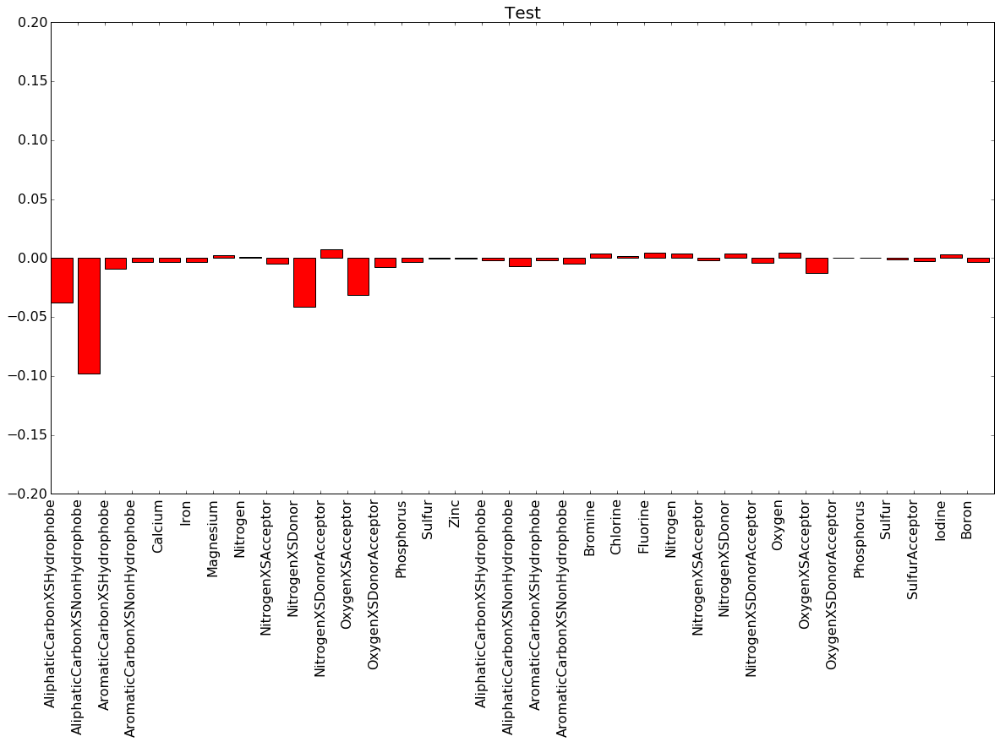

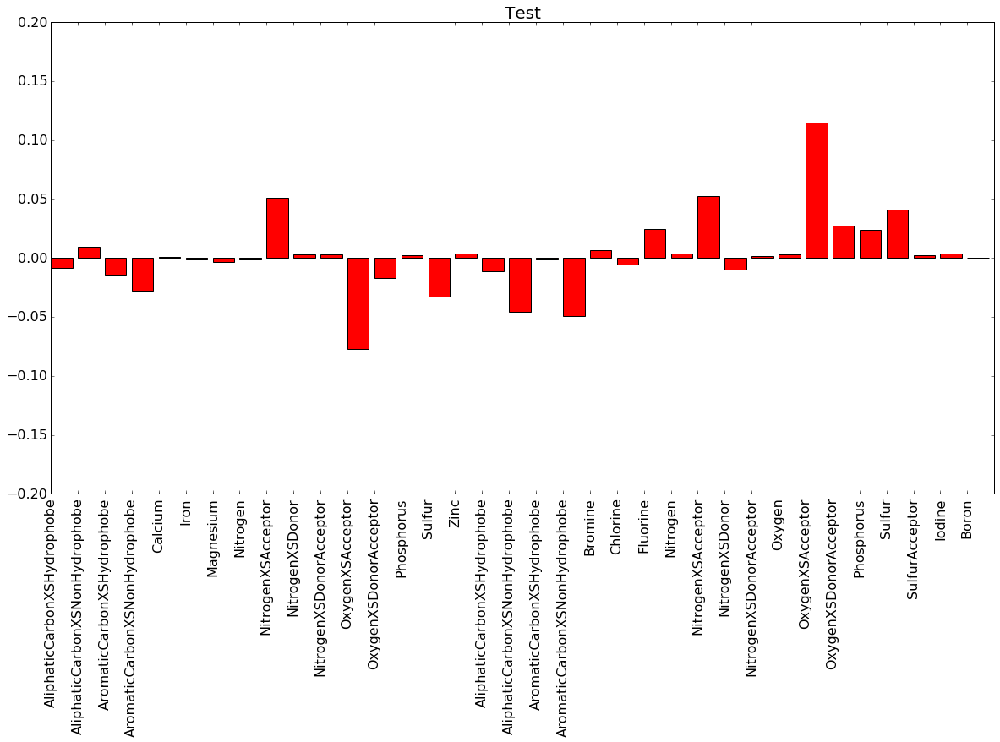

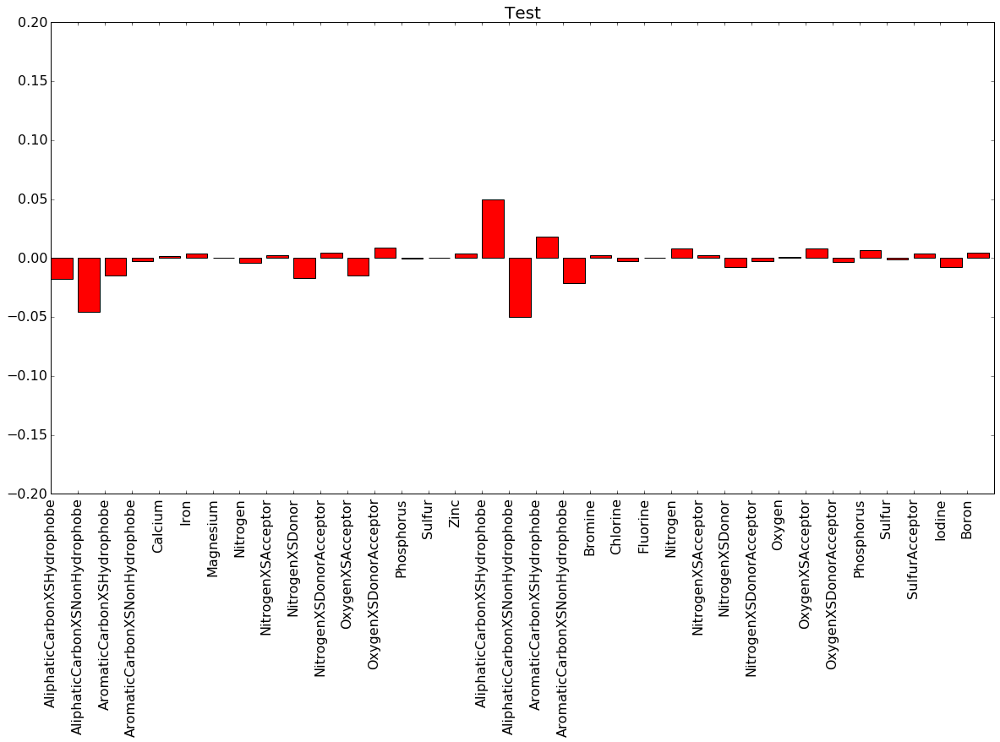

In [4]:
for i,means in enumerate(all_weights):
    make_plot(elements,means,(-.2,.2))

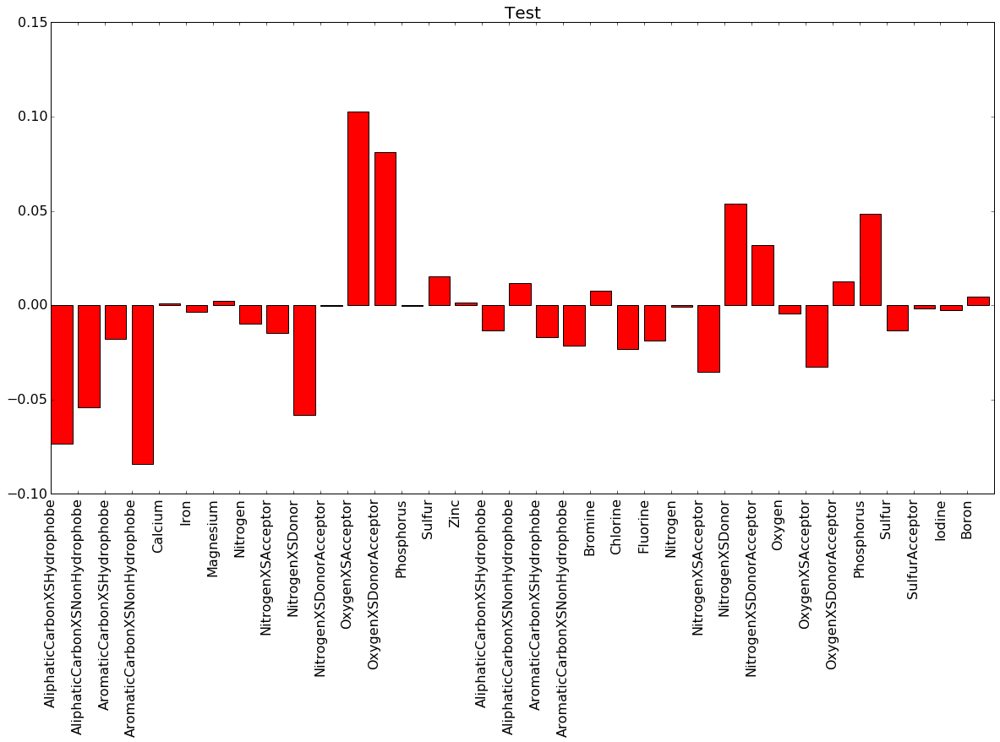

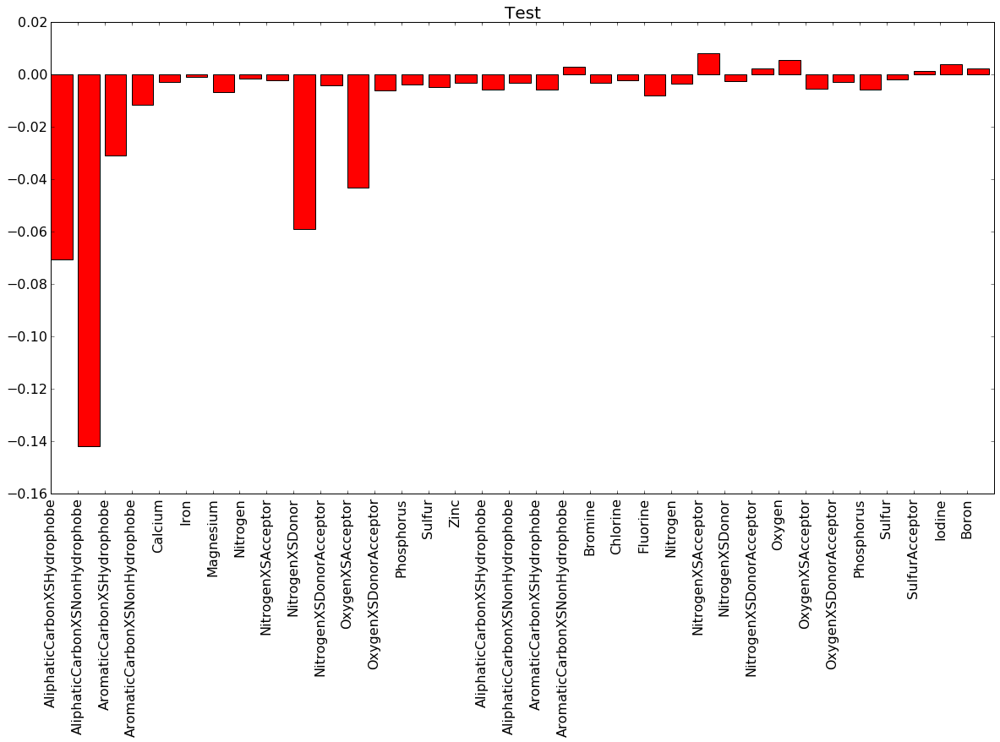

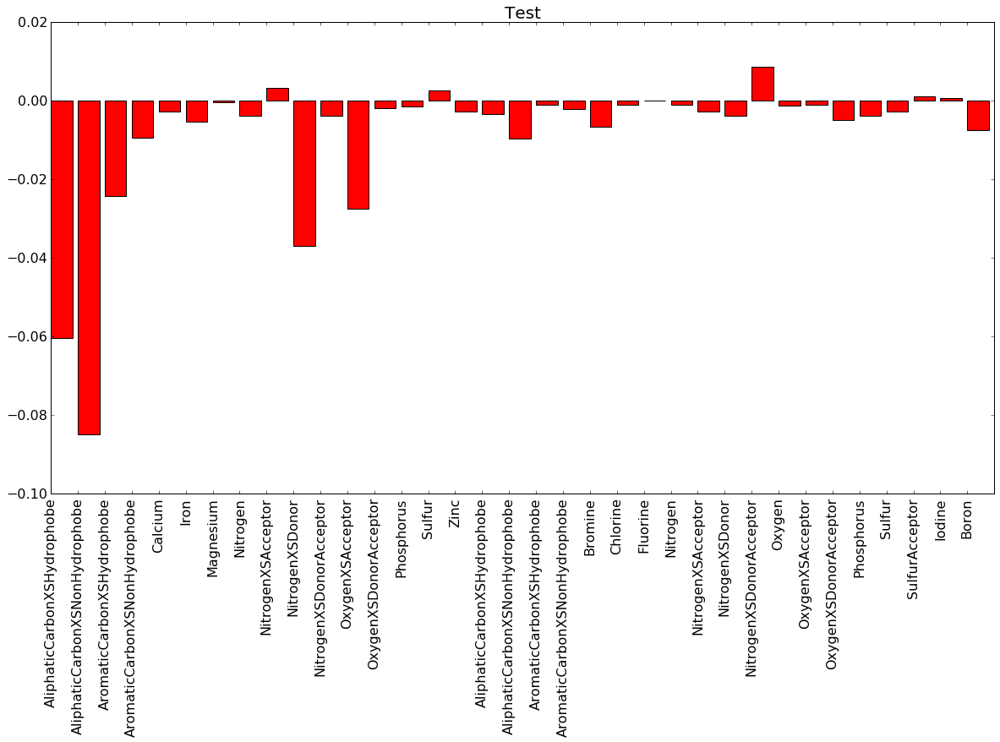

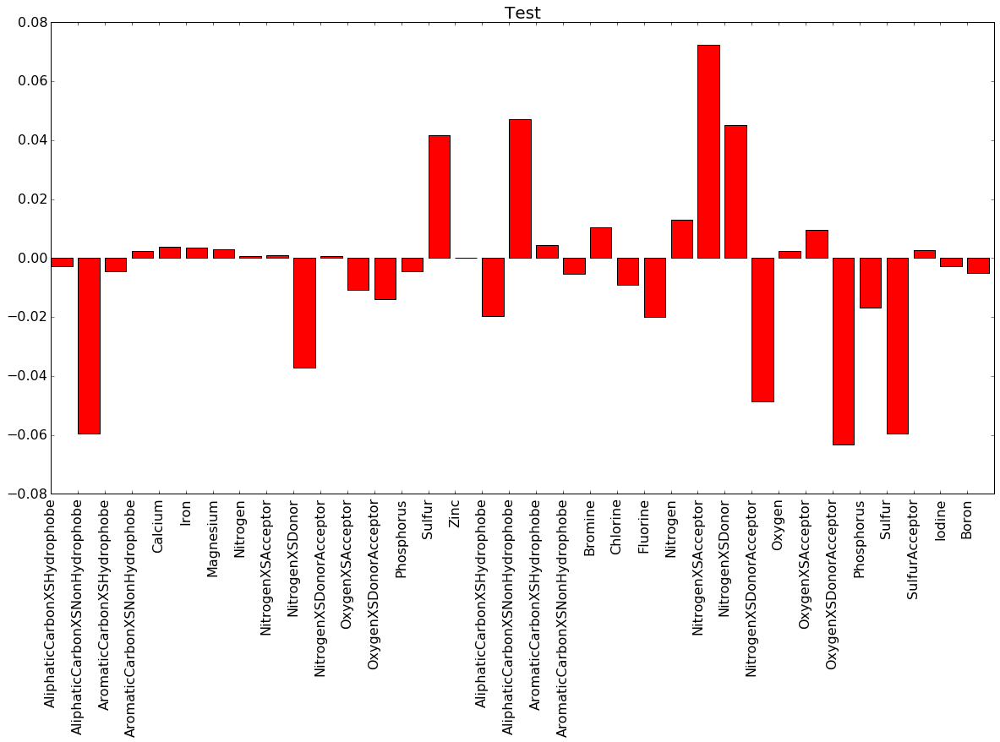

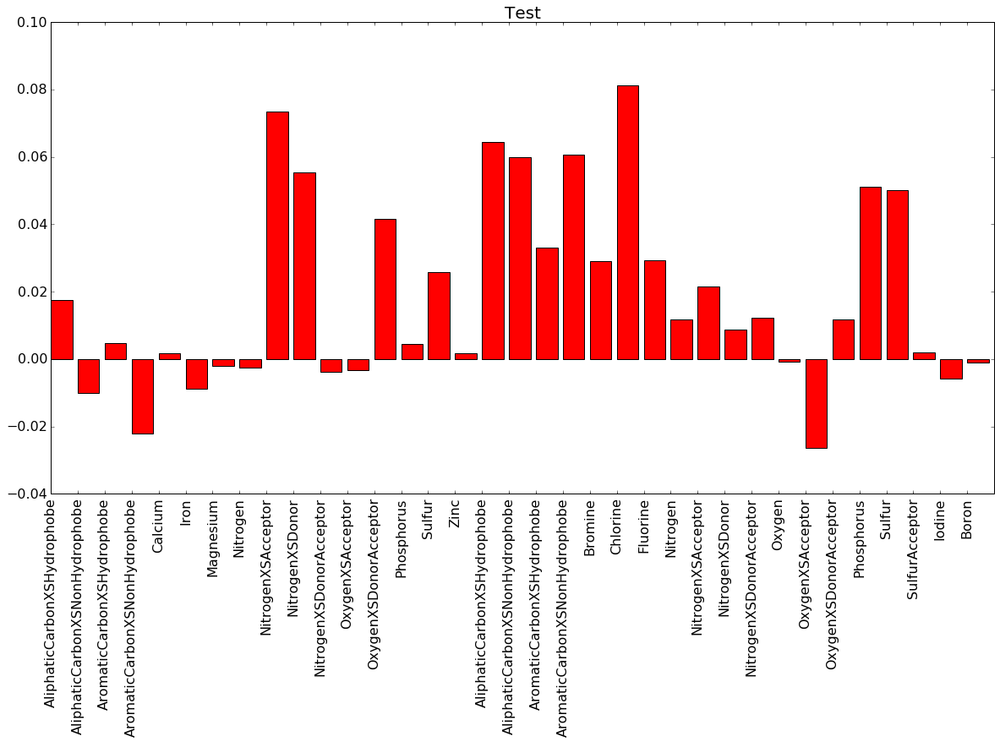

...

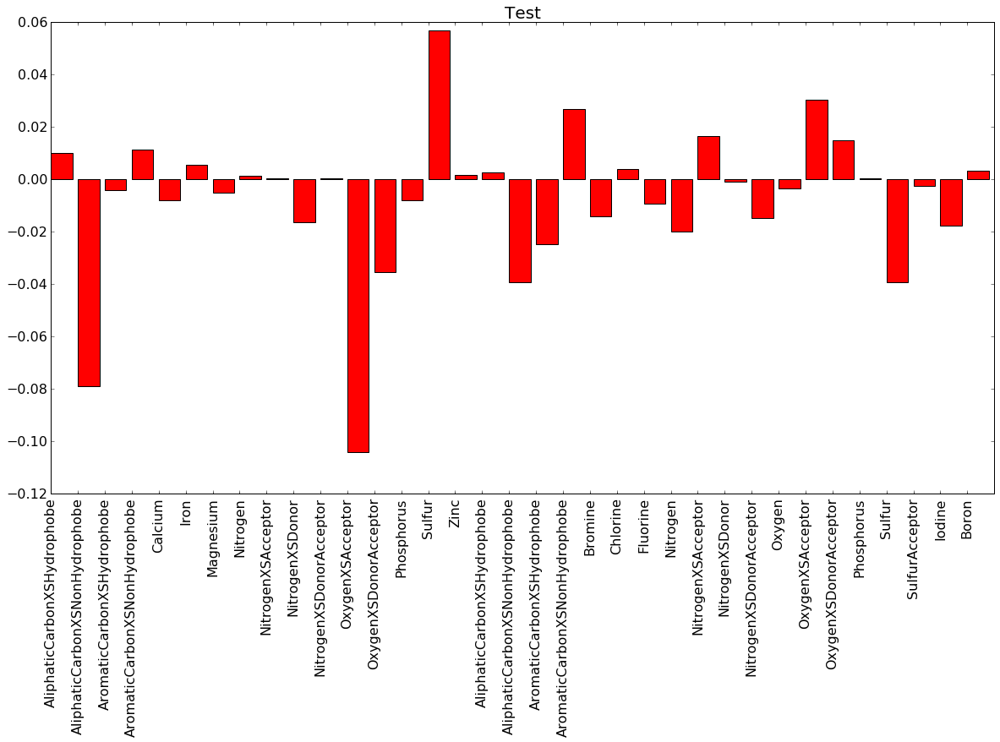

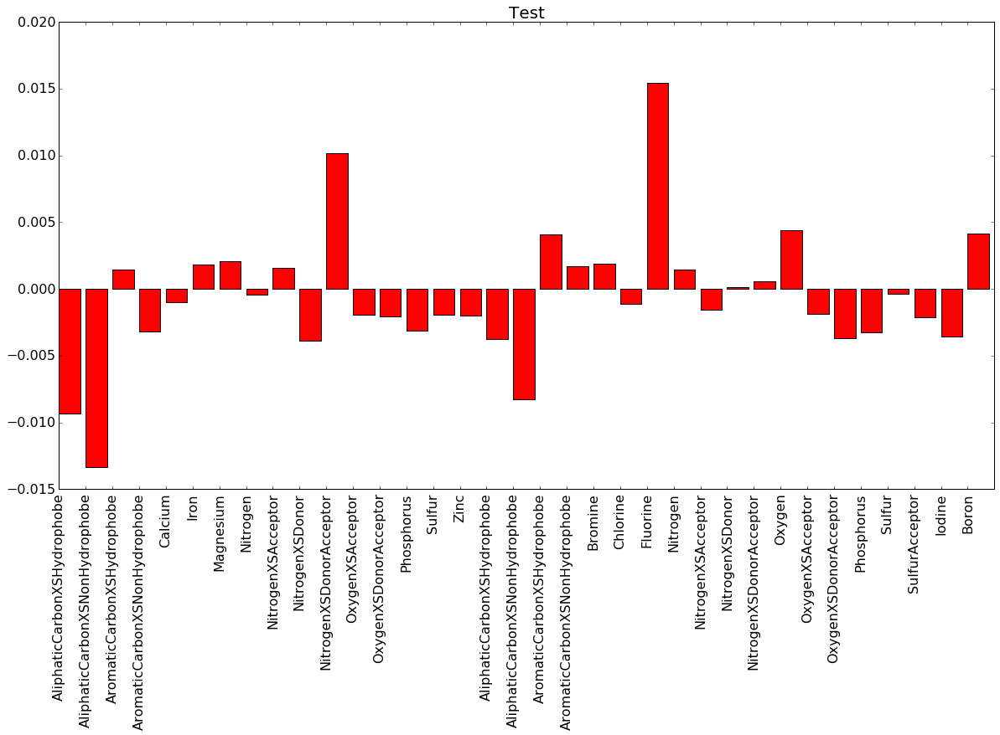

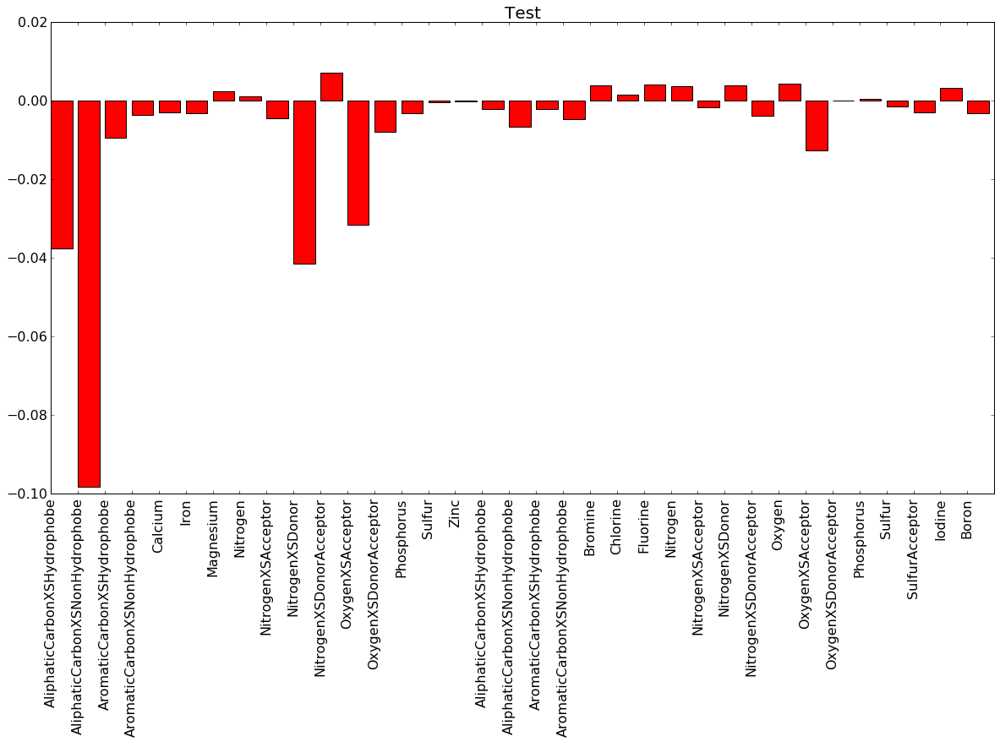

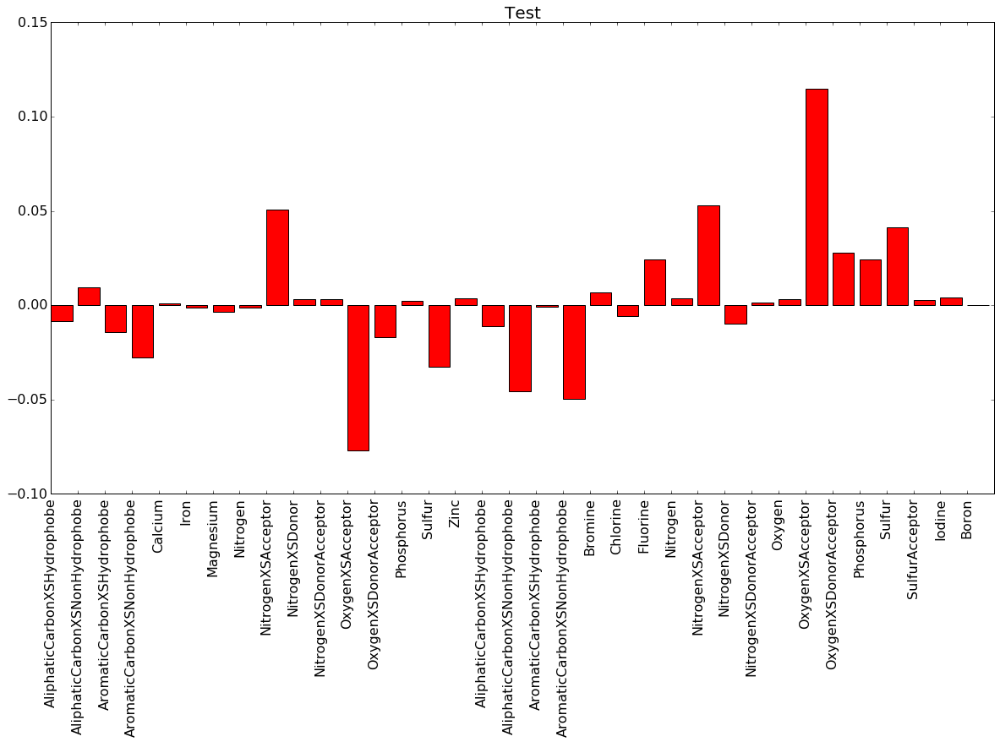

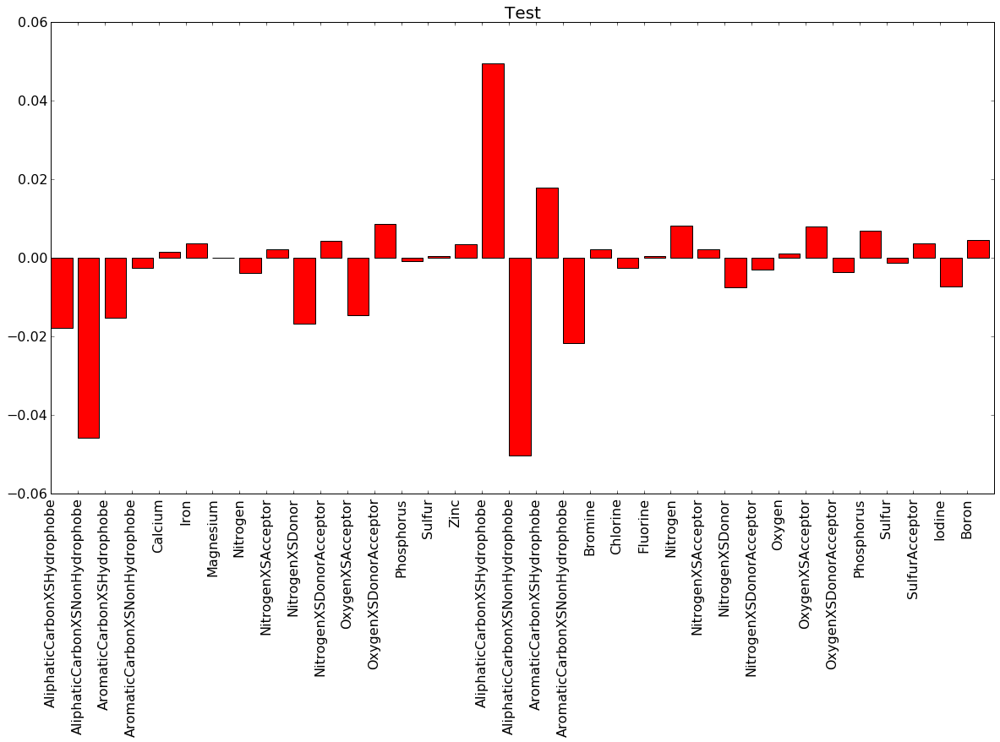

In [5]:
for i,means in enumerate(all_weights):
    make_plot(elements,means)

In [6]:
elem_means =[]

for i in range(len(all_weights)):
    for j in range(len(all_weights[i])):
        if(i == 0):
            elem_means.append(0)
        elem_means[j]+=abs(all_weights[i][j])



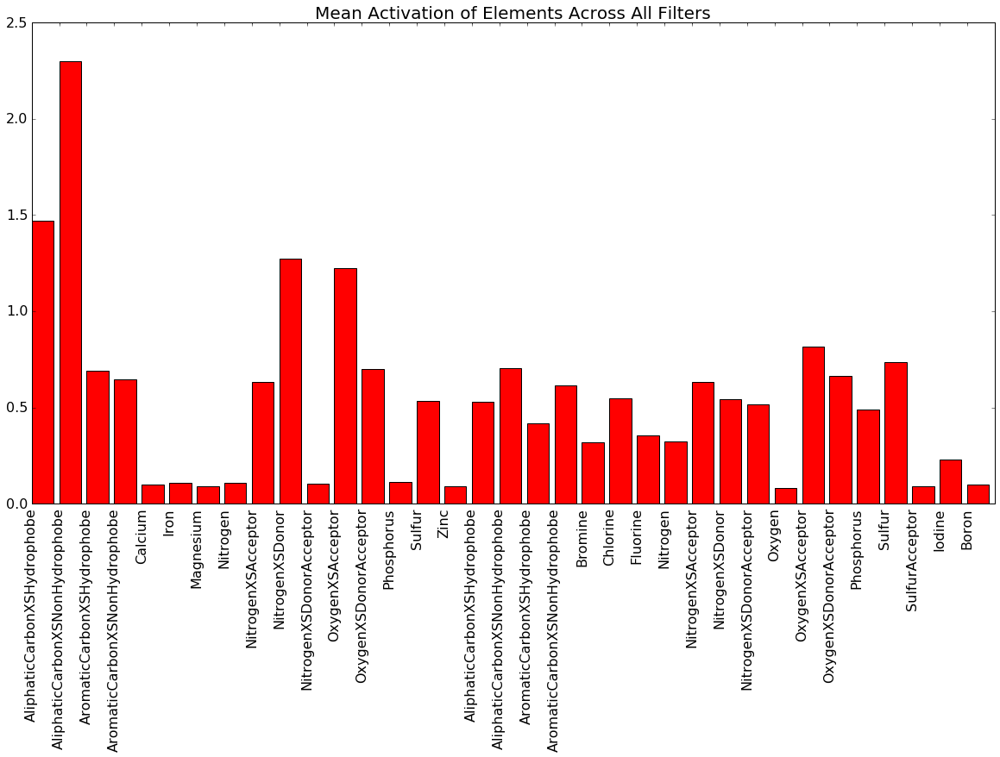

In [7]:
make_plot(elements,elem_means,title="Mean Activation of Elements Across All Filters")

(32, 35, 3, 3, 3)
Filter 0 element AliphaticCarbonXSHydrophobe


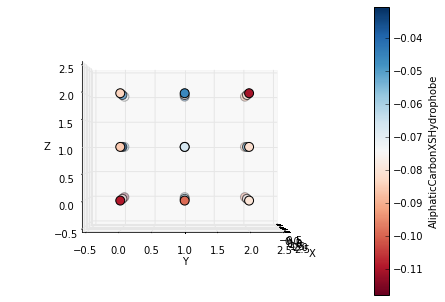

Filter 0 element AliphaticCarbonXSNonHydrophobe


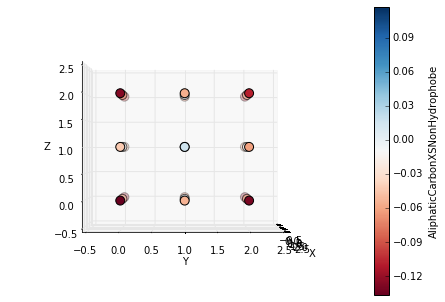

Filter 0 element AromaticCarbonXSHydrophobe


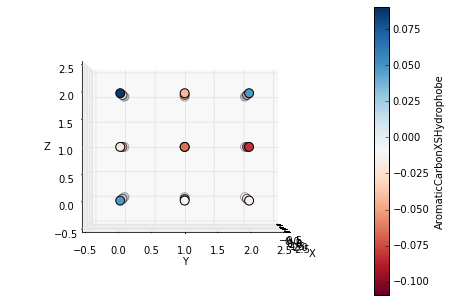

Filter 0 element AromaticCarbonXSNonHydrophobe


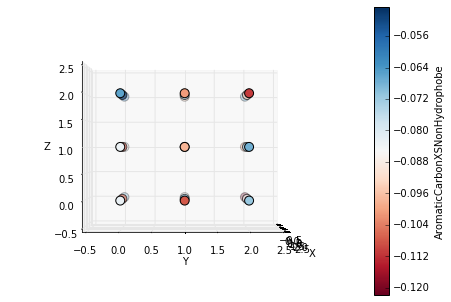

Filter 0 element Calcium


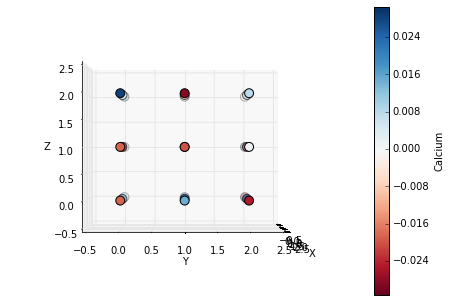

Filter 0 element Iron


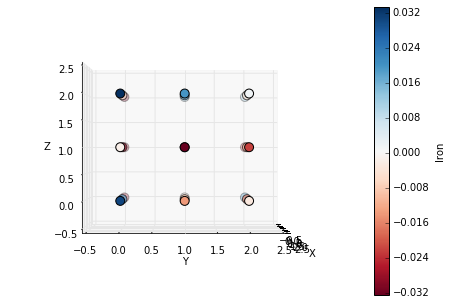

Filter 0 element Magnesium


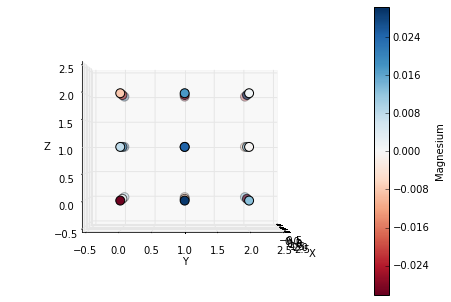

Filter 0 element Nitrogen


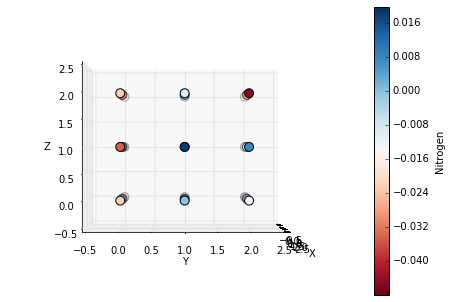

Filter 0 element NitrogenXSAcceptor


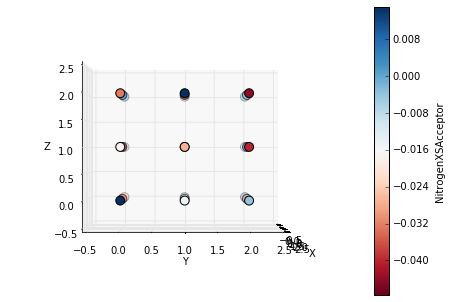

Filter 0 element NitrogenXSDonor


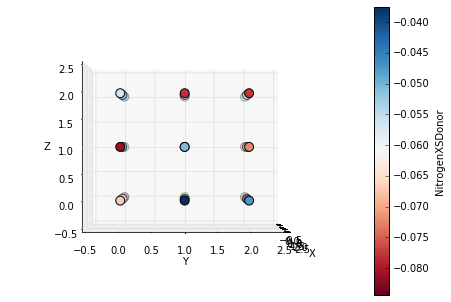

Filter 0 element NitrogenXSDonorAcceptor


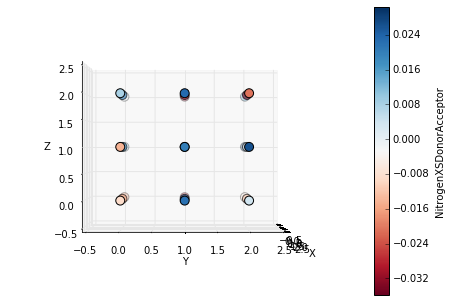

Filter 0 element OxygenXSAcceptor


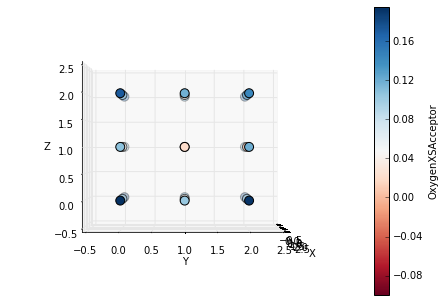

Filter 0 element OxygenXSDonorAcceptor


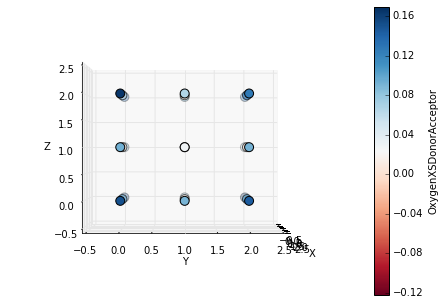

Filter 0 element Phosphorus


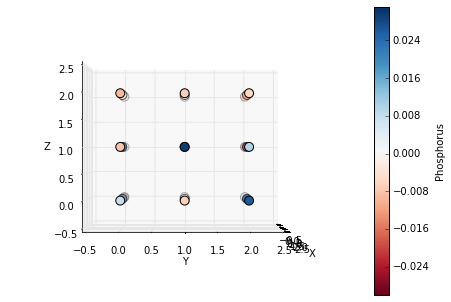

Filter 0 element Sulfur


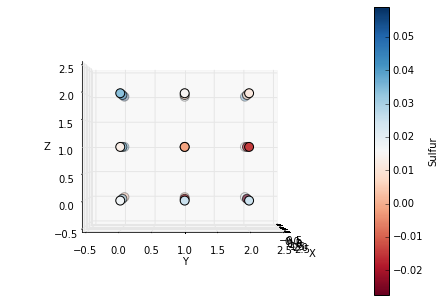

Filter 0 element Zinc


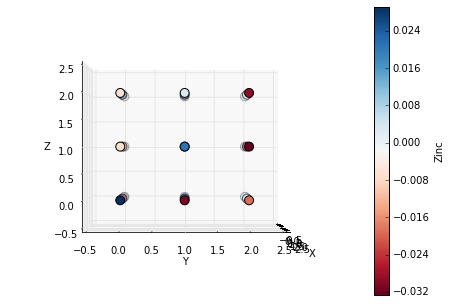

Filter 0 element AliphaticCarbonXSHydrophobe


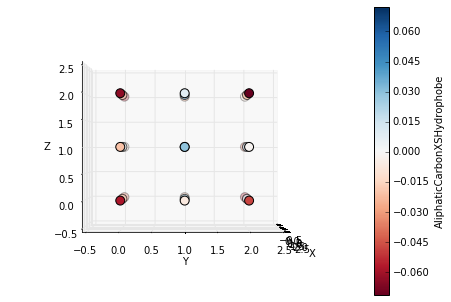

Filter 0 element AliphaticCarbonXSNonHydrophobe


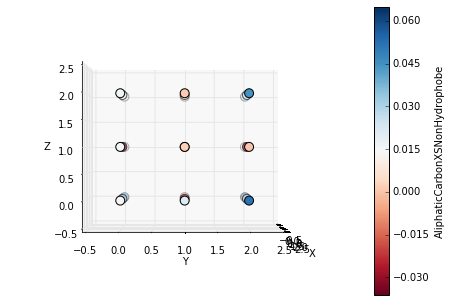

Filter 0 element AromaticCarbonXSHydrophobe


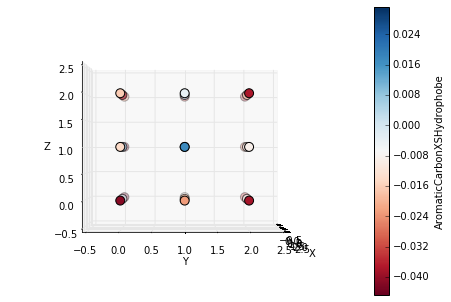

Filter 0 element AromaticCarbonXSNonHydrophobe


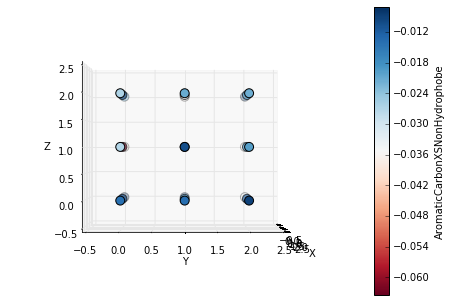

Filter 0 element Bromine


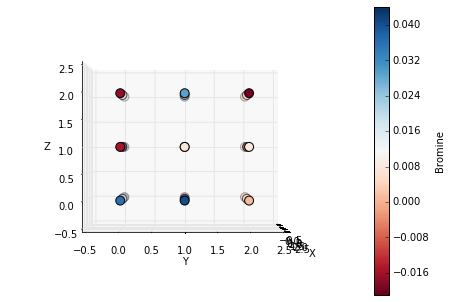

Filter 0 element Chlorine


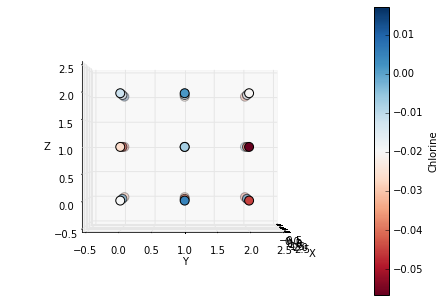

Filter 0 element Fluorine


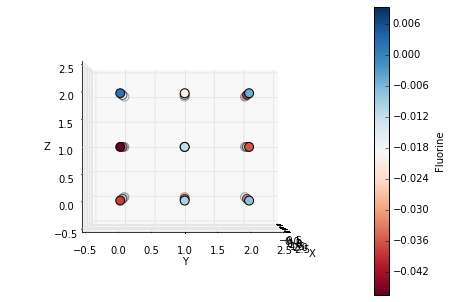

Filter 0 element Nitrogen


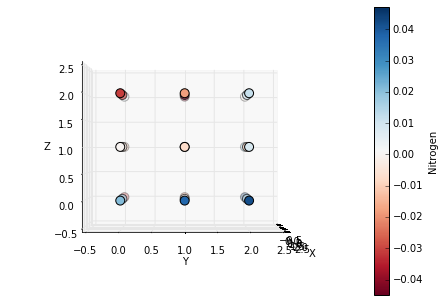

Filter 0 element NitrogenXSAcceptor


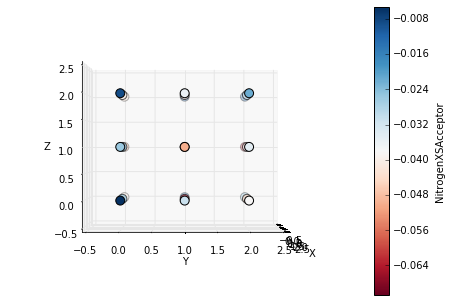

Filter 0 element NitrogenXSDonor


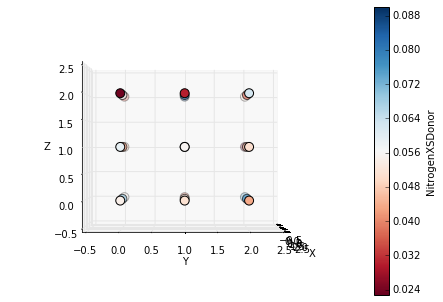

Filter 0 element NitrogenXSDonorAcceptor


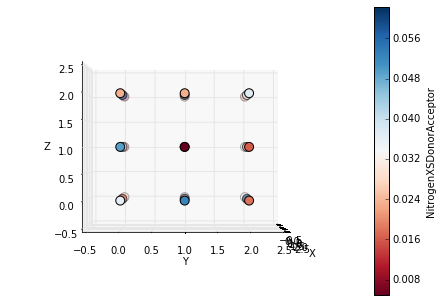

Filter 0 element Oxygen


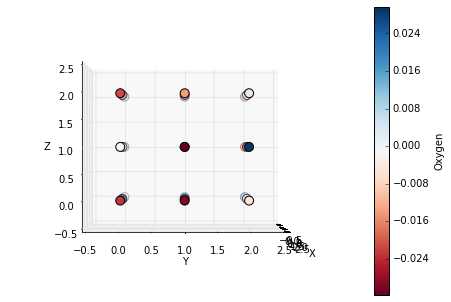

Filter 0 element OxygenXSAcceptor


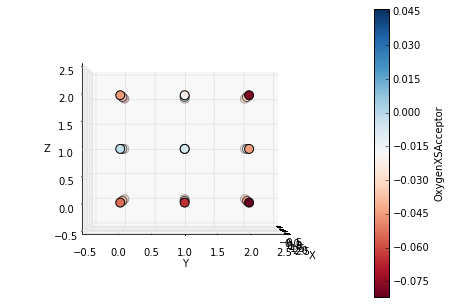

Filter 0 element OxygenXSDonorAcceptor


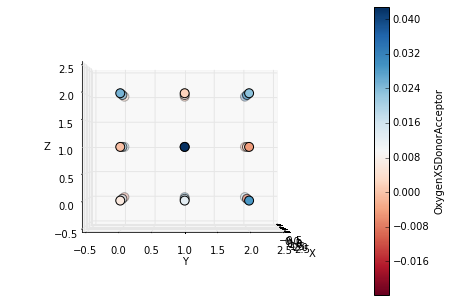

Filter 0 element Phosphorus


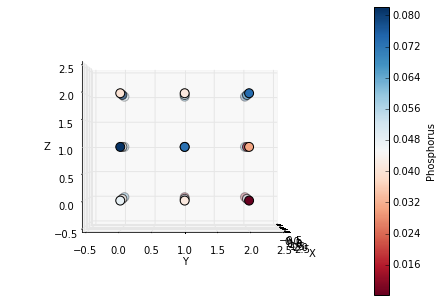

Filter 0 element Sulfur


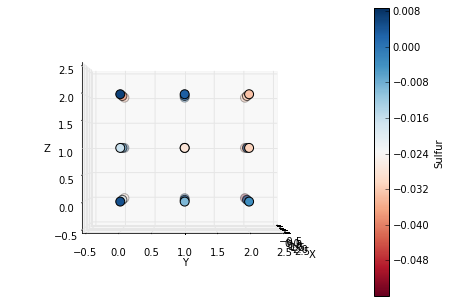

Filter 0 element SulfurAcceptor


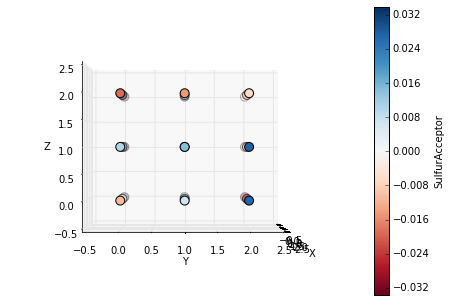

Filter 0 element Iodine


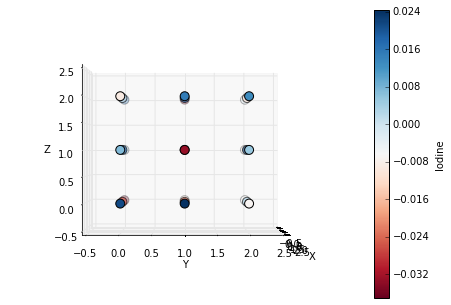

Filter 0 element Boron


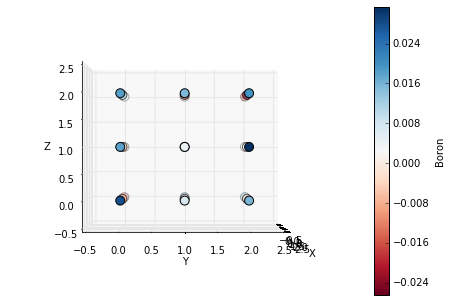

Filter 1 element AliphaticCarbonXSHydrophobe


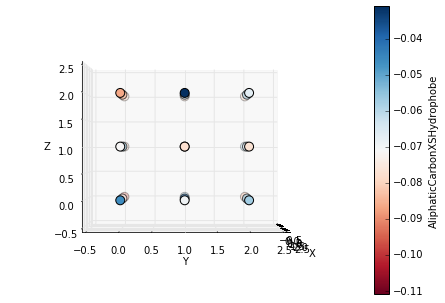

Filter 1 element AliphaticCarbonXSNonHydrophobe


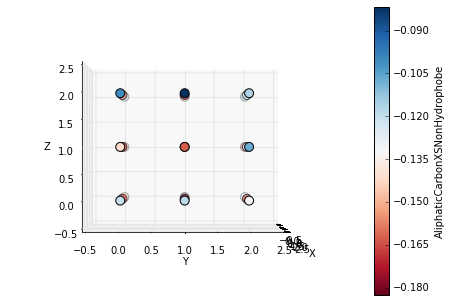

Filter 1 element AromaticCarbonXSHydrophobe


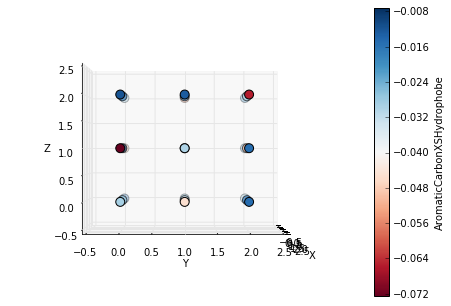

Filter 1 element AromaticCarbonXSNonHydrophobe


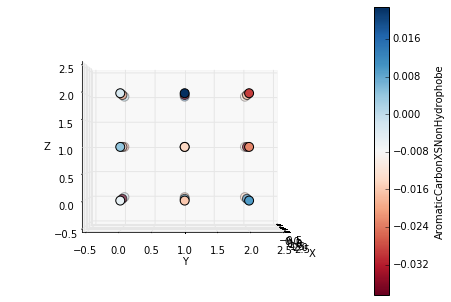

Filter 1 element Calcium


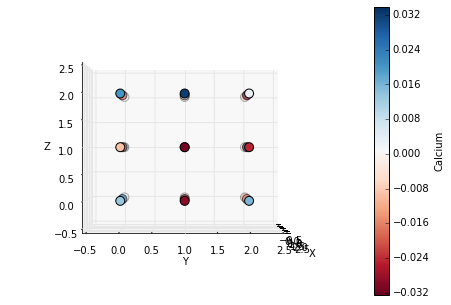

Filter 1 element Iron


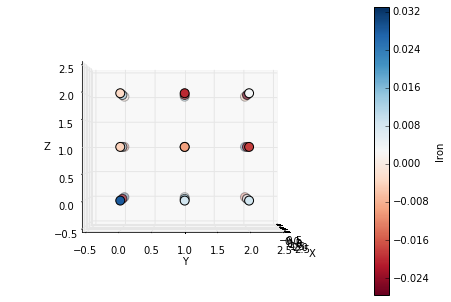

Filter 1 element Magnesium


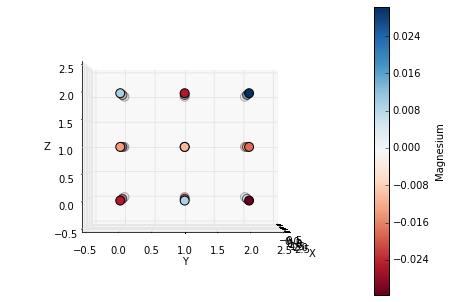

Filter 1 element Nitrogen


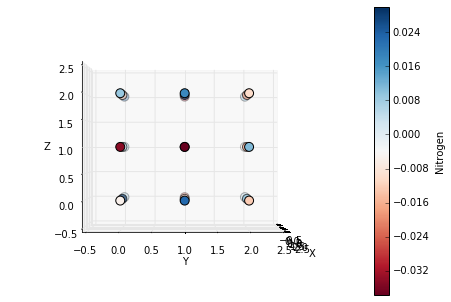

Filter 1 element NitrogenXSAcceptor


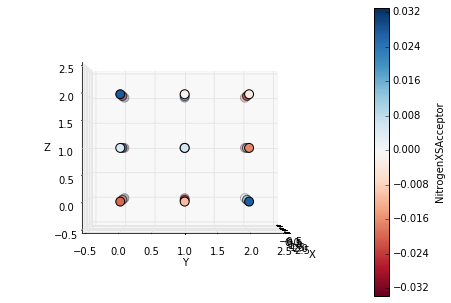

Filter 1 element NitrogenXSDonor


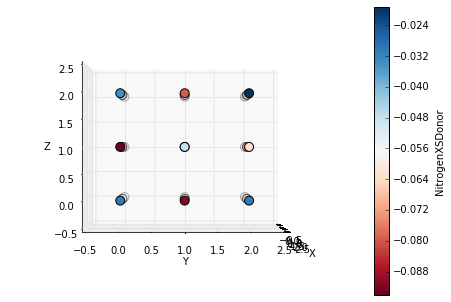

Filter 1 element NitrogenXSDonorAcceptor


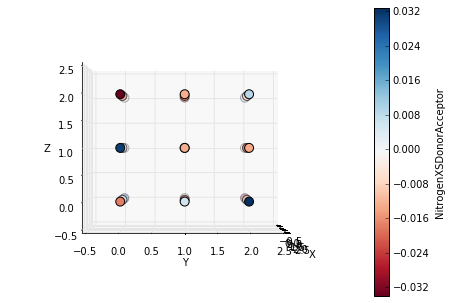

Filter 1 element OxygenXSAcceptor


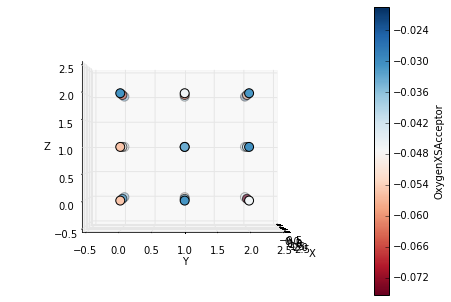

Filter 1 element OxygenXSDonorAcceptor


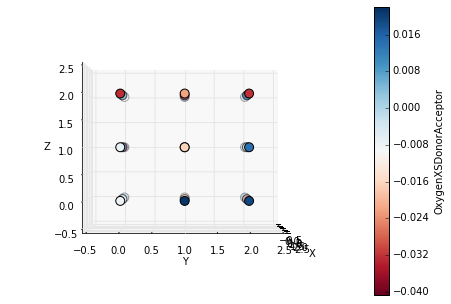

Filter 1 element Phosphorus


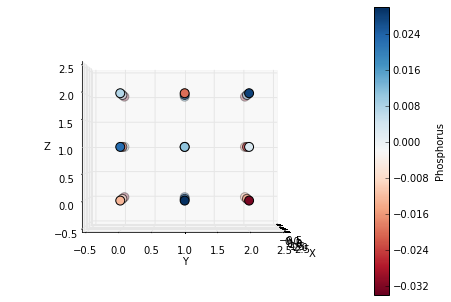

Filter 1 element Sulfur


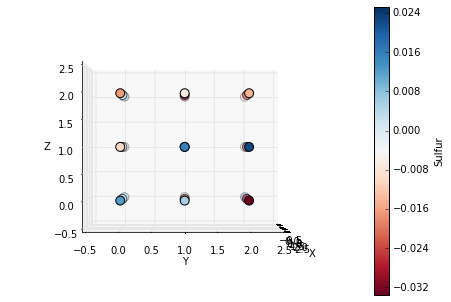

Filter 1 element Zinc


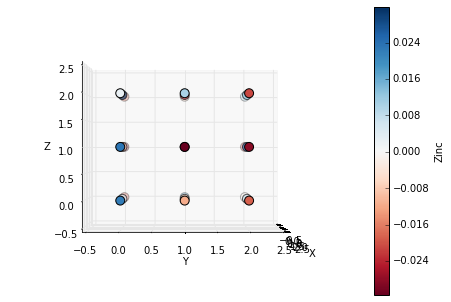

Filter 1 element AliphaticCarbonXSHydrophobe


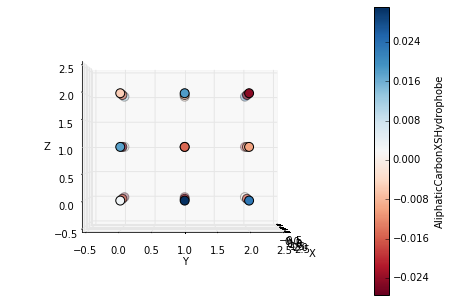

Filter 1 element AliphaticCarbonXSNonHydrophobe


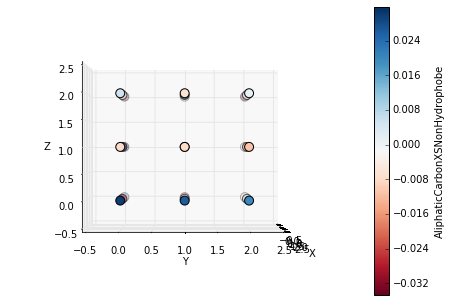

Filter 1 element AromaticCarbonXSHydrophobe


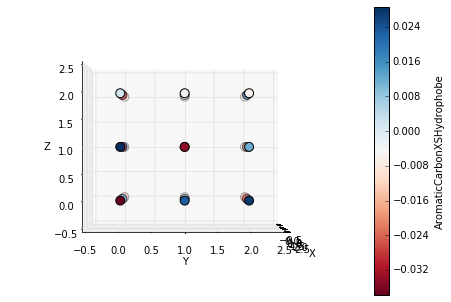

Filter 1 element AromaticCarbonXSNonHydrophobe


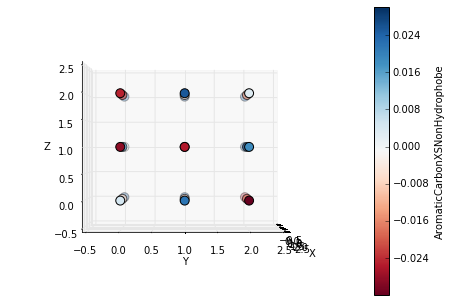

Filter 1 element Bromine


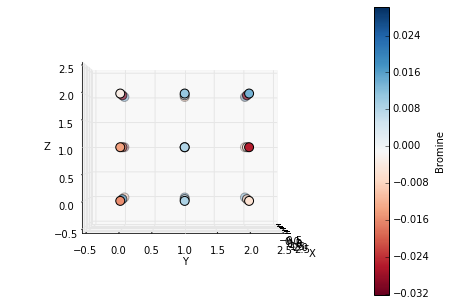

Filter 1 element Chlorine


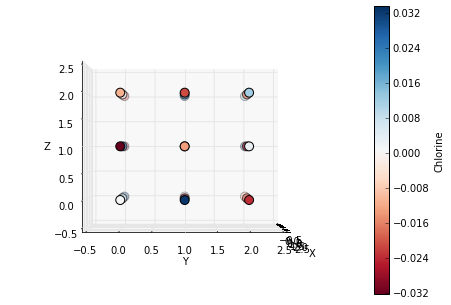

Filter 1 element Fluorine


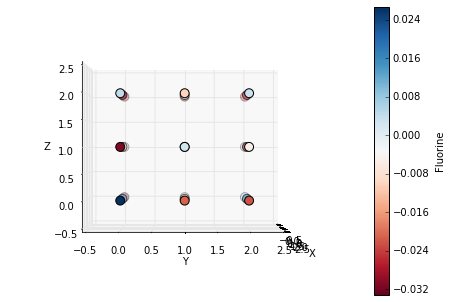

Filter 1 element Nitrogen


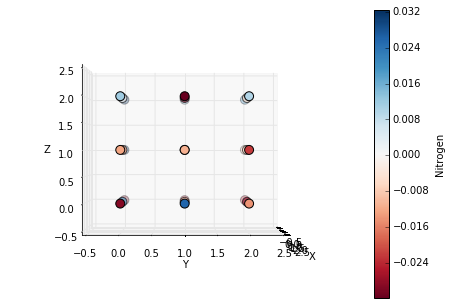

Filter 1 element NitrogenXSAcceptor


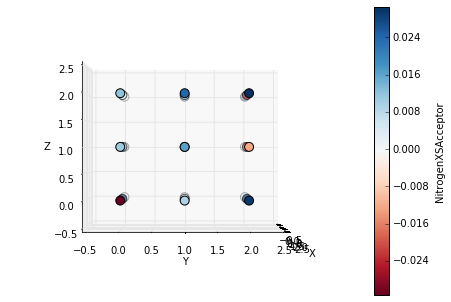

Filter 1 element NitrogenXSDonor


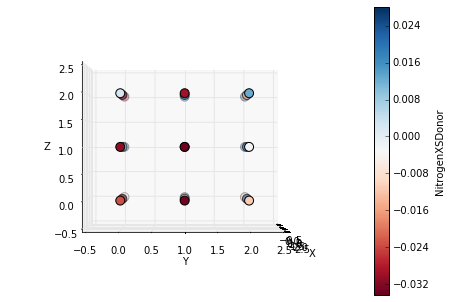

Filter 1 element NitrogenXSDonorAcceptor


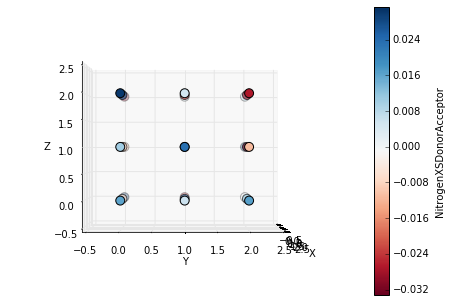

Filter 1 element Oxygen


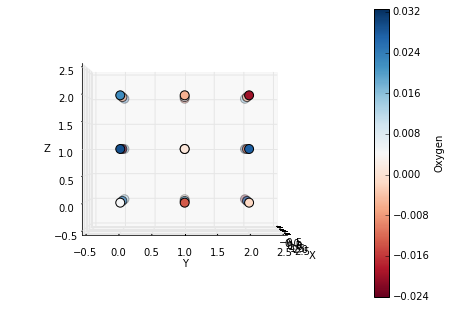

Filter 1 element OxygenXSAcceptor


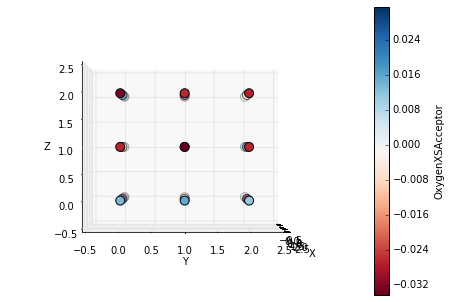

Filter 1 element OxygenXSDonorAcceptor


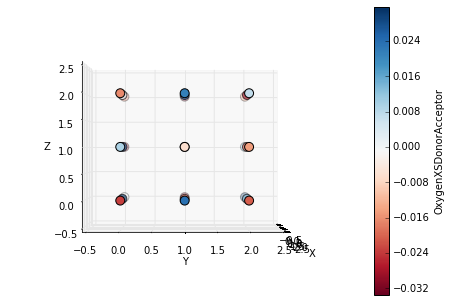

Filter 1 element Phosphorus


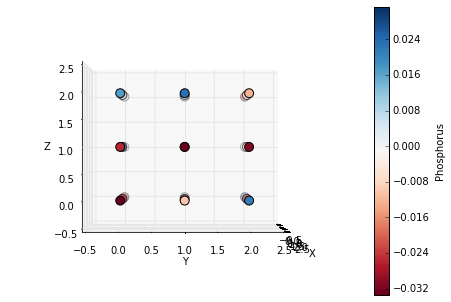

Filter 1 element Sulfur


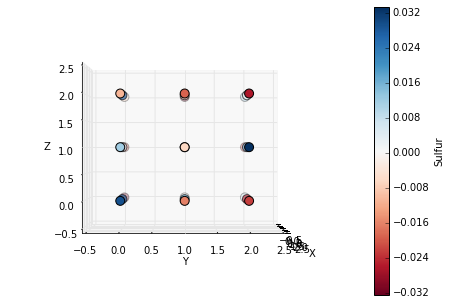

Filter 1 element SulfurAcceptor


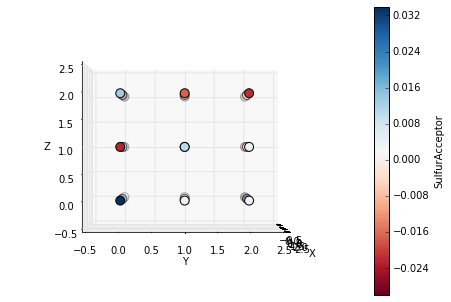

Filter 1 element Iodine


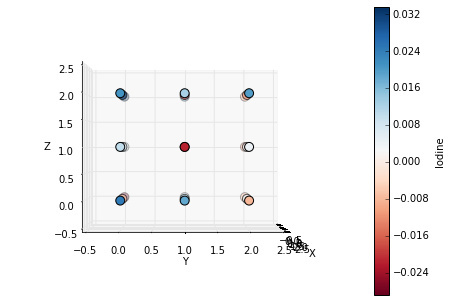

Filter 1 element Boron


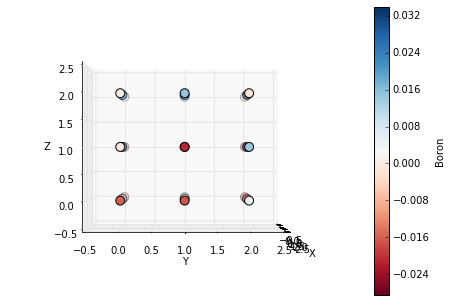

Filter 2 element AliphaticCarbonXSHydrophobe


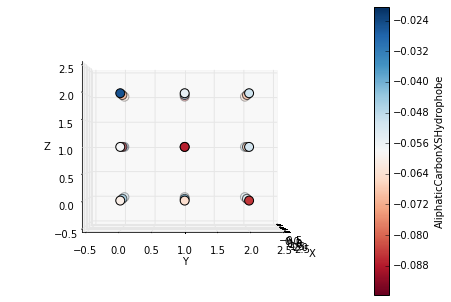

Filter 2 element AliphaticCarbonXSNonHydrophobe


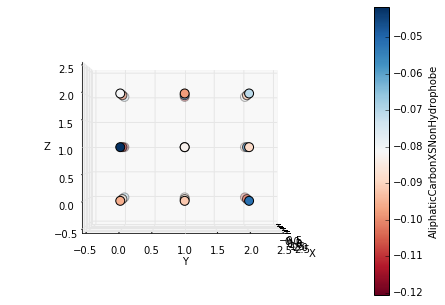

Filter 2 element AromaticCarbonXSHydrophobe


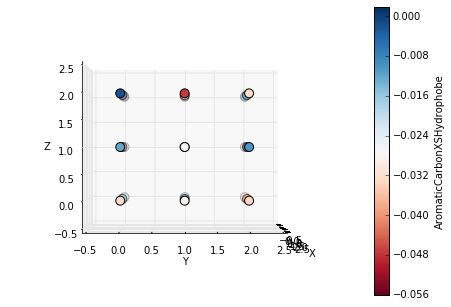

Filter 2 element AromaticCarbonXSNonHydrophobe


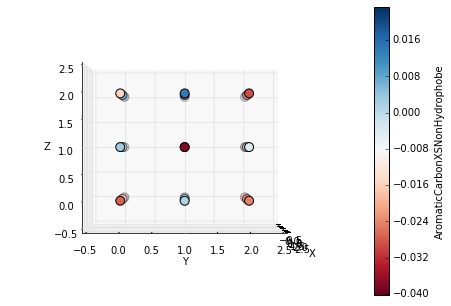

Filter 2 element Calcium


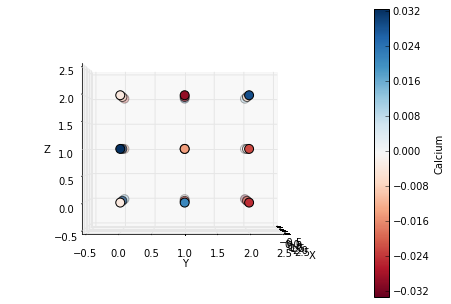

Filter 2 element Iron


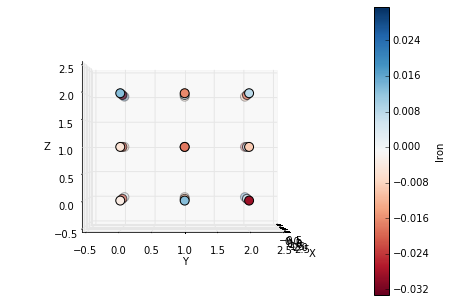

Filter 2 element Magnesium


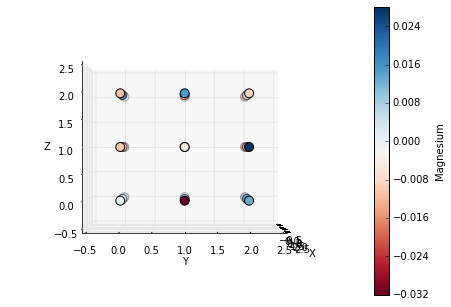

Filter 2 element Nitrogen


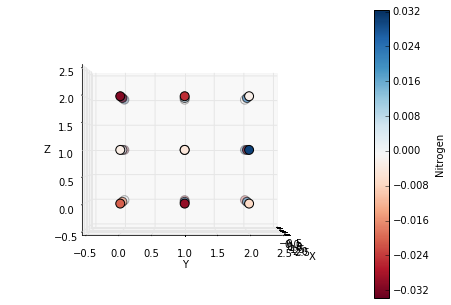

Filter 2 element NitrogenXSAcceptor


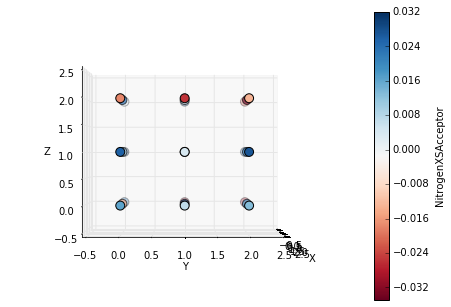

Filter 2 element NitrogenXSDonor


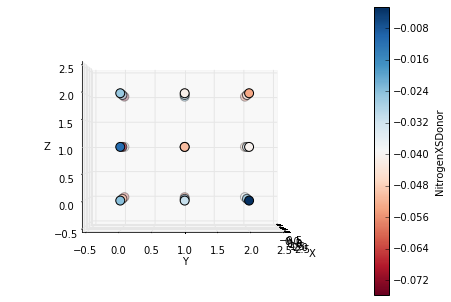

Filter 2 element NitrogenXSDonorAcceptor


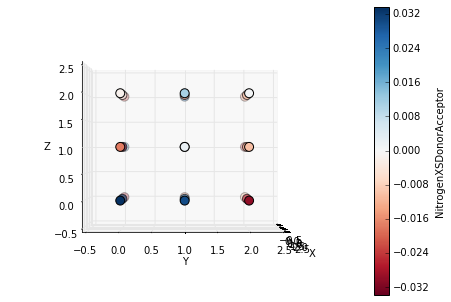

Filter 2 element OxygenXSAcceptor


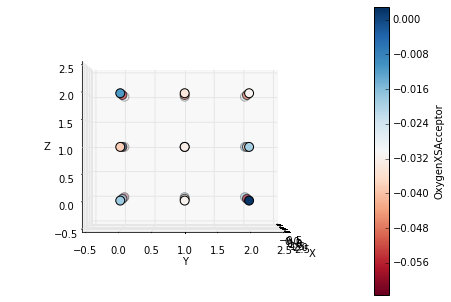

Filter 2 element OxygenXSDonorAcceptor


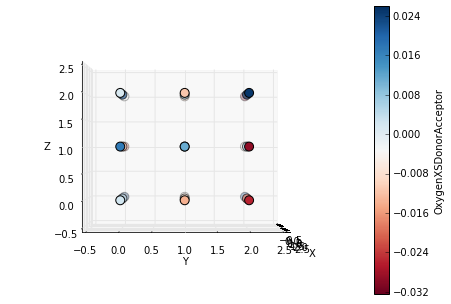

Filter 2 element Phosphorus


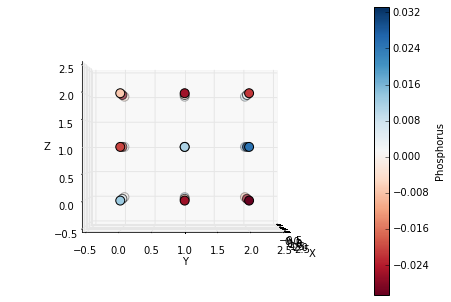

Filter 2 element Sulfur


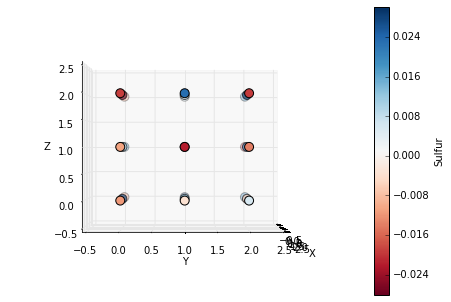

Filter 2 element Zinc


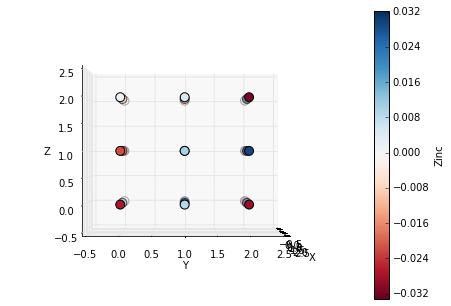

Filter 2 element AliphaticCarbonXSHydrophobe


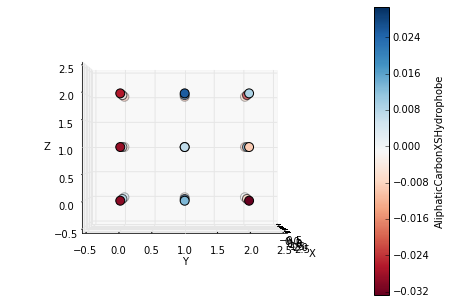

Filter 2 element AliphaticCarbonXSNonHydrophobe


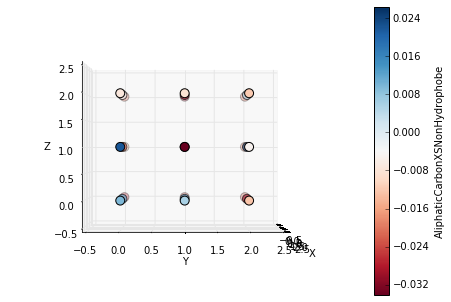

Filter 2 element AromaticCarbonXSHydrophobe


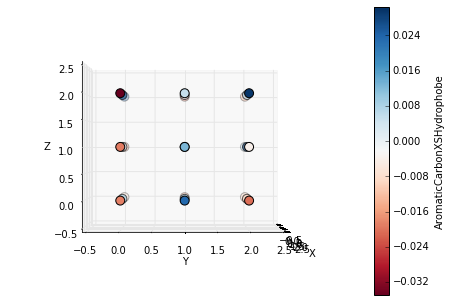

Filter 2 element AromaticCarbonXSNonHydrophobe


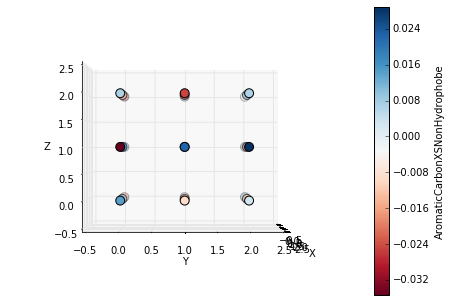

Filter 2 element Bromine


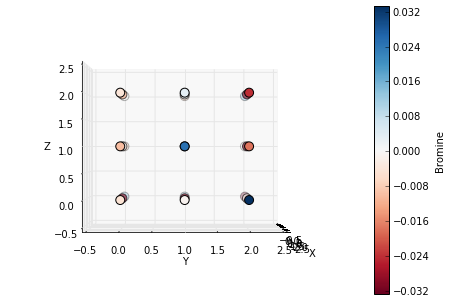

Filter 2 element Chlorine


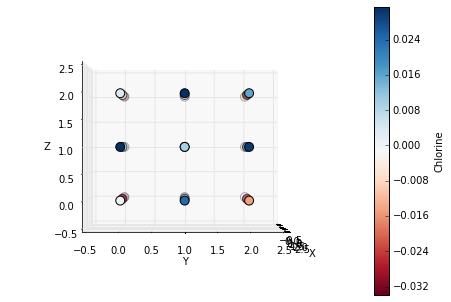

Filter 2 element Fluorine


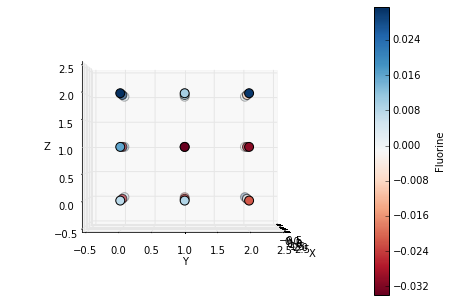

Filter 2 element Nitrogen


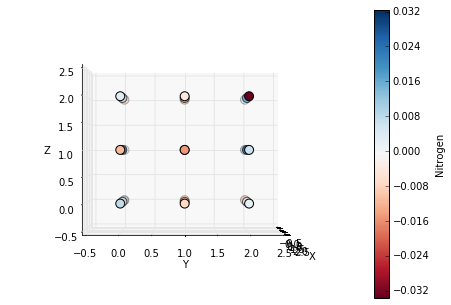

Filter 2 element NitrogenXSAcceptor


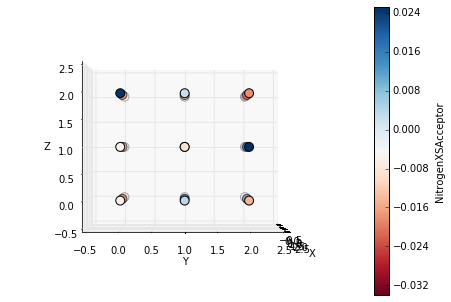

Filter 2 element NitrogenXSDonor


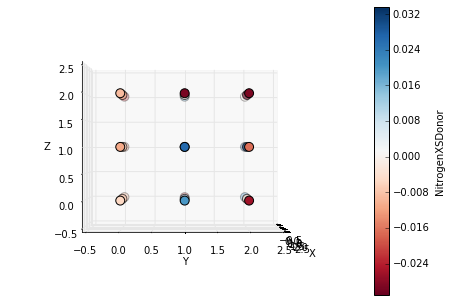

Filter 2 element NitrogenXSDonorAcceptor


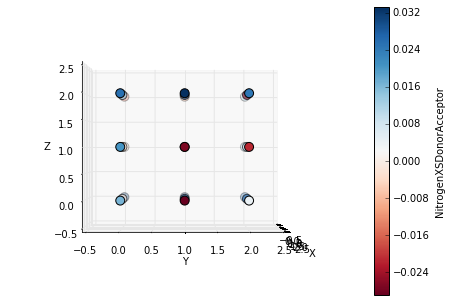

Filter 2 element Oxygen


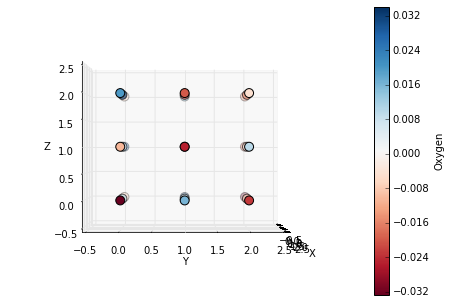

Filter 2 element OxygenXSAcceptor


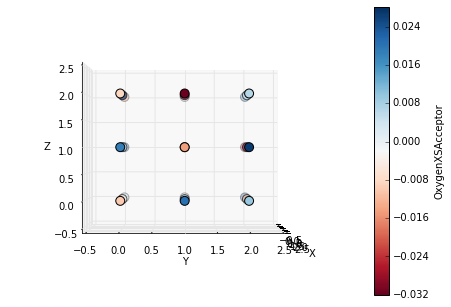

Filter 2 element OxygenXSDonorAcceptor


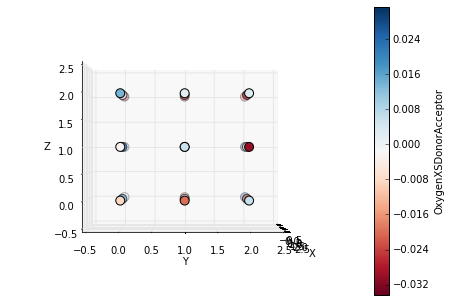

Filter 2 element Phosphorus


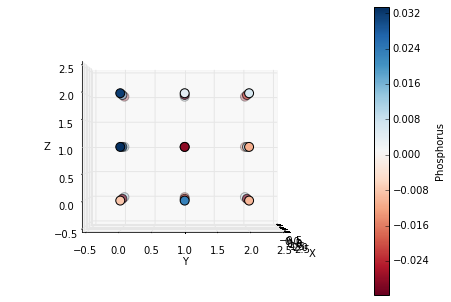

Filter 2 element Sulfur


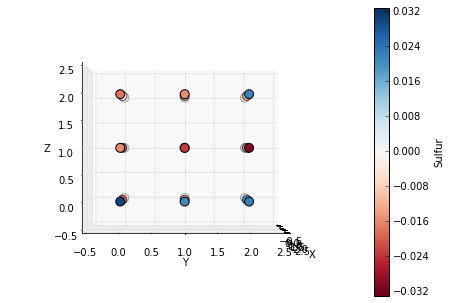

Filter 2 element SulfurAcceptor


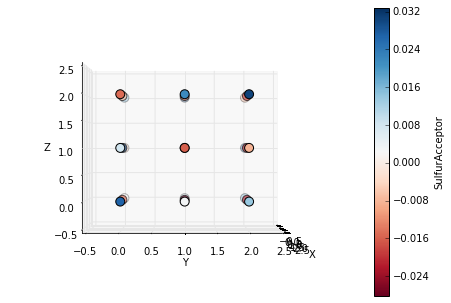

Filter 2 element Iodine


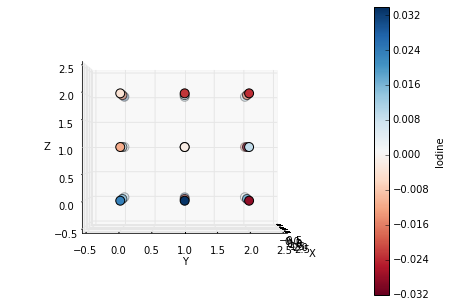

Filter 2 element Boron


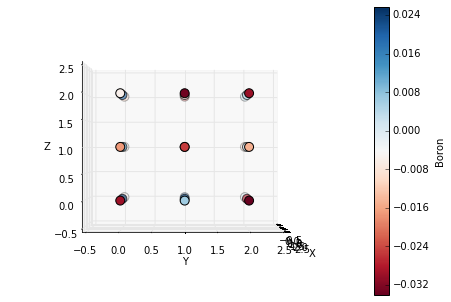

Filter 3 element AliphaticCarbonXSHydrophobe


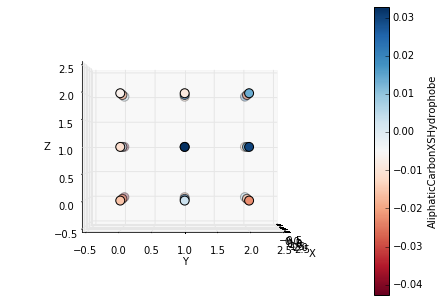

Filter 3 element AliphaticCarbonXSNonHydrophobe


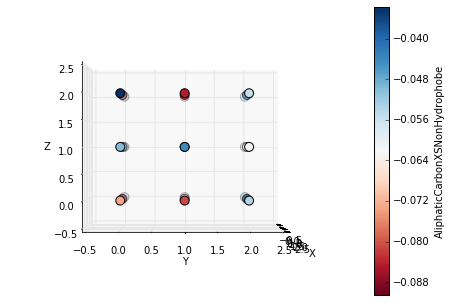

Filter 3 element AromaticCarbonXSHydrophobe


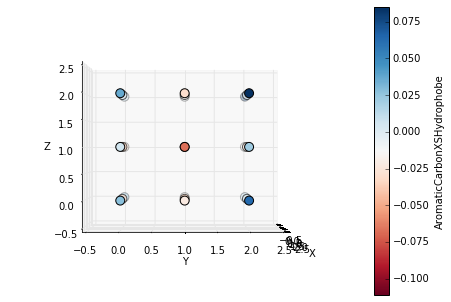

Filter 3 element AromaticCarbonXSNonHydrophobe


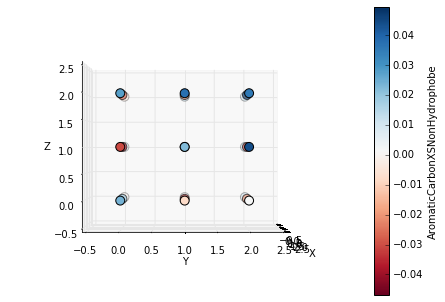

Filter 3 element Calcium


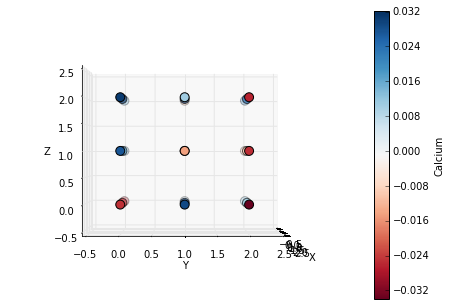

Filter 3 element Iron


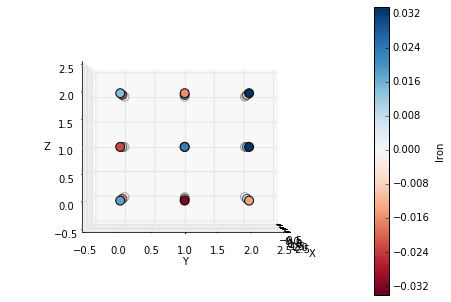

Filter 3 element Magnesium


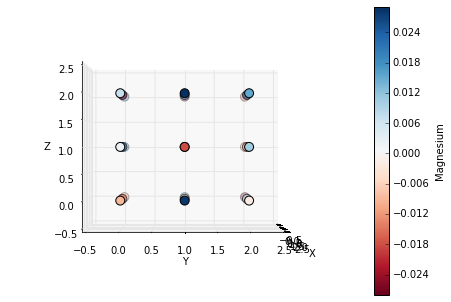

Filter 3 element Nitrogen


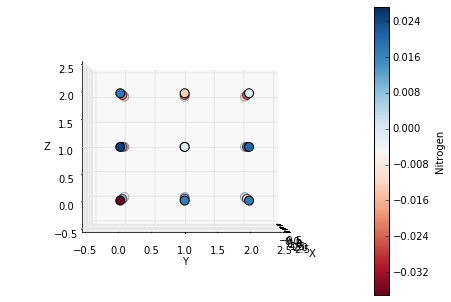

Filter 3 element NitrogenXSAcceptor


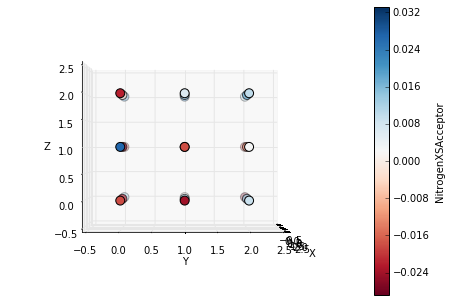

Filter 3 element NitrogenXSDonor


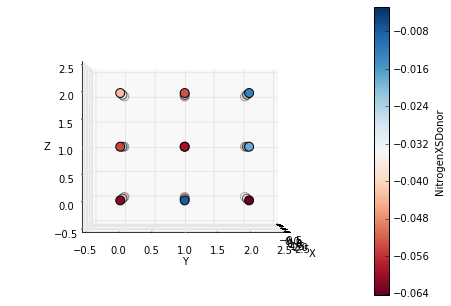

Filter 3 element NitrogenXSDonorAcceptor


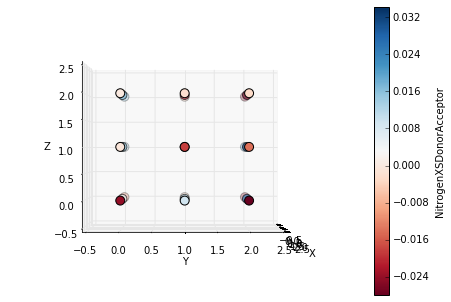

Filter 3 element OxygenXSAcceptor


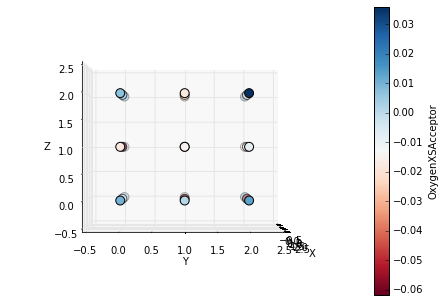

Filter 3 element OxygenXSDonorAcceptor


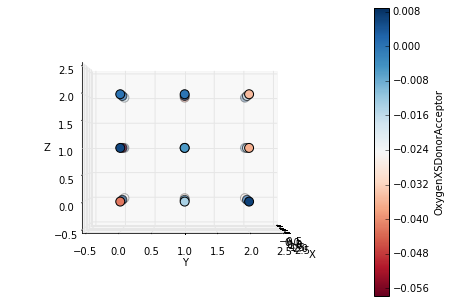

Filter 3 element Phosphorus


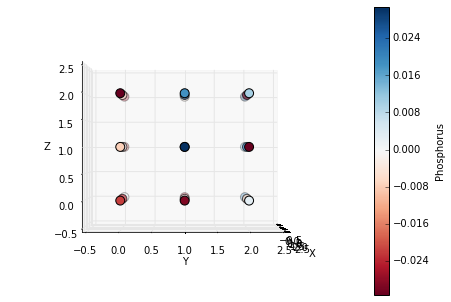

Filter 3 element Sulfur


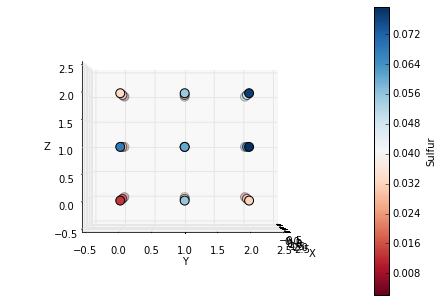

Filter 3 element Zinc


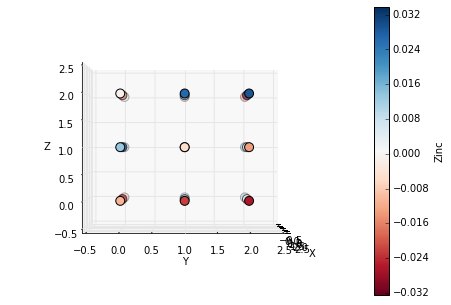

Filter 3 element AliphaticCarbonXSHydrophobe


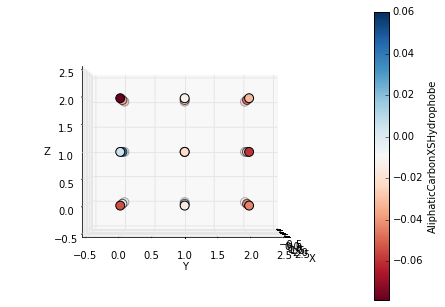

Filter 3 element AliphaticCarbonXSNonHydrophobe


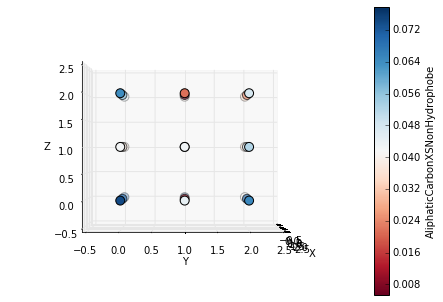

Filter 3 element AromaticCarbonXSHydrophobe


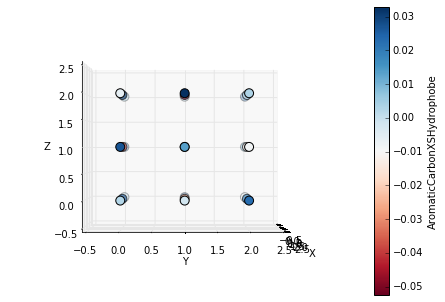

Filter 3 element AromaticCarbonXSNonHydrophobe


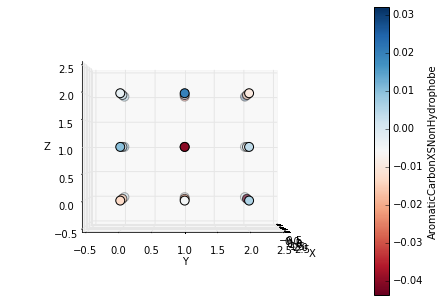

Filter 3 element Bromine


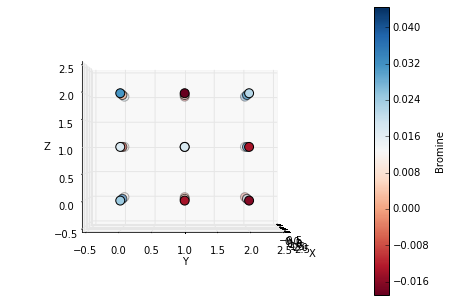

Filter 3 element Chlorine


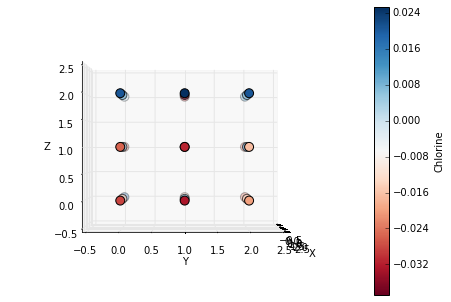

Filter 3 element Fluorine


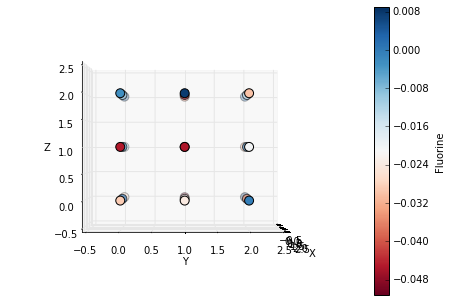

Filter 3 element Nitrogen


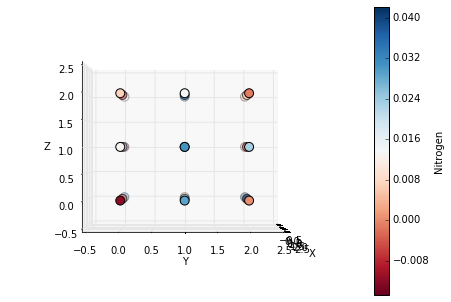

Filter 3 element NitrogenXSAcceptor


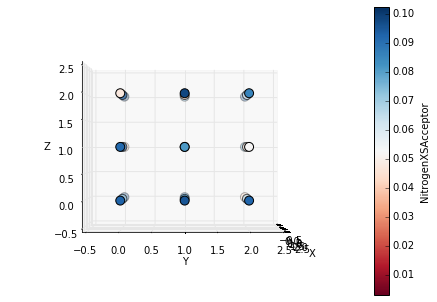

Filter 3 element NitrogenXSDonor


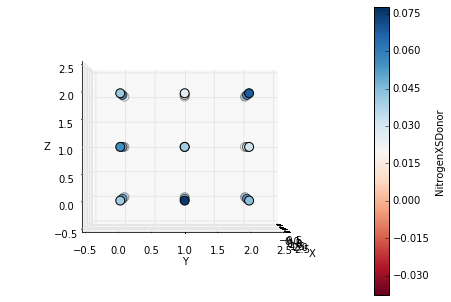

Filter 3 element NitrogenXSDonorAcceptor


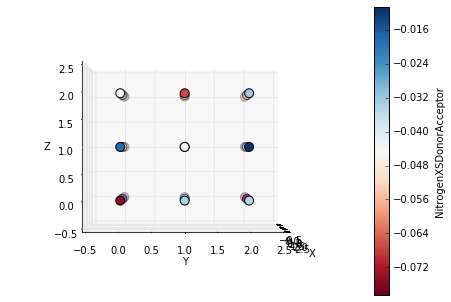

Filter 3 element Oxygen


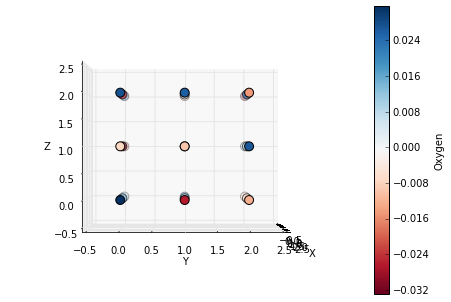

Filter 3 element OxygenXSAcceptor


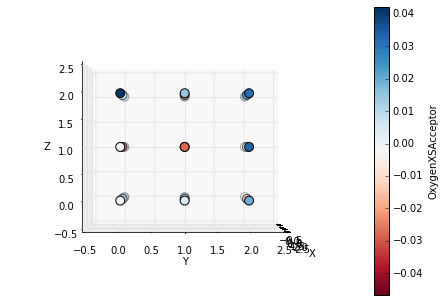

Filter 3 element OxygenXSDonorAcceptor


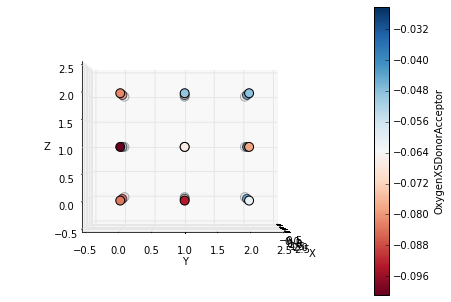

Filter 3 element Phosphorus


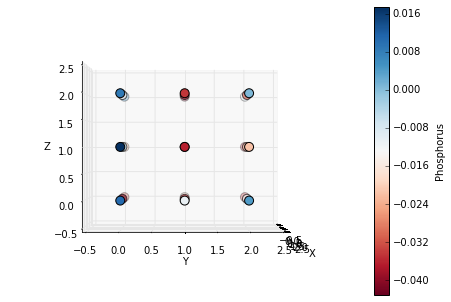

Filter 3 element Sulfur


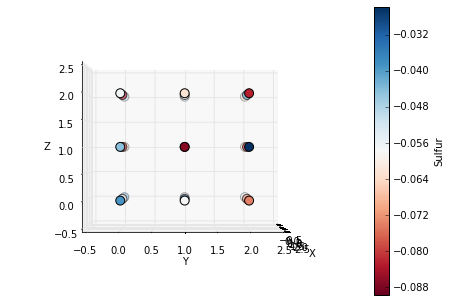

Filter 3 element SulfurAcceptor


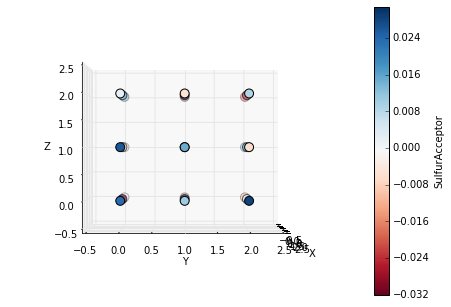

Filter 3 element Iodine


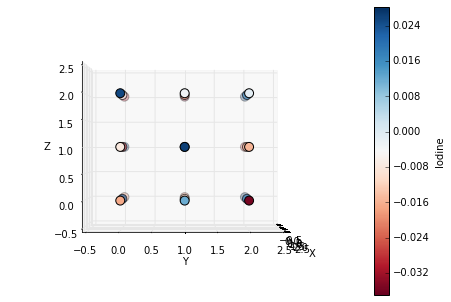

Filter 3 element Boron


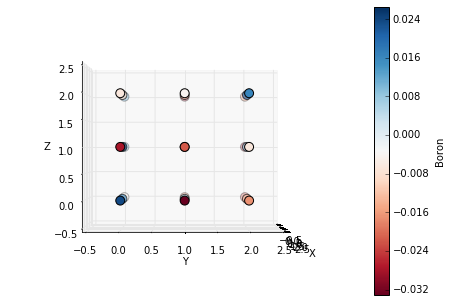

Filter 4 element AliphaticCarbonXSHydrophobe


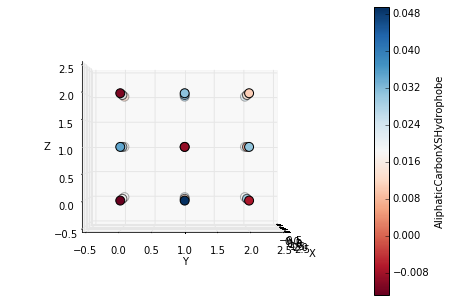

Filter 4 element AliphaticCarbonXSNonHydrophobe


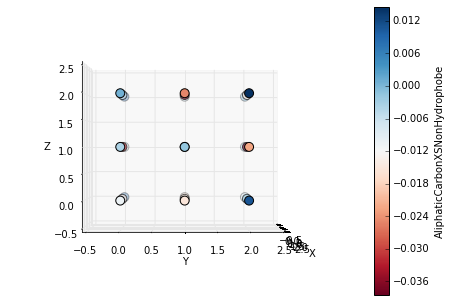

Filter 4 element AromaticCarbonXSHydrophobe


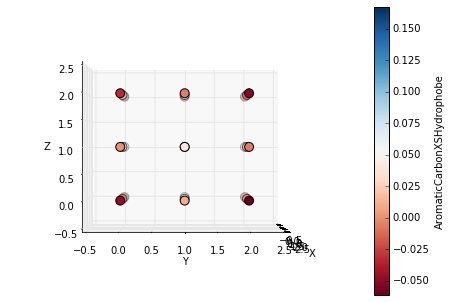

Filter 4 element AromaticCarbonXSNonHydrophobe


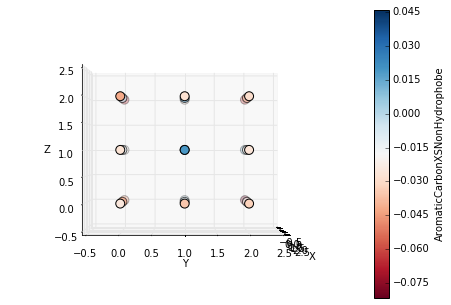

Filter 4 element Calcium


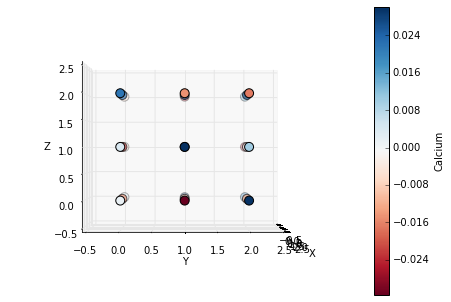

Filter 4 element Iron


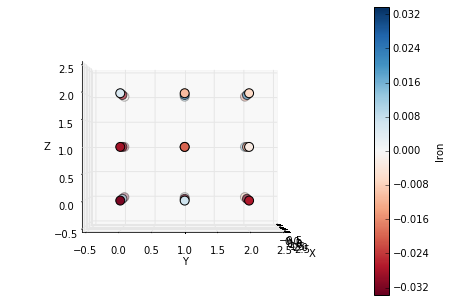

Filter 4 element Magnesium


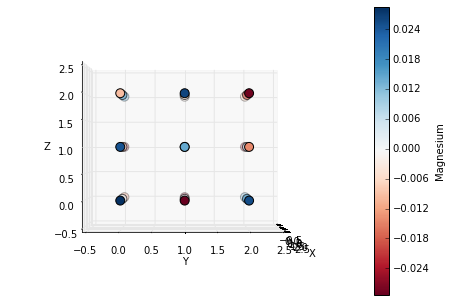

Filter 4 element Nitrogen


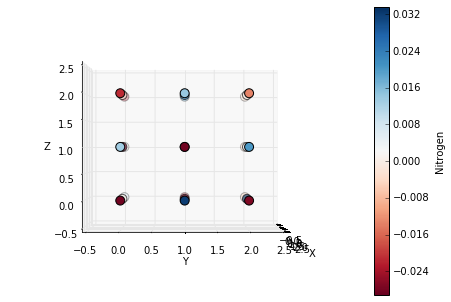

Filter 4 element NitrogenXSAcceptor


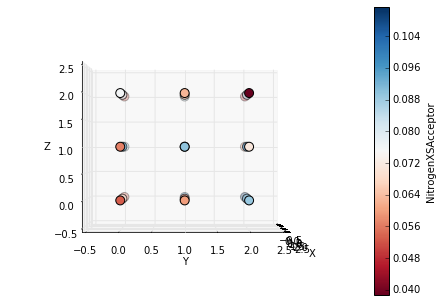

Filter 4 element NitrogenXSDonor


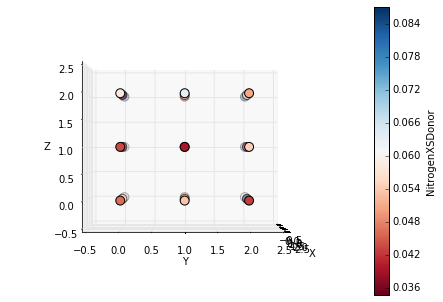

Filter 4 element NitrogenXSDonorAcceptor


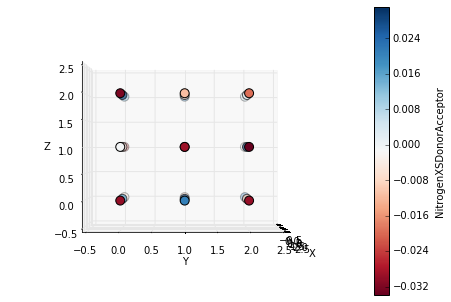

Filter 4 element OxygenXSAcceptor


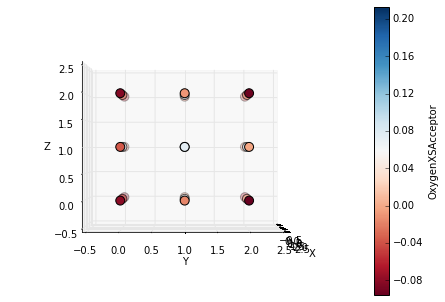

Filter 4 element OxygenXSDonorAcceptor


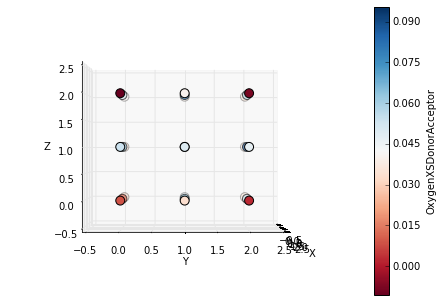

Filter 4 element Phosphorus


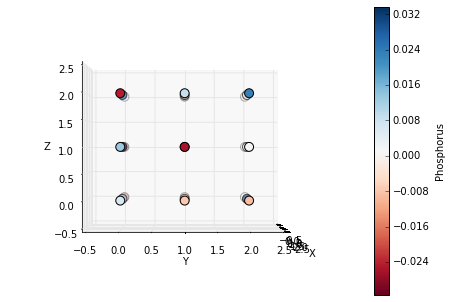

Filter 4 element Sulfur


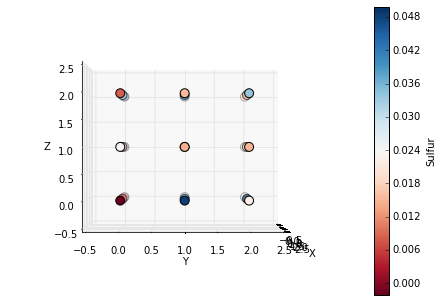

Filter 4 element Zinc


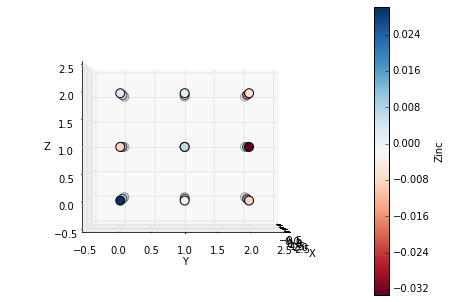

Filter 4 element AliphaticCarbonXSHydrophobe


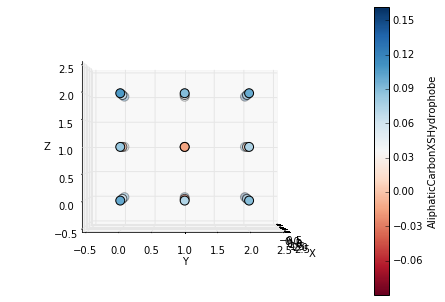

Filter 4 element AliphaticCarbonXSNonHydrophobe


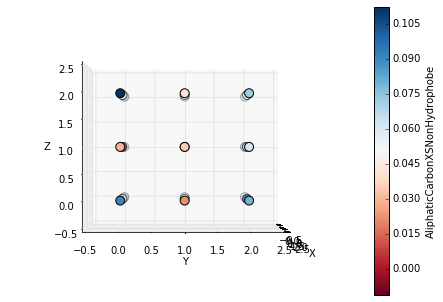

Filter 4 element AromaticCarbonXSHydrophobe


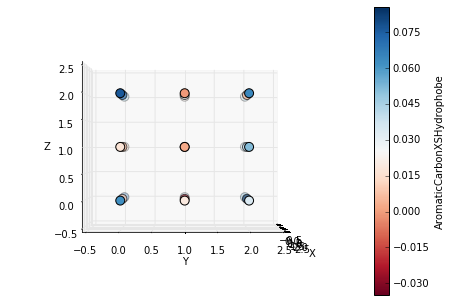

Filter 4 element AromaticCarbonXSNonHydrophobe


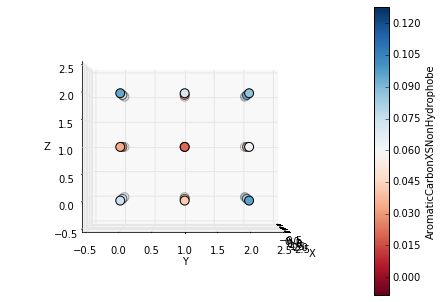

Filter 4 element Bromine


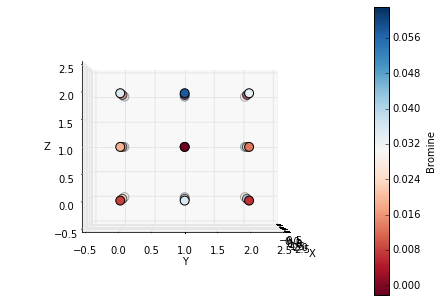

Filter 4 element Chlorine


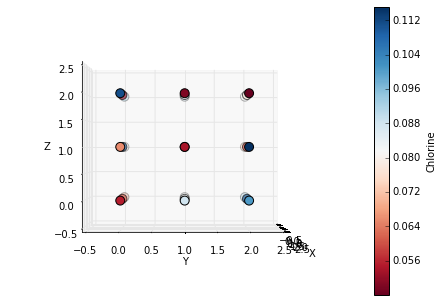

Filter 4 element Fluorine


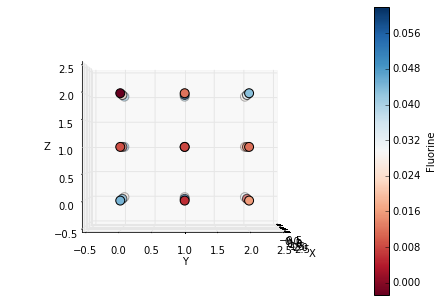

Filter 4 element Nitrogen


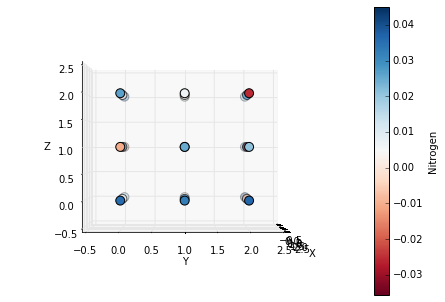

Filter 4 element NitrogenXSAcceptor


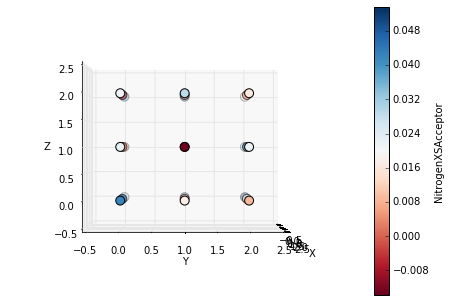

Filter 4 element NitrogenXSDonor


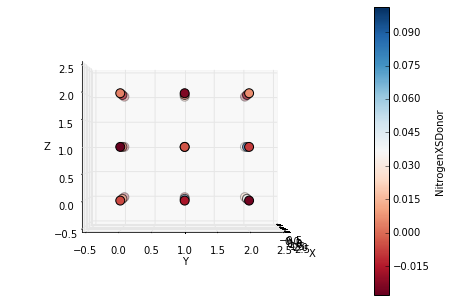

Filter 4 element NitrogenXSDonorAcceptor


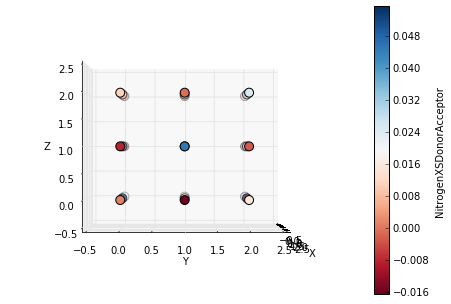

Filter 4 element Oxygen


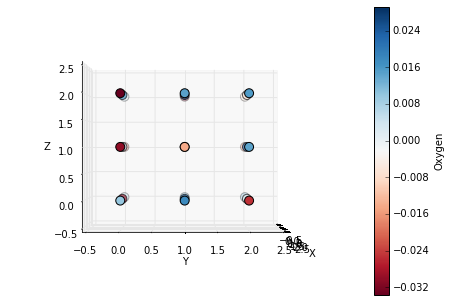

Filter 4 element OxygenXSAcceptor


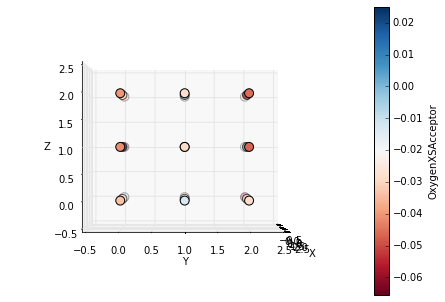

Filter 4 element OxygenXSDonorAcceptor


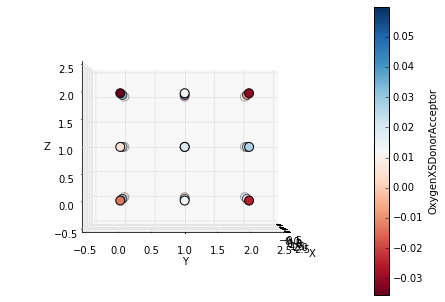

Filter 4 element Phosphorus


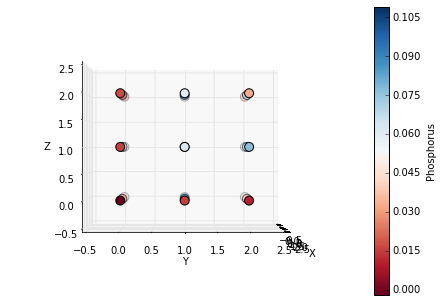

Filter 4 element Sulfur


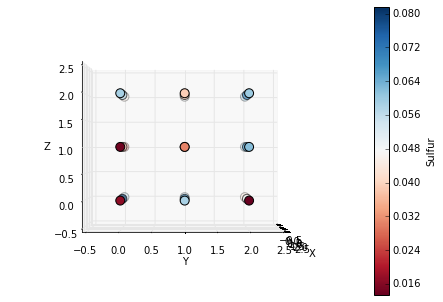

Filter 4 element SulfurAcceptor


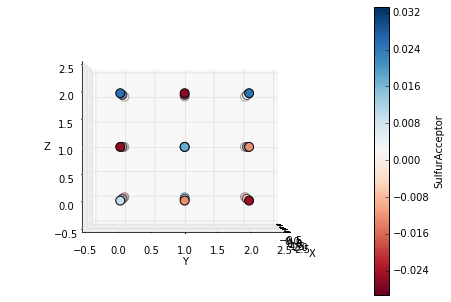

Filter 4 element Iodine


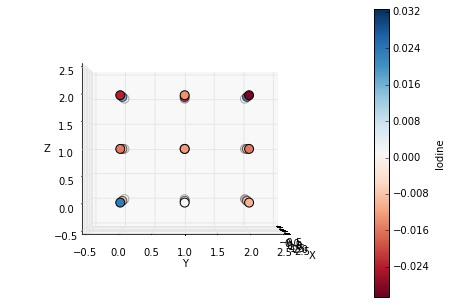

Filter 4 element Boron


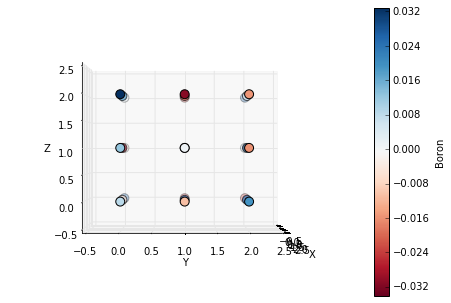

Filter 5 element AliphaticCarbonXSHydrophobe


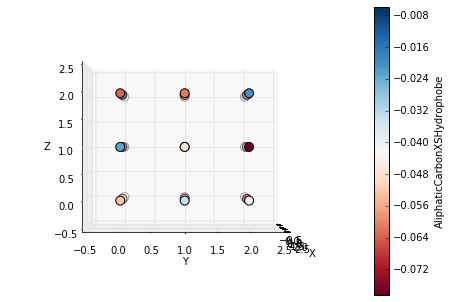

Filter 5 element AliphaticCarbonXSNonHydrophobe


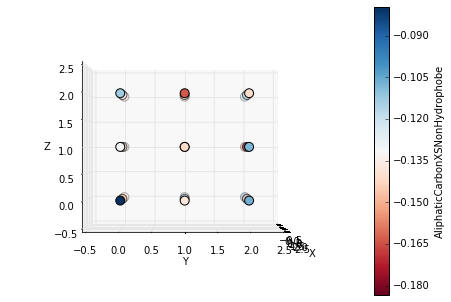

Filter 5 element AromaticCarbonXSHydrophobe


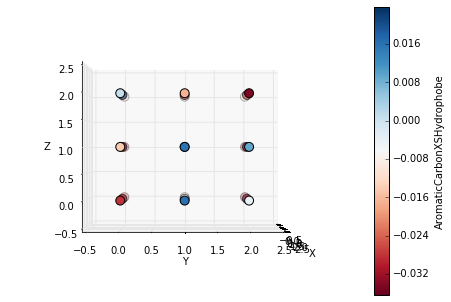

Filter 5 element AromaticCarbonXSNonHydrophobe


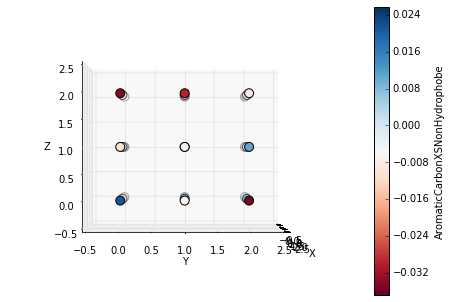

Filter 5 element Calcium


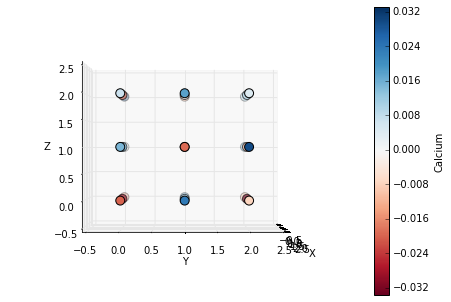

Filter 5 element Iron


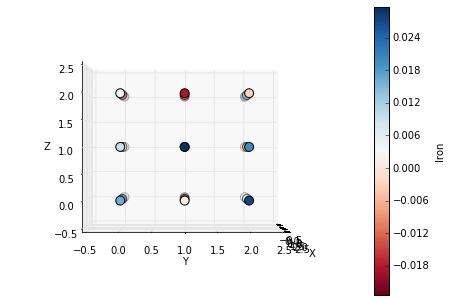

Filter 5 element Magnesium


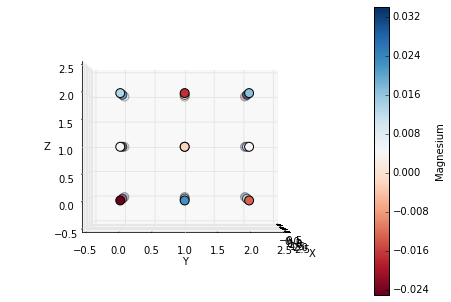

Filter 5 element Nitrogen


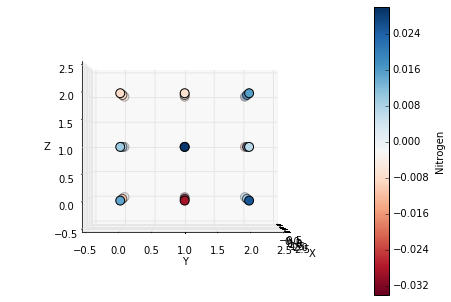

Filter 5 element NitrogenXSAcceptor


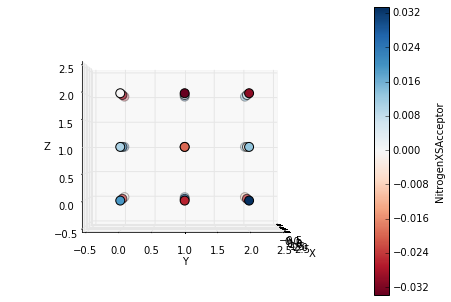

Filter 5 element NitrogenXSDonor


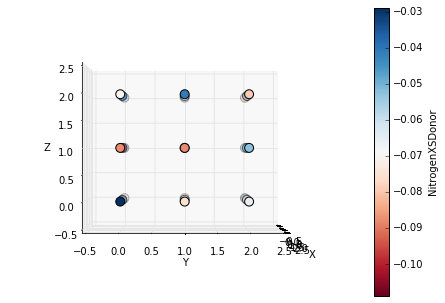

Filter 5 element NitrogenXSDonorAcceptor


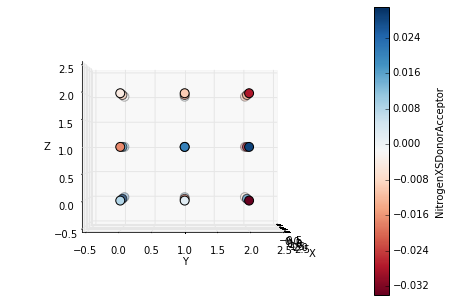

Filter 5 element OxygenXSAcceptor


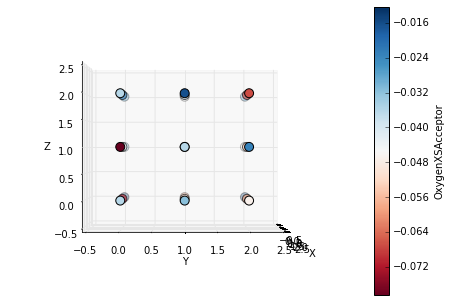

Filter 5 element OxygenXSDonorAcceptor


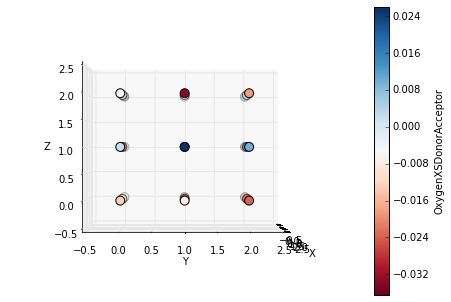

Filter 5 element Phosphorus


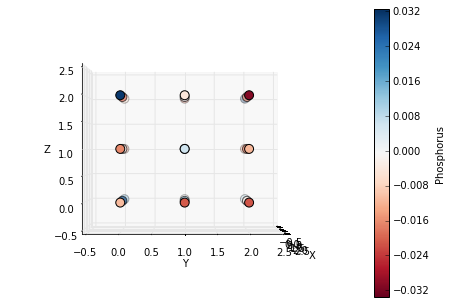

Filter 5 element Sulfur


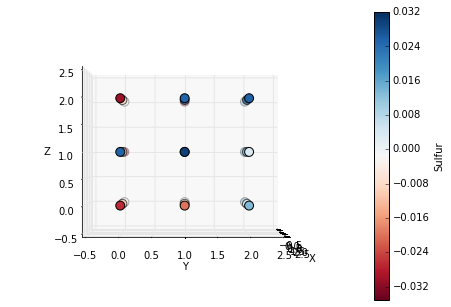

Filter 5 element Zinc


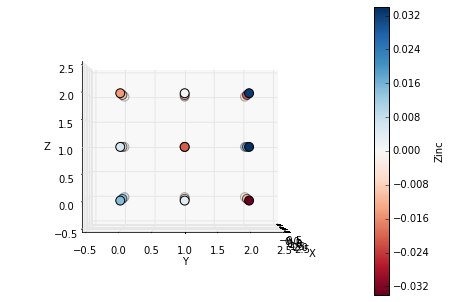

Filter 5 element AliphaticCarbonXSHydrophobe


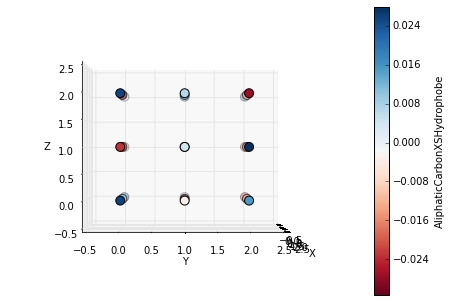

Filter 5 element AliphaticCarbonXSNonHydrophobe


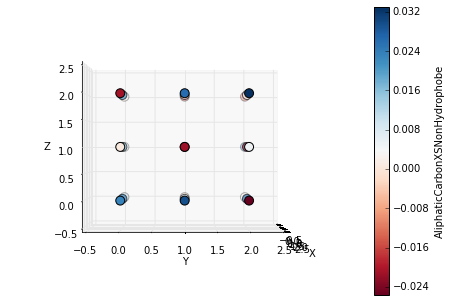

Filter 5 element AromaticCarbonXSHydrophobe


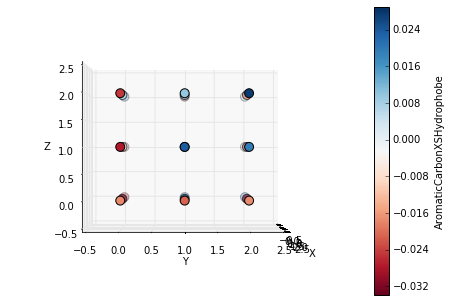

Filter 5 element AromaticCarbonXSNonHydrophobe


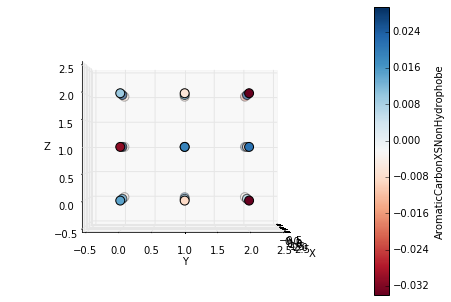

Filter 5 element Bromine


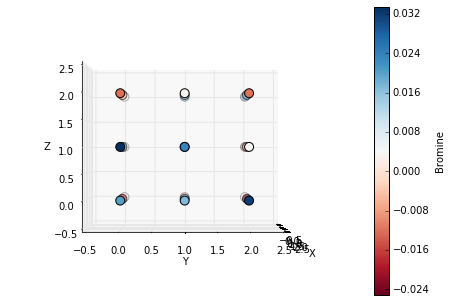

Filter 5 element Chlorine


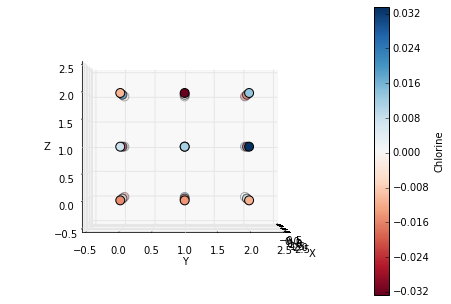

Filter 5 element Fluorine


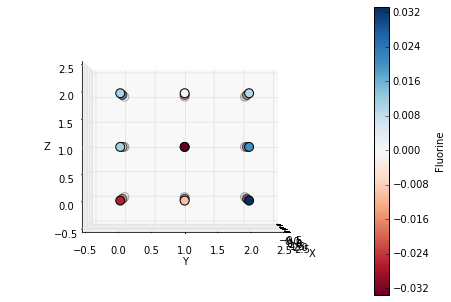

Filter 5 element Nitrogen


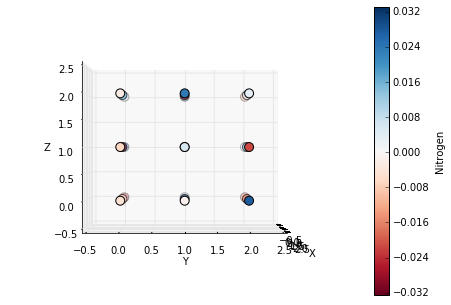

Filter 5 element NitrogenXSAcceptor


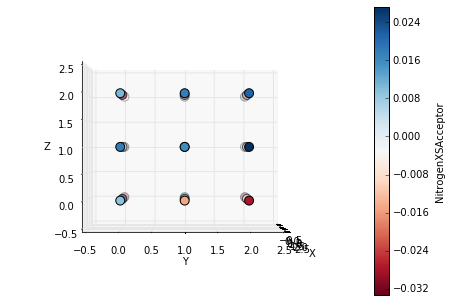

Filter 5 element NitrogenXSDonor


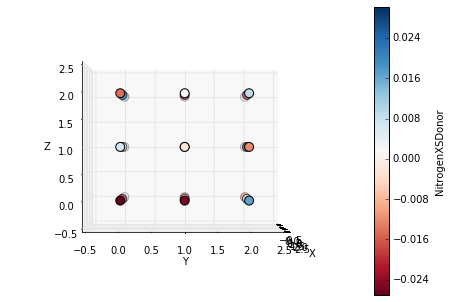

Filter 5 element NitrogenXSDonorAcceptor


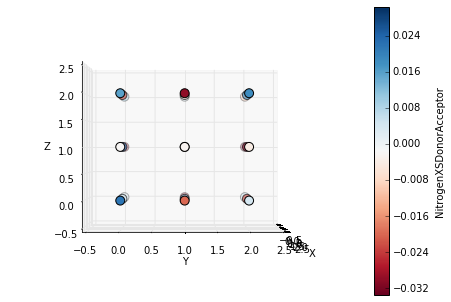

Filter 5 element Oxygen


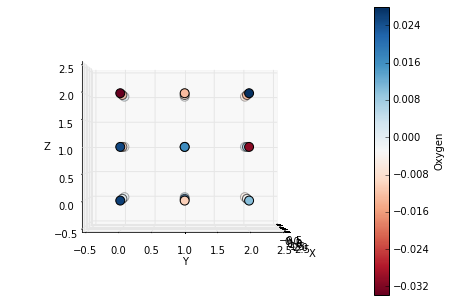

Filter 5 element OxygenXSAcceptor


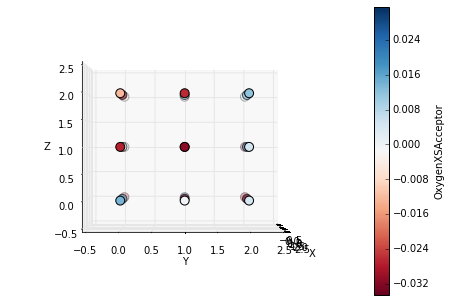

Filter 5 element OxygenXSDonorAcceptor


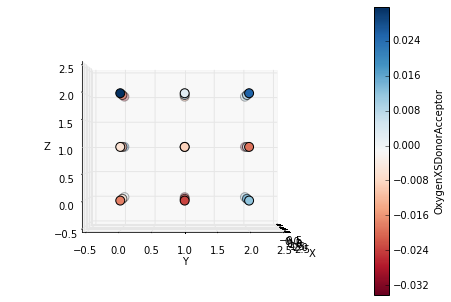

Filter 5 element Phosphorus


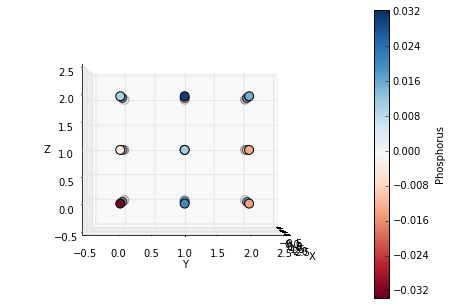

Filter 5 element Sulfur


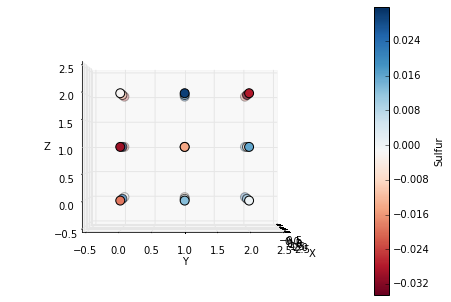

Filter 5 element SulfurAcceptor


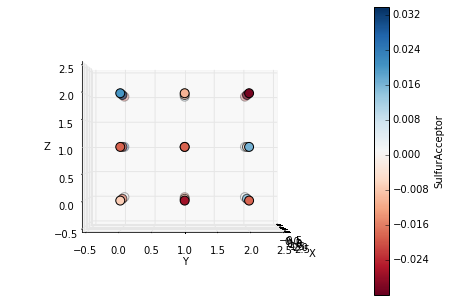

Filter 5 element Iodine


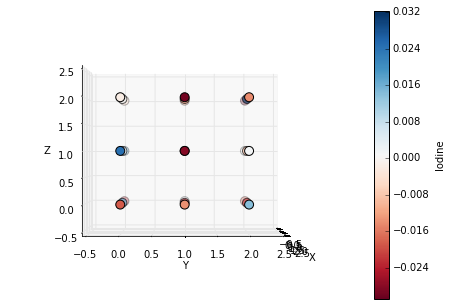

Filter 5 element Boron


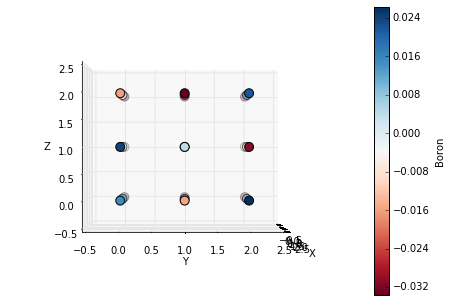

Filter 6 element AliphaticCarbonXSHydrophobe


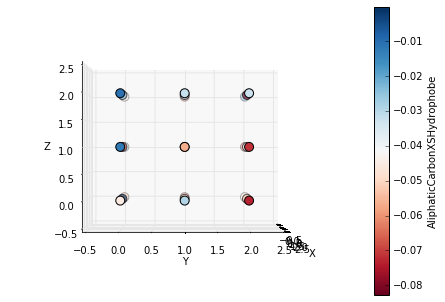

Filter 6 element AliphaticCarbonXSNonHydrophobe


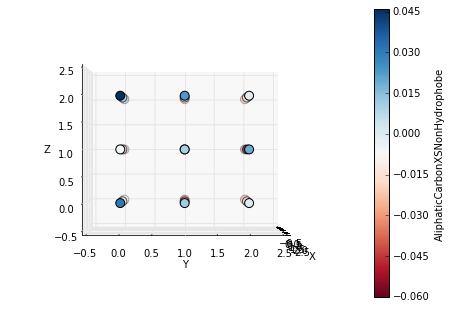

Filter 6 element AromaticCarbonXSHydrophobe


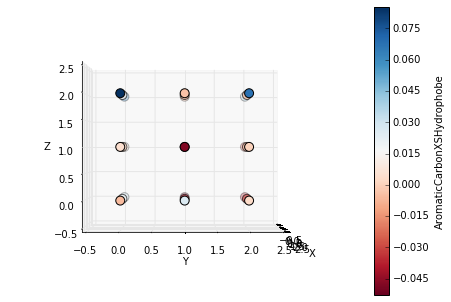

Filter 6 element AromaticCarbonXSNonHydrophobe


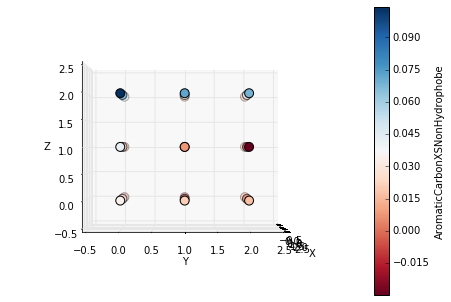

Filter 6 element Calcium


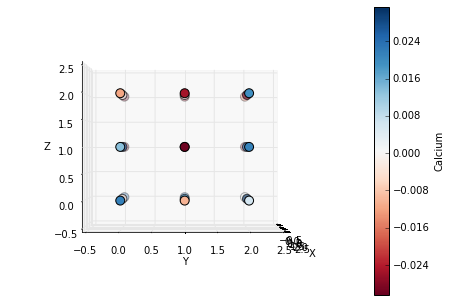

Filter 6 element Iron


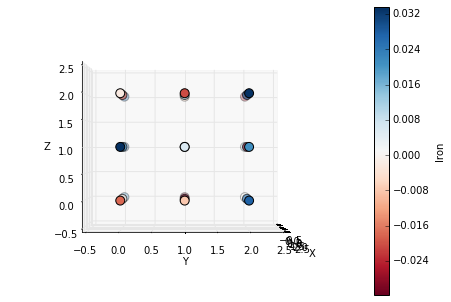

Filter 6 element Magnesium


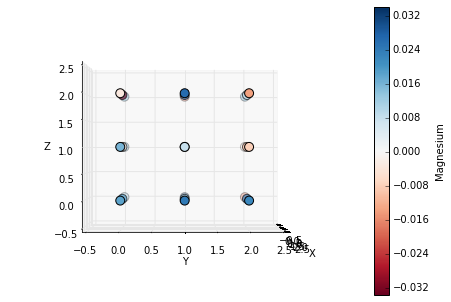

Filter 6 element Nitrogen


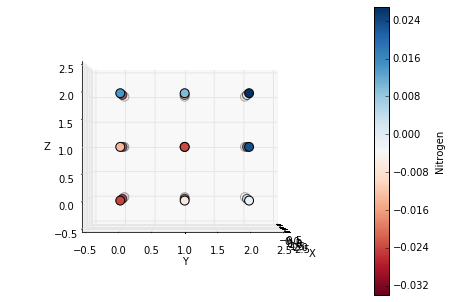

Filter 6 element NitrogenXSAcceptor


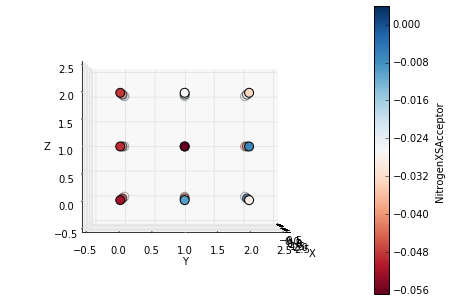

Filter 6 element NitrogenXSDonor


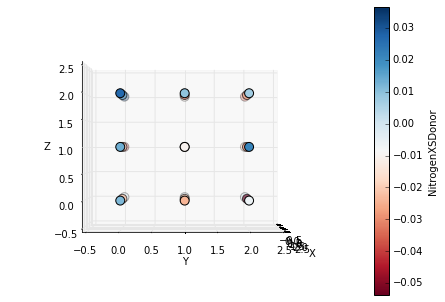

Filter 6 element NitrogenXSDonorAcceptor


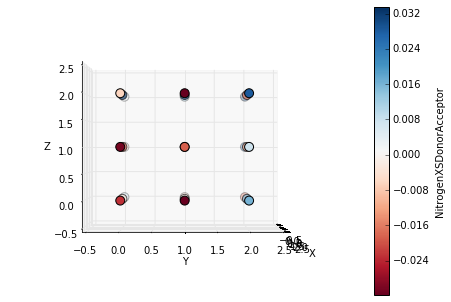

Filter 6 element OxygenXSAcceptor


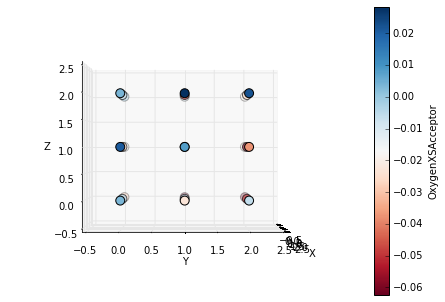

Filter 6 element OxygenXSDonorAcceptor


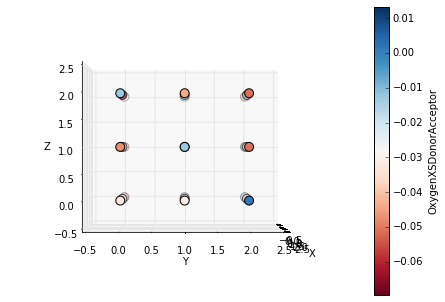

Filter 6 element Phosphorus


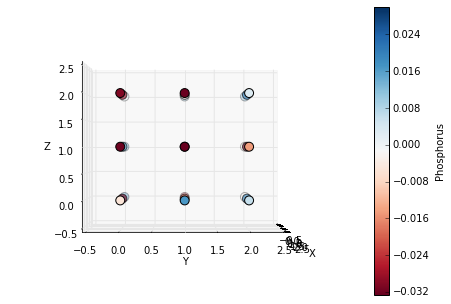

Filter 6 element Sulfur


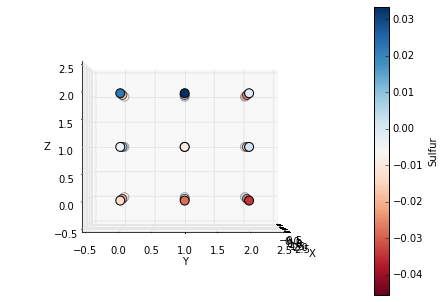

Filter 6 element Zinc


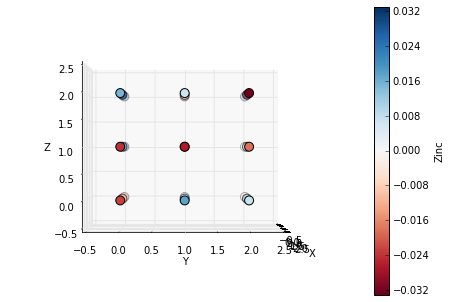

Filter 6 element AliphaticCarbonXSHydrophobe


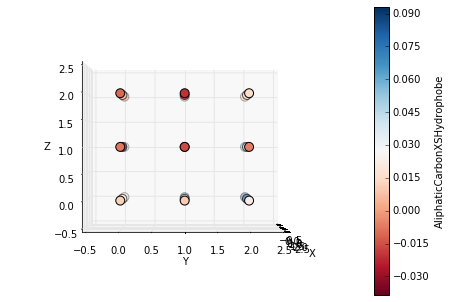

Filter 6 element AliphaticCarbonXSNonHydrophobe


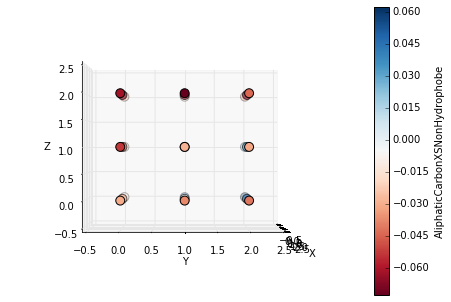

Filter 6 element AromaticCarbonXSHydrophobe


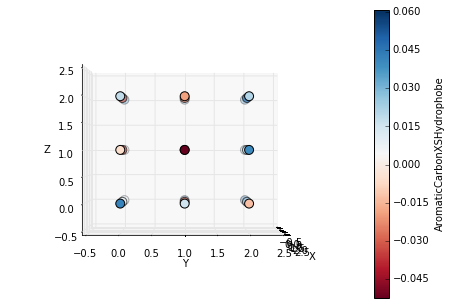

Filter 6 element AromaticCarbonXSNonHydrophobe


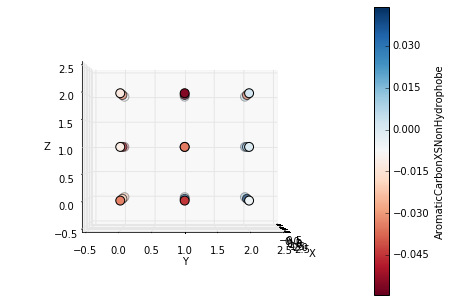

Filter 6 element Bromine


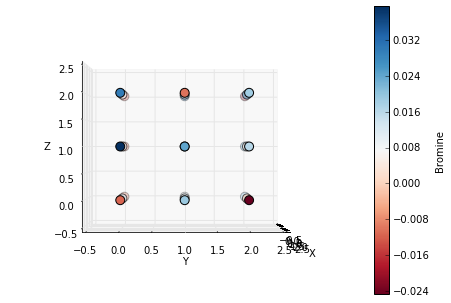

Filter 6 element Chlorine


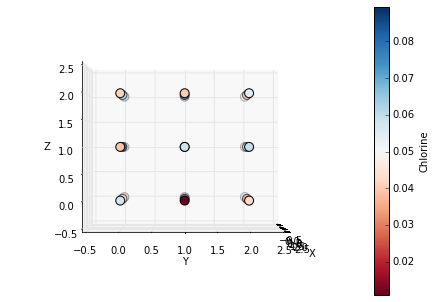

Filter 6 element Fluorine


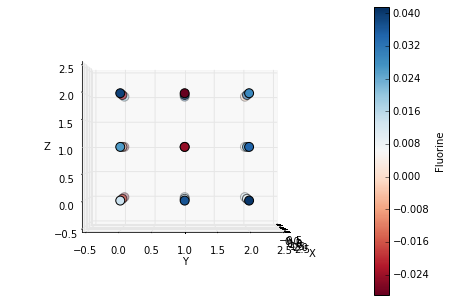

Filter 6 element Nitrogen


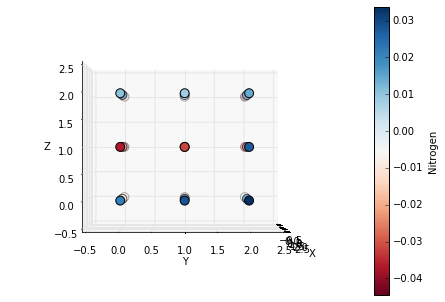

Filter 6 element NitrogenXSAcceptor


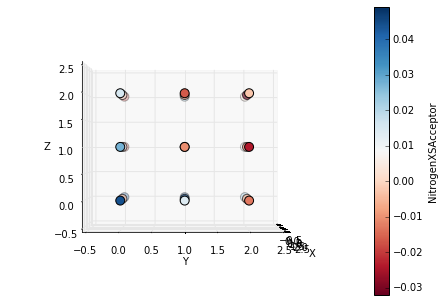

Filter 6 element NitrogenXSDonor


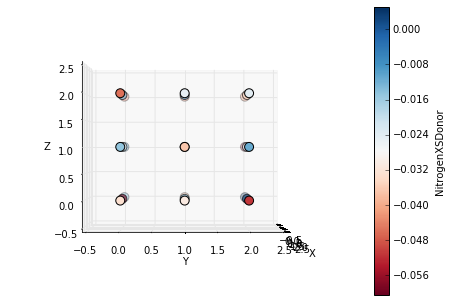

Filter 6 element NitrogenXSDonorAcceptor


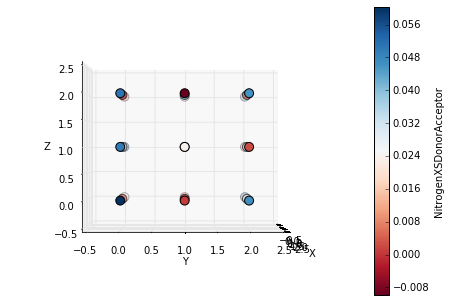

Filter 6 element Oxygen


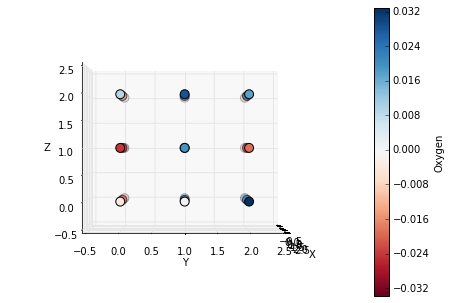

Filter 6 element OxygenXSAcceptor


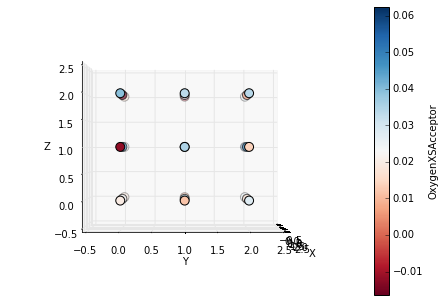

Filter 6 element OxygenXSDonorAcceptor


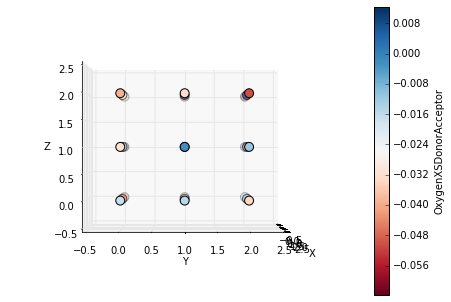

Filter 6 element Phosphorus


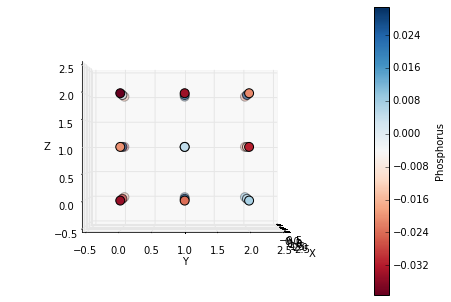

Filter 6 element Sulfur


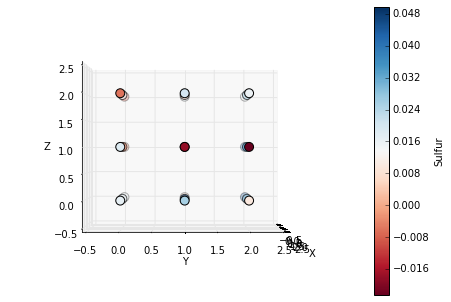

Filter 6 element SulfurAcceptor


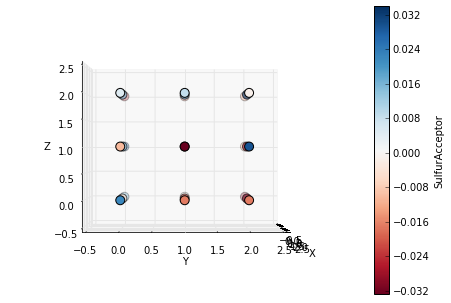

Filter 6 element Iodine


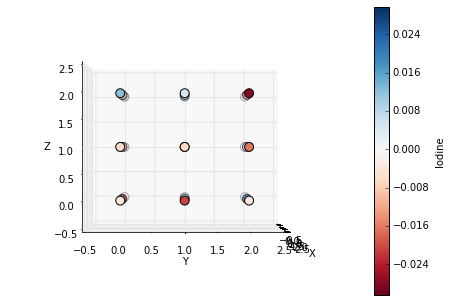

Filter 6 element Boron


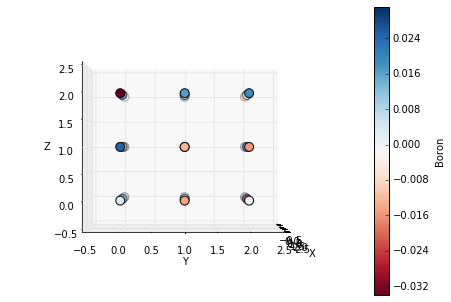

Filter 7 element AliphaticCarbonXSHydrophobe


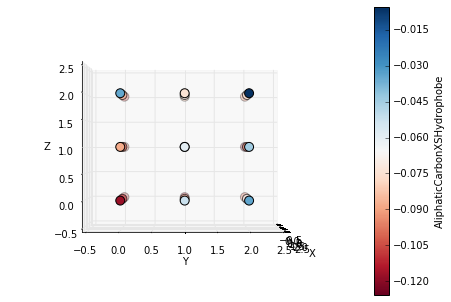

Filter 7 element AliphaticCarbonXSNonHydrophobe


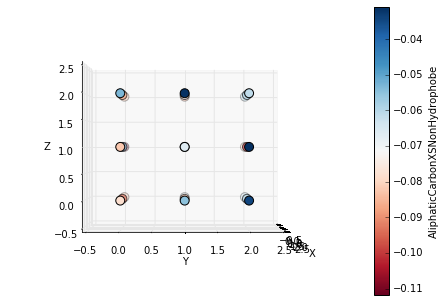

Filter 7 element AromaticCarbonXSHydrophobe


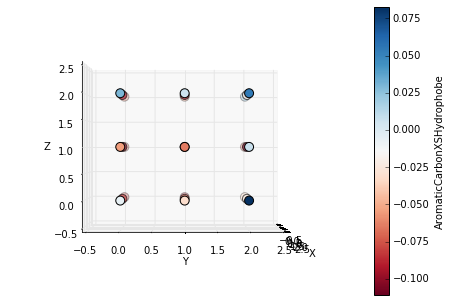

Filter 7 element AromaticCarbonXSNonHydrophobe


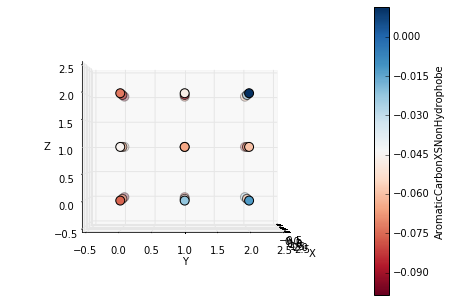

Filter 7 element Calcium


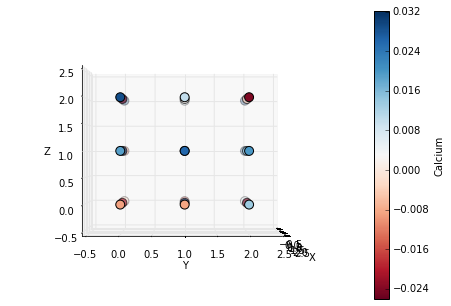

Filter 7 element Iron


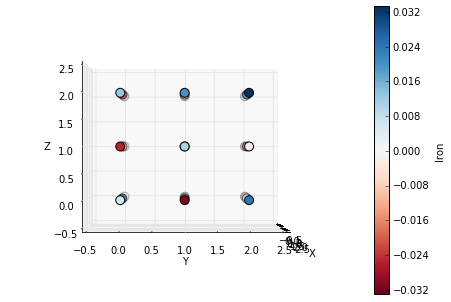

Filter 7 element Magnesium


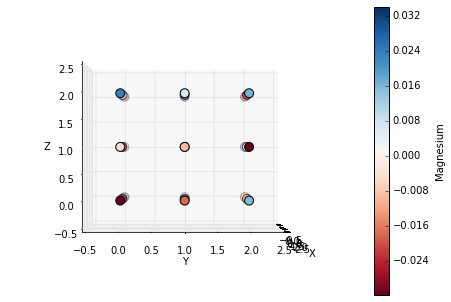

Filter 7 element Nitrogen


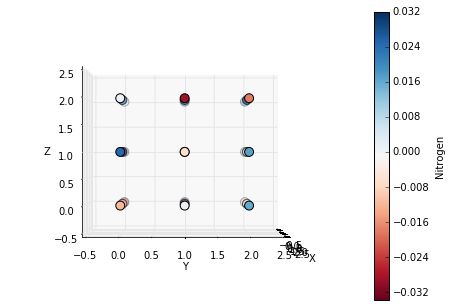

Filter 7 element NitrogenXSAcceptor


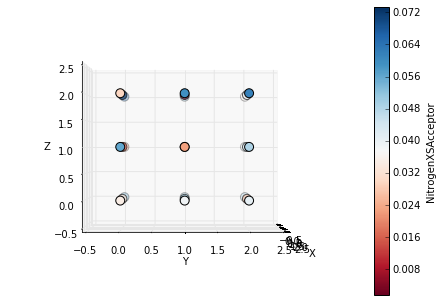

Filter 7 element NitrogenXSDonor


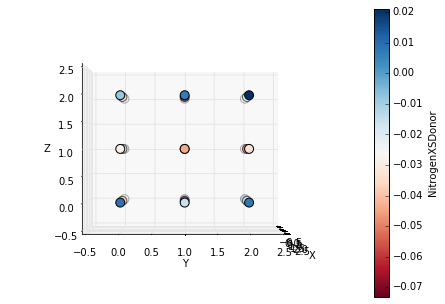

Filter 7 element NitrogenXSDonorAcceptor


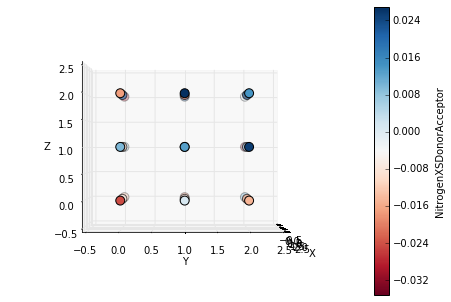

Filter 7 element OxygenXSAcceptor


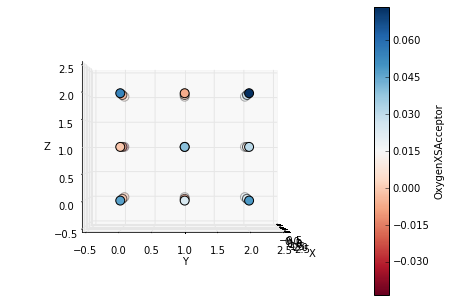

Filter 7 element OxygenXSDonorAcceptor


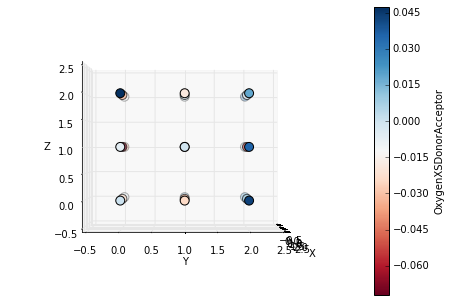

Filter 7 element Phosphorus


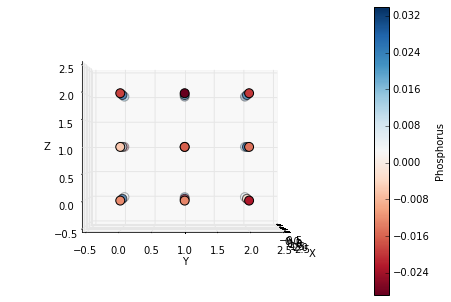

Filter 7 element Sulfur


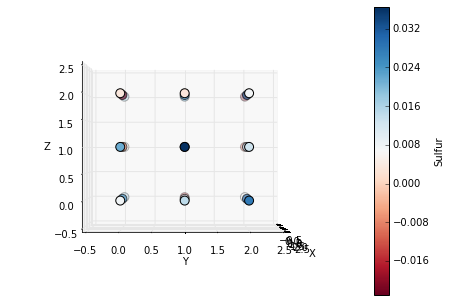

Filter 7 element Zinc


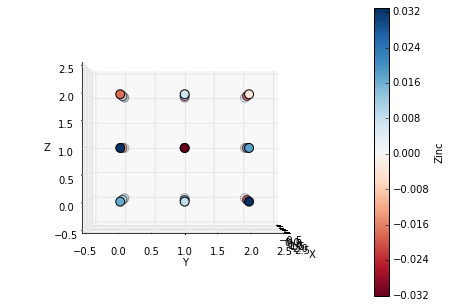

Filter 7 element AliphaticCarbonXSHydrophobe


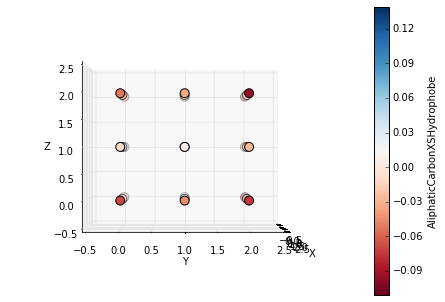

Filter 7 element AliphaticCarbonXSNonHydrophobe


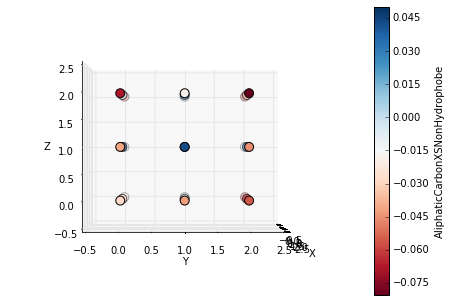

Filter 7 element AromaticCarbonXSHydrophobe


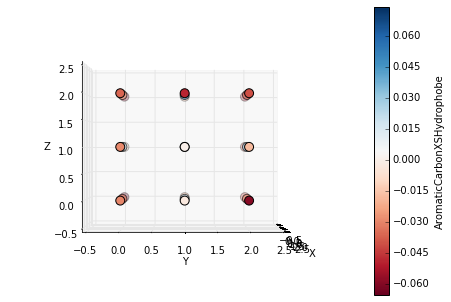

Filter 7 element AromaticCarbonXSNonHydrophobe


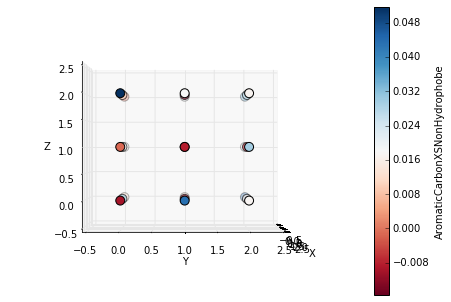

Filter 7 element Bromine


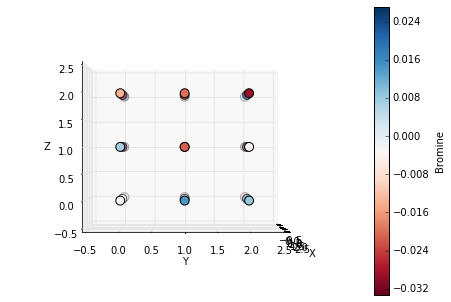

Filter 7 element Chlorine


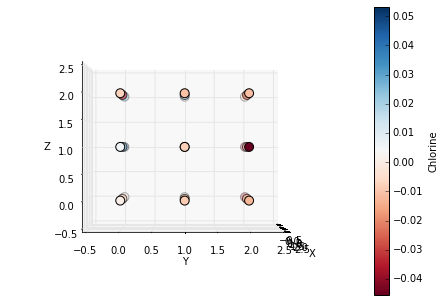

Filter 7 element Fluorine


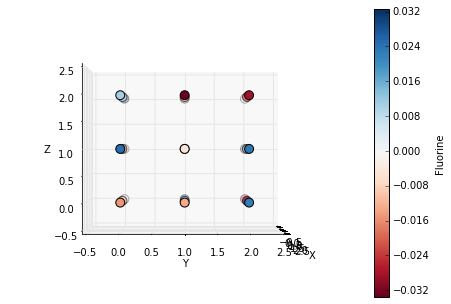

Filter 7 element Nitrogen


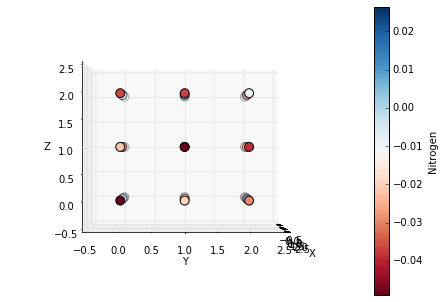

Filter 7 element NitrogenXSAcceptor


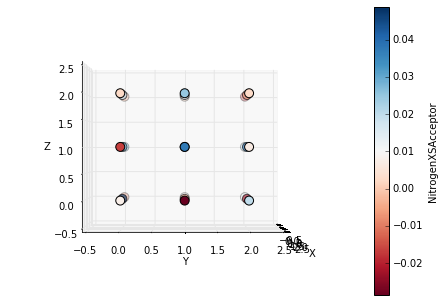

Filter 7 element NitrogenXSDonor


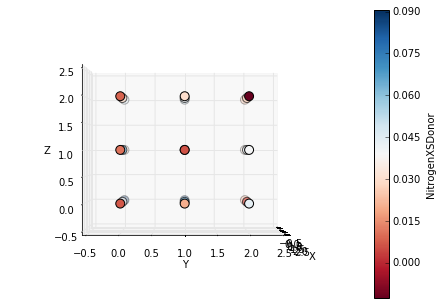

Filter 7 element NitrogenXSDonorAcceptor


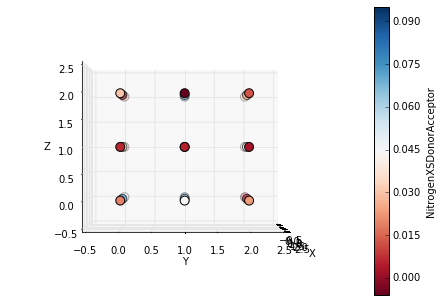

Filter 7 element Oxygen


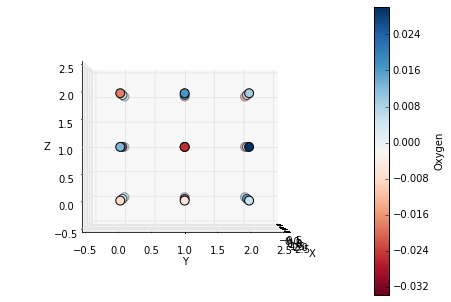

Filter 7 element OxygenXSAcceptor


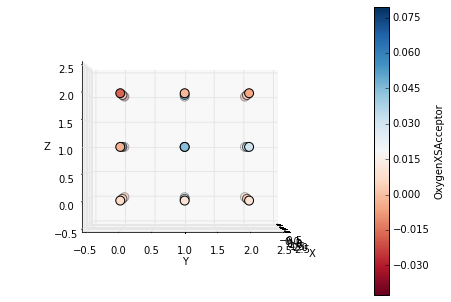

Filter 7 element OxygenXSDonorAcceptor


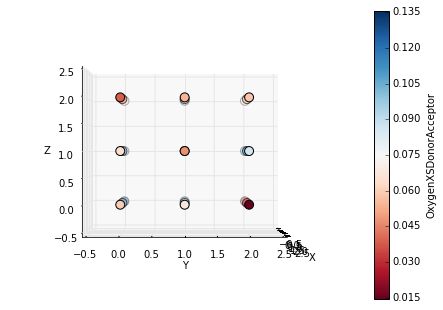

Filter 7 element Phosphorus


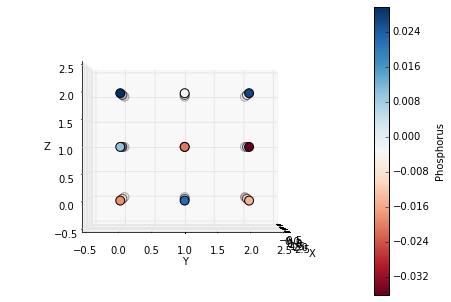

Filter 7 element Sulfur


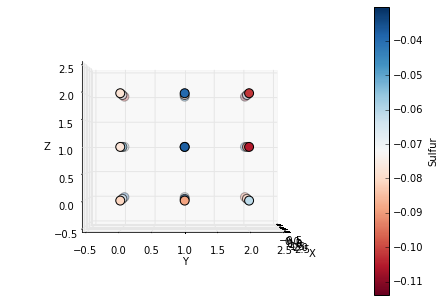

Filter 7 element SulfurAcceptor


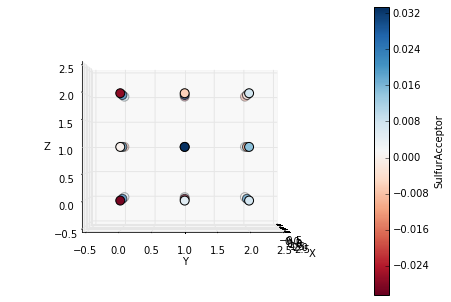

Filter 7 element Iodine


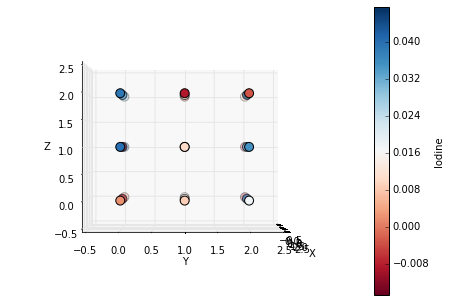

Filter 7 element Boron


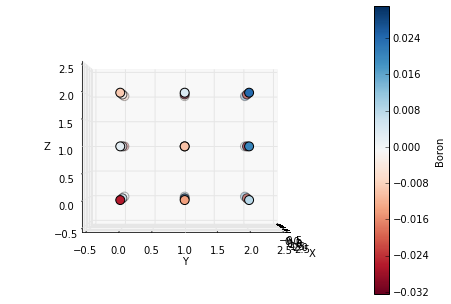

Filter 8 element AliphaticCarbonXSHydrophobe


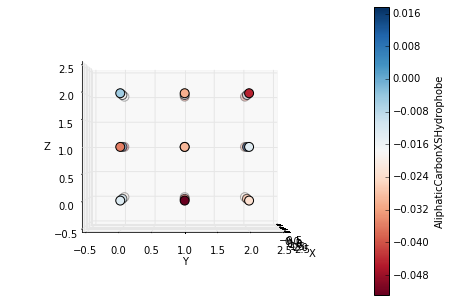

Filter 8 element AliphaticCarbonXSNonHydrophobe


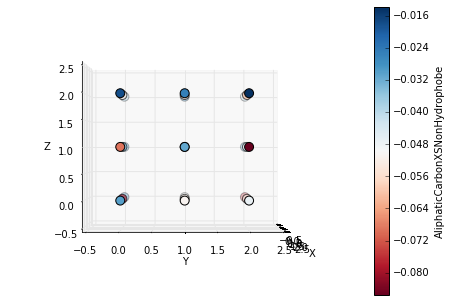

Filter 8 element AromaticCarbonXSHydrophobe


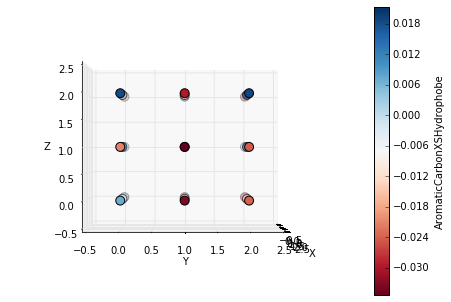

Filter 8 element AromaticCarbonXSNonHydrophobe


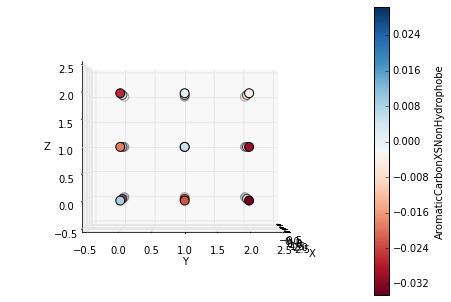

Filter 8 element Calcium


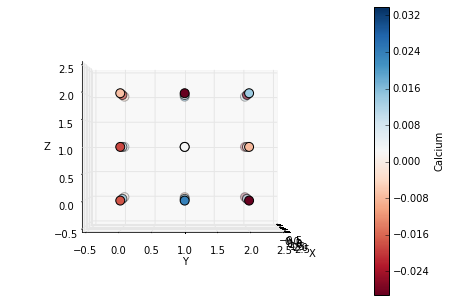

Filter 8 element Iron


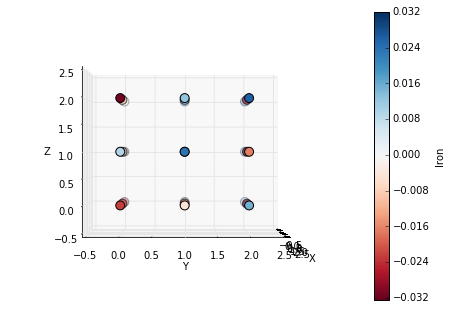

Filter 8 element Magnesium


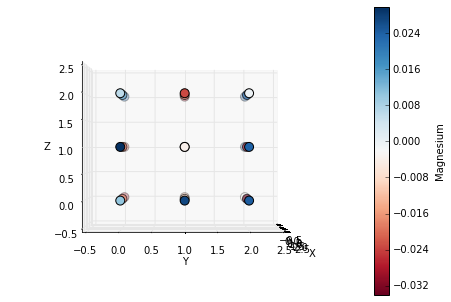

Filter 8 element Nitrogen


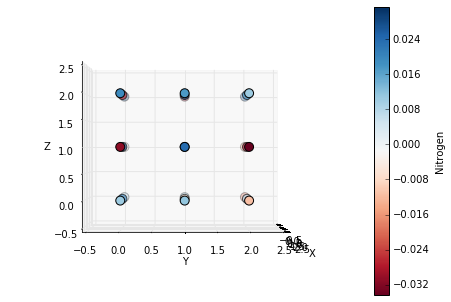

Filter 8 element NitrogenXSAcceptor


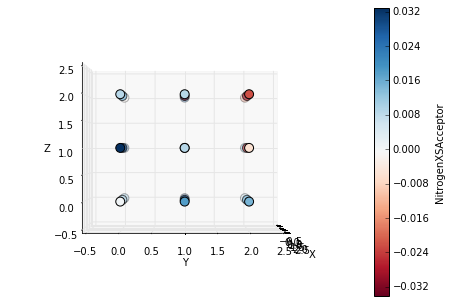

Filter 8 element NitrogenXSDonor


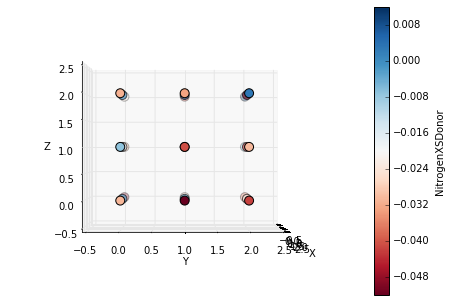

Filter 8 element NitrogenXSDonorAcceptor


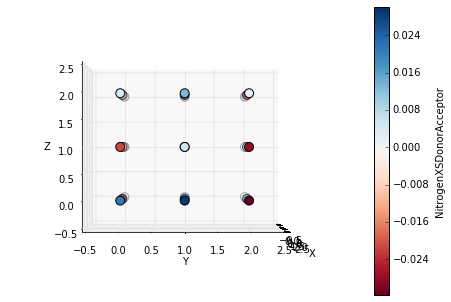

Filter 8 element OxygenXSAcceptor


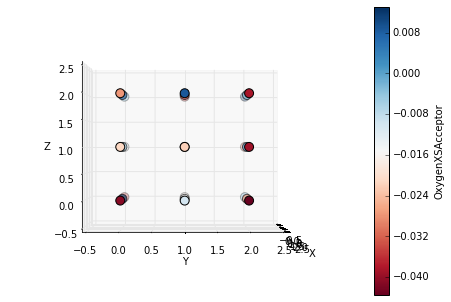

Filter 8 element OxygenXSDonorAcceptor


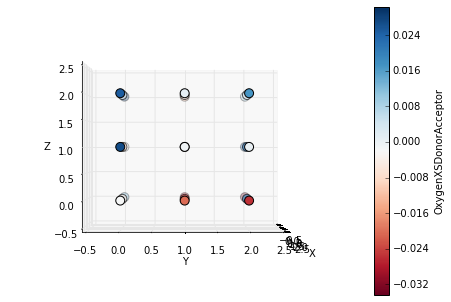

Filter 8 element Phosphorus


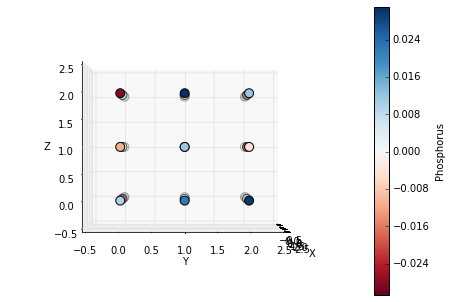

Filter 8 element Sulfur


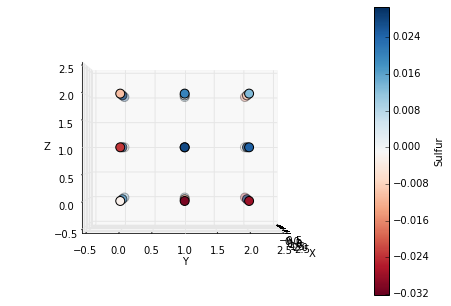

Filter 8 element Zinc


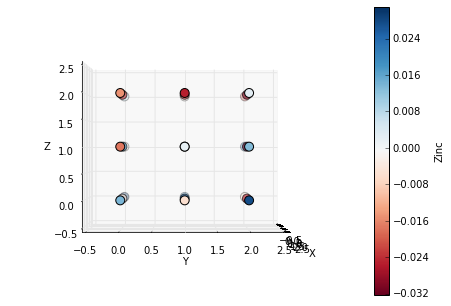

Filter 8 element AliphaticCarbonXSHydrophobe


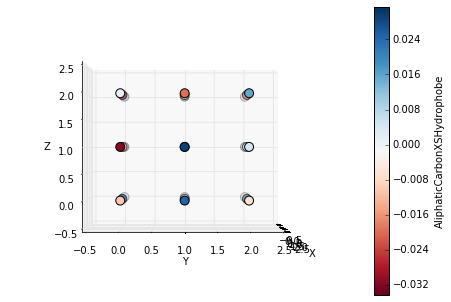

Filter 8 element AliphaticCarbonXSNonHydrophobe


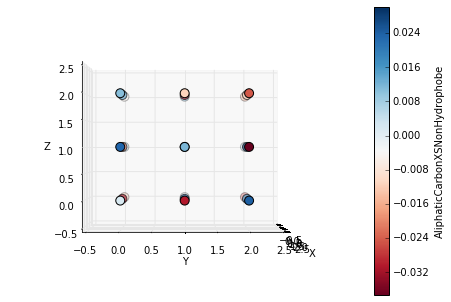

Filter 8 element AromaticCarbonXSHydrophobe


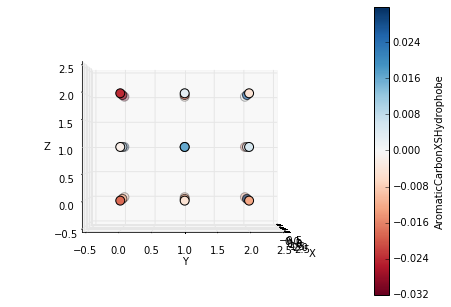

Filter 8 element AromaticCarbonXSNonHydrophobe


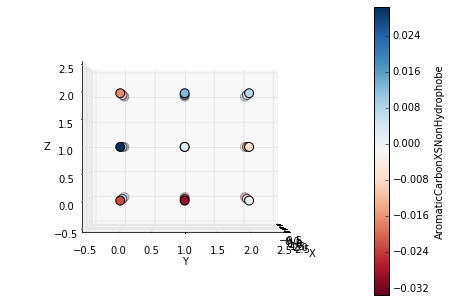

Filter 8 element Bromine


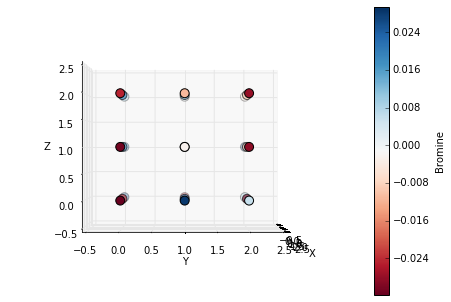

Filter 8 element Chlorine


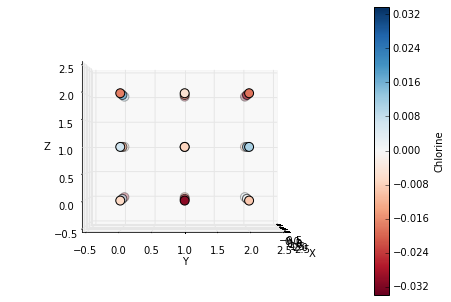

Filter 8 element Fluorine


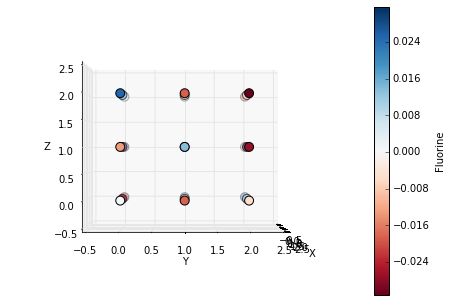

Filter 8 element Nitrogen


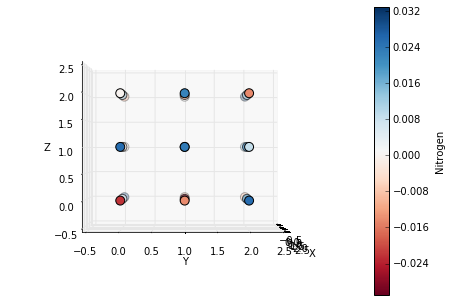

Filter 8 element NitrogenXSAcceptor


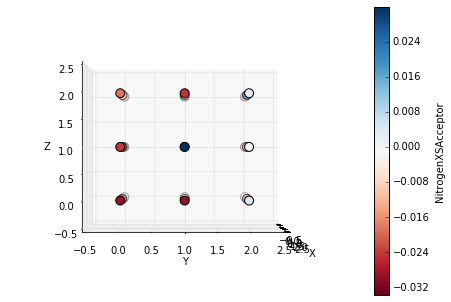

Filter 8 element NitrogenXSDonor


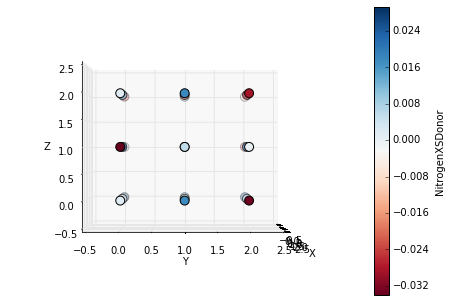

Filter 8 element NitrogenXSDonorAcceptor


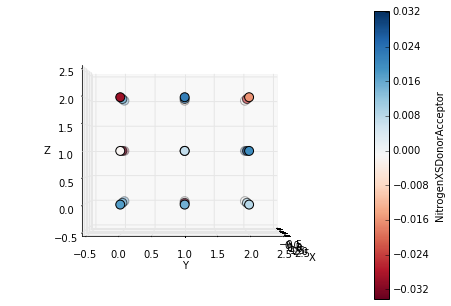

Filter 8 element Oxygen


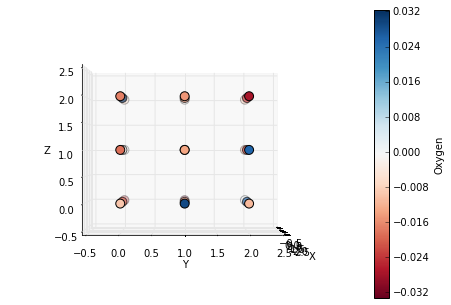

Filter 8 element OxygenXSAcceptor


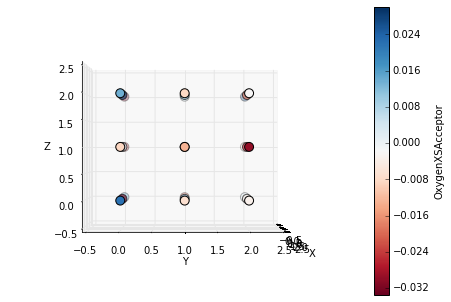

Filter 8 element OxygenXSDonorAcceptor


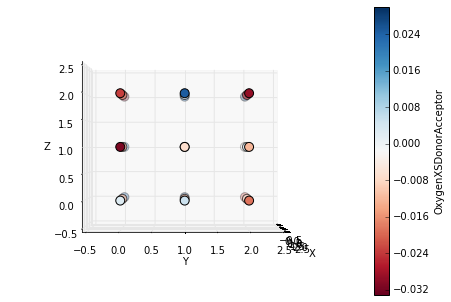

Filter 8 element Phosphorus


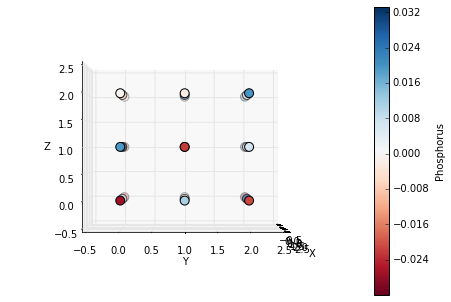

Filter 8 element Sulfur


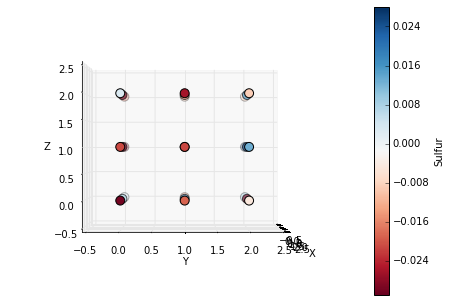

Filter 8 element SulfurAcceptor


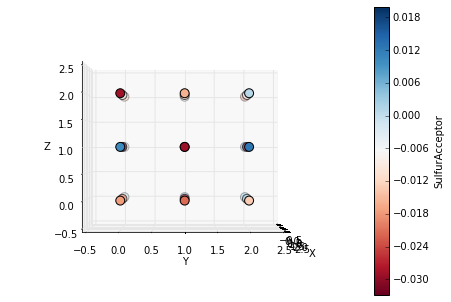

Filter 8 element Iodine


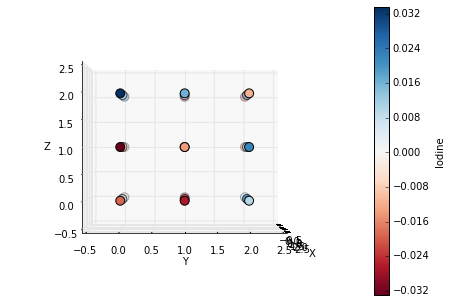

Filter 8 element Boron


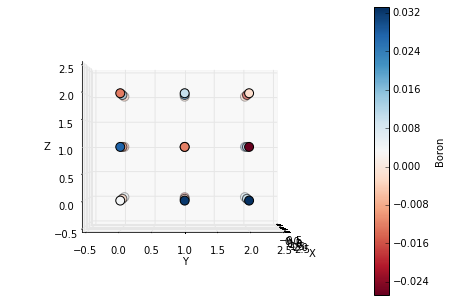

Filter 9 element AliphaticCarbonXSHydrophobe


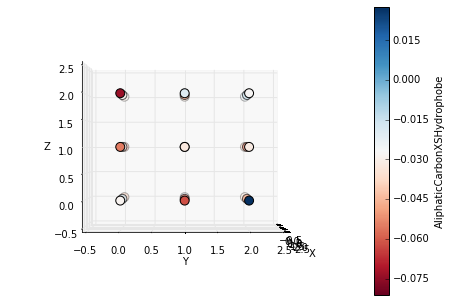

Filter 9 element AliphaticCarbonXSNonHydrophobe


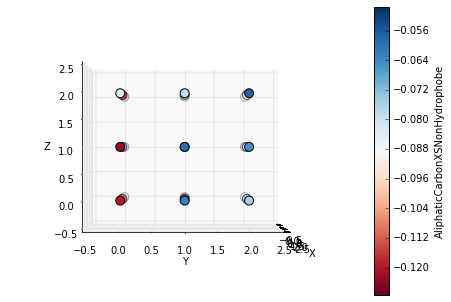

Filter 9 element AromaticCarbonXSHydrophobe


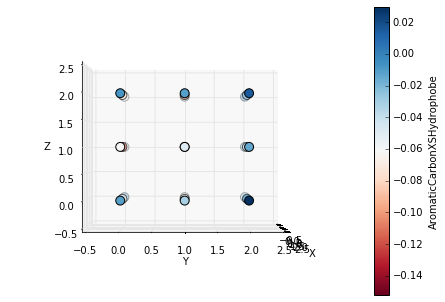

Filter 9 element AromaticCarbonXSNonHydrophobe


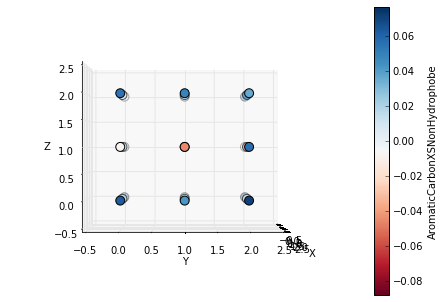

Filter 9 element Calcium


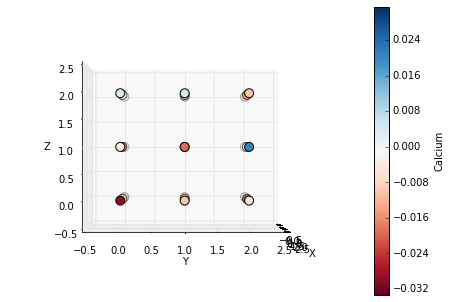

Filter 9 element Iron


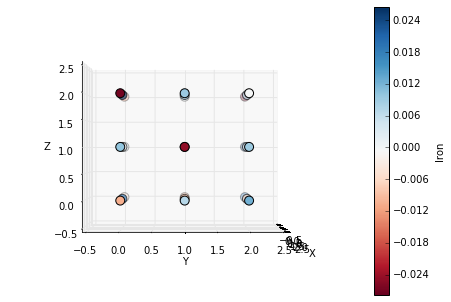

Filter 9 element Magnesium


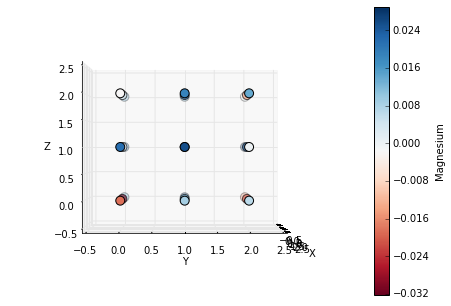

Filter 9 element Nitrogen


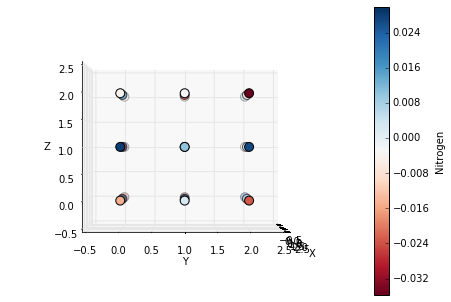

Filter 9 element NitrogenXSAcceptor


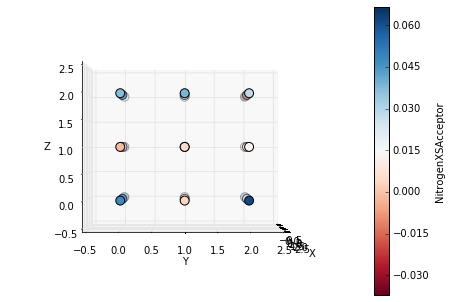

Filter 9 element NitrogenXSDonor


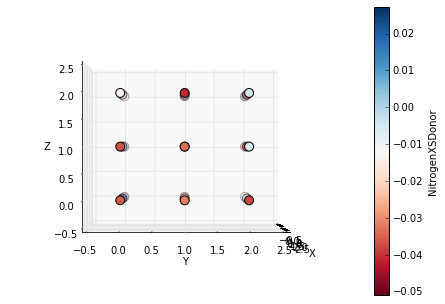

Filter 9 element NitrogenXSDonorAcceptor


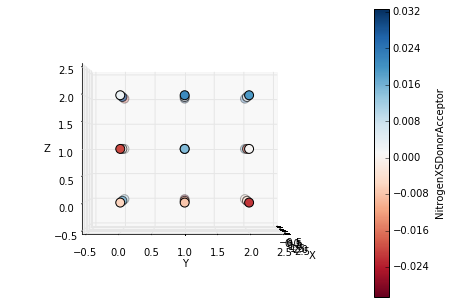

Filter 9 element OxygenXSAcceptor


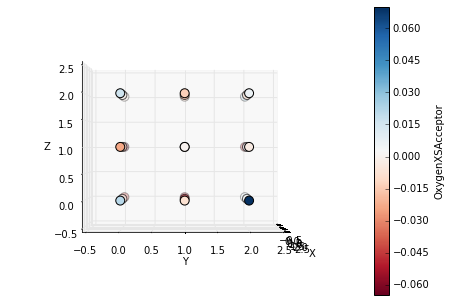

Filter 9 element OxygenXSDonorAcceptor


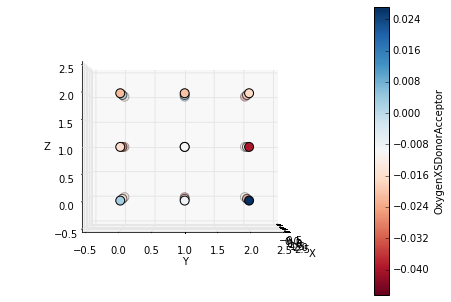

Filter 9 element Phosphorus


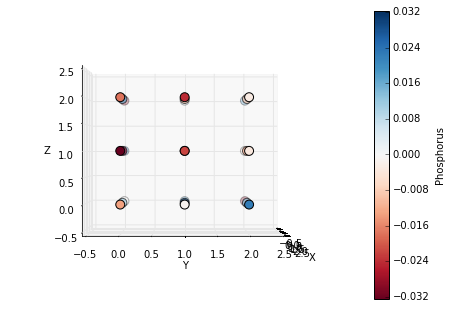

Filter 9 element Sulfur


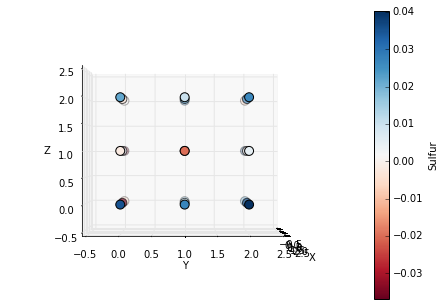

Filter 9 element Zinc


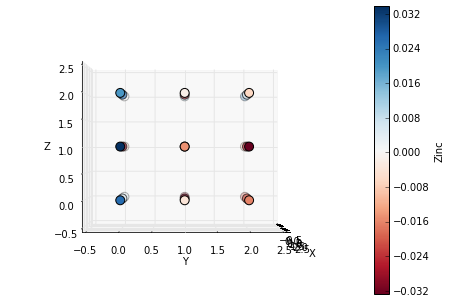

Filter 9 element AliphaticCarbonXSHydrophobe


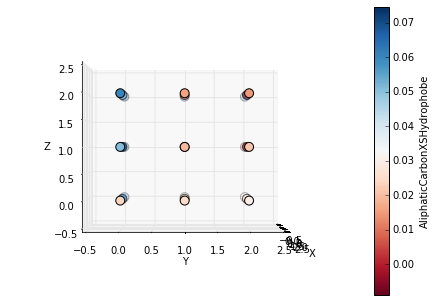

Filter 9 element AliphaticCarbonXSNonHydrophobe


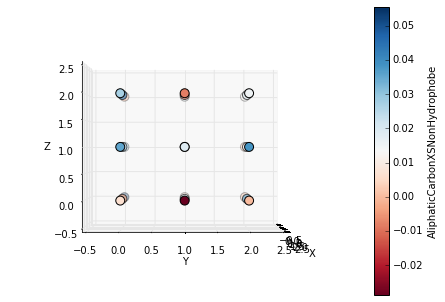

Filter 9 element AromaticCarbonXSHydrophobe


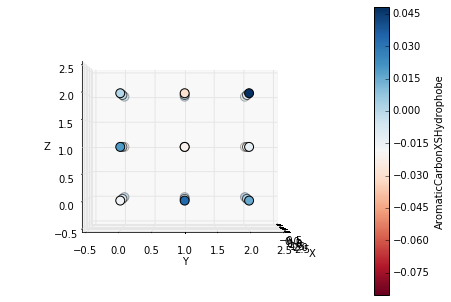

Filter 9 element AromaticCarbonXSNonHydrophobe


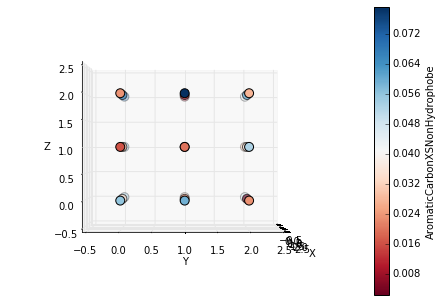

Filter 9 element Bromine


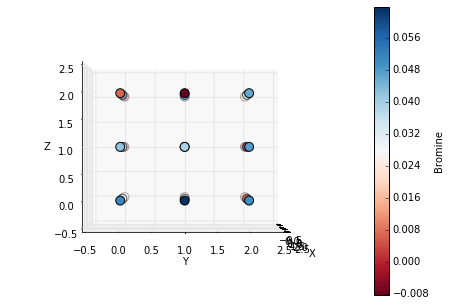

Filter 9 element Chlorine


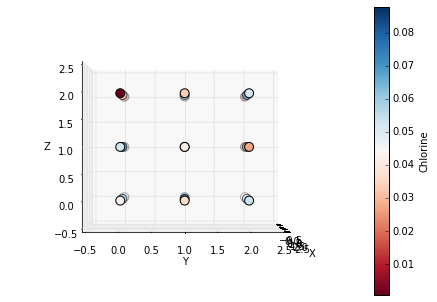

Filter 9 element Fluorine


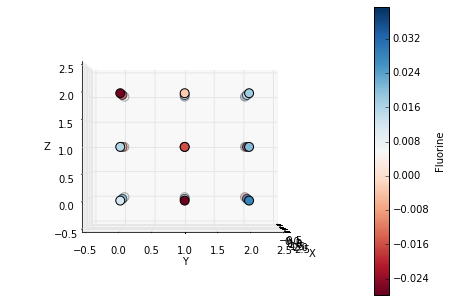

Filter 9 element Nitrogen


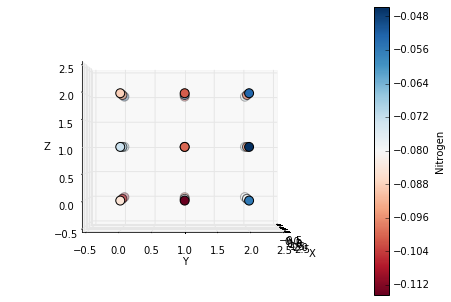

Filter 9 element NitrogenXSAcceptor


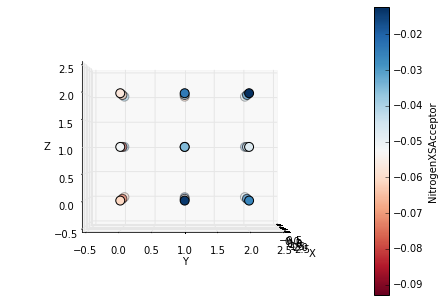

Filter 9 element NitrogenXSDonor


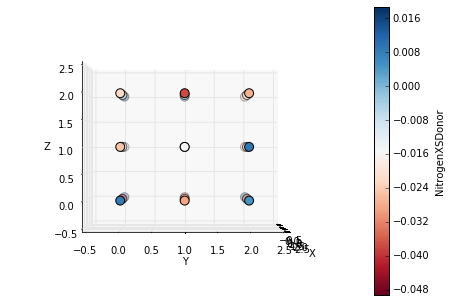

Filter 9 element NitrogenXSDonorAcceptor


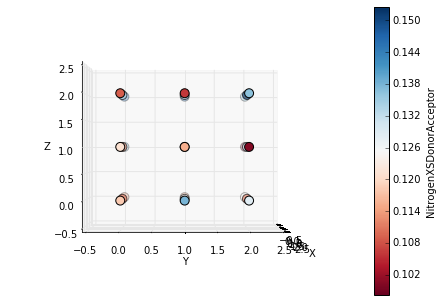

Filter 9 element Oxygen


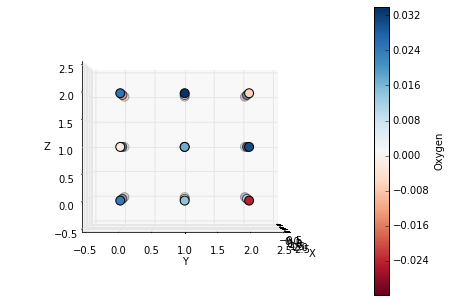

Filter 9 element OxygenXSAcceptor


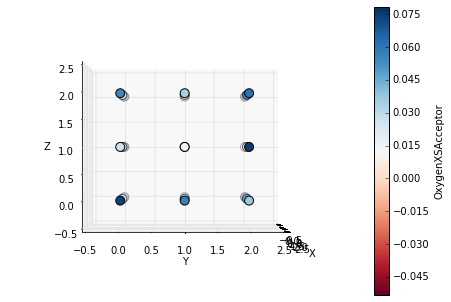

Filter 9 element OxygenXSDonorAcceptor


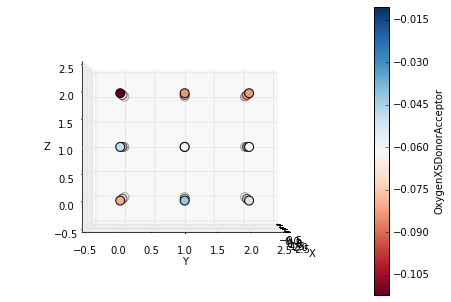

Filter 9 element Phosphorus


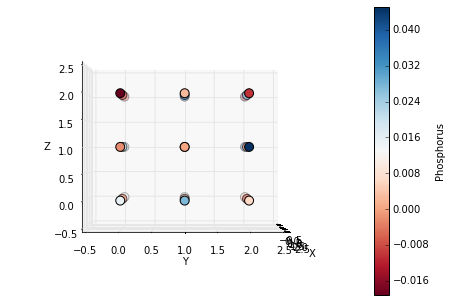

Filter 9 element Sulfur


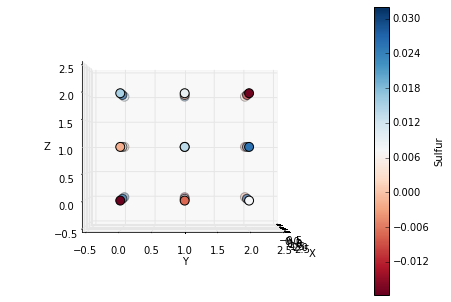

Filter 9 element SulfurAcceptor


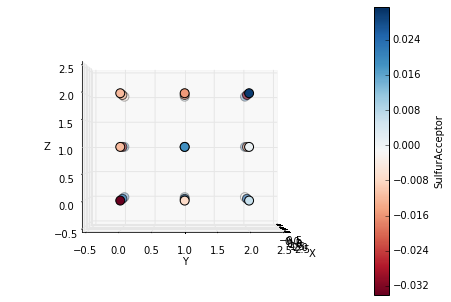

Filter 9 element Iodine


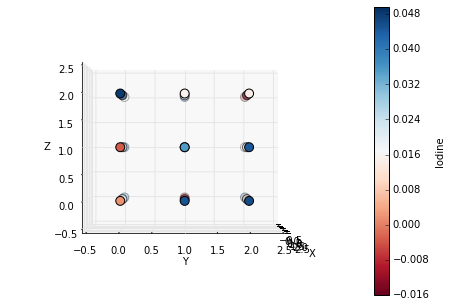

Filter 9 element Boron


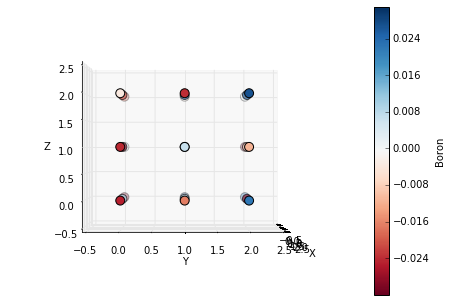

Filter 10 element AliphaticCarbonXSHydrophobe


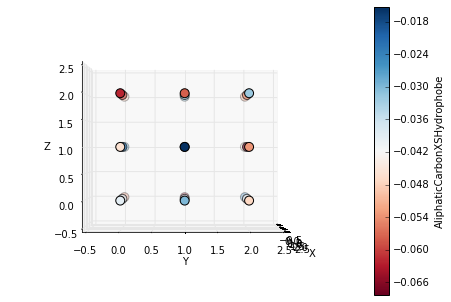

Filter 10 element AliphaticCarbonXSNonHydrophobe


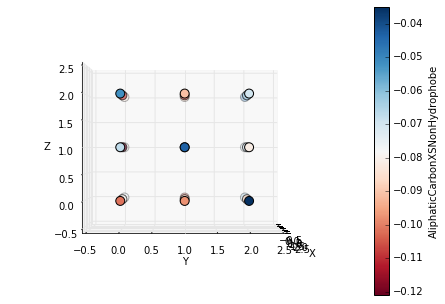

Filter 10 element AromaticCarbonXSHydrophobe


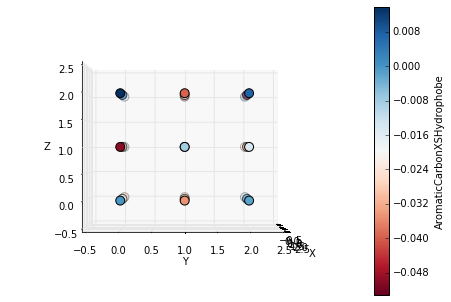

Filter 10 element AromaticCarbonXSNonHydrophobe


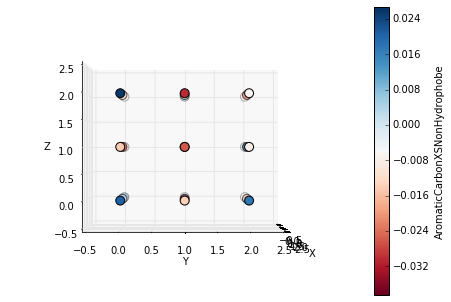

Filter 10 element Calcium


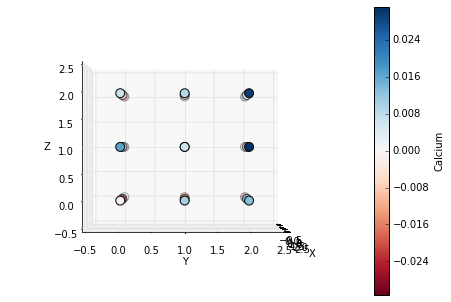

Filter 10 element Iron


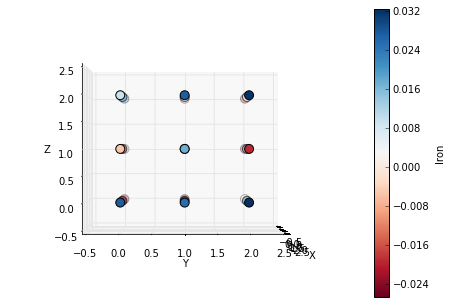

Filter 10 element Magnesium


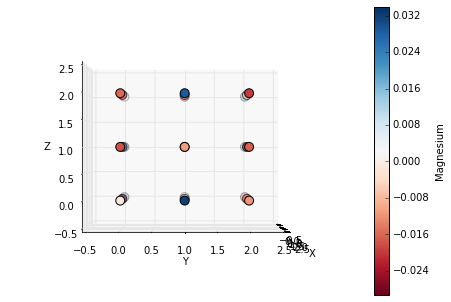

Filter 10 element Nitrogen


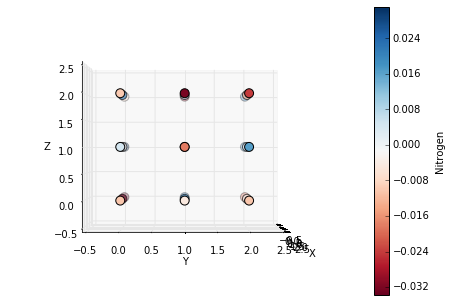

Filter 10 element NitrogenXSAcceptor


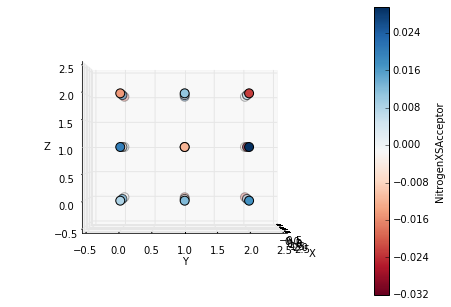

Filter 10 element NitrogenXSDonor


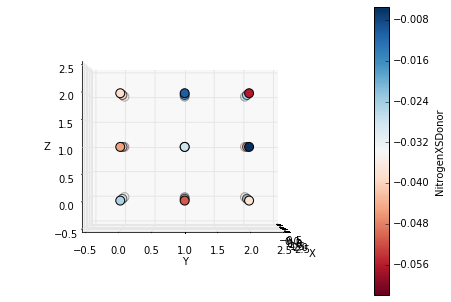

Filter 10 element NitrogenXSDonorAcceptor


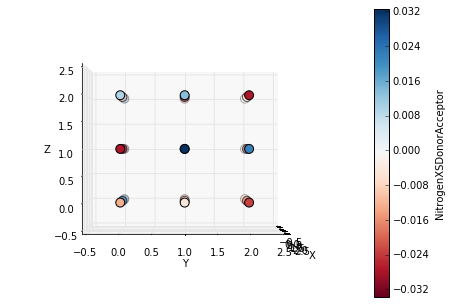

Filter 10 element OxygenXSAcceptor


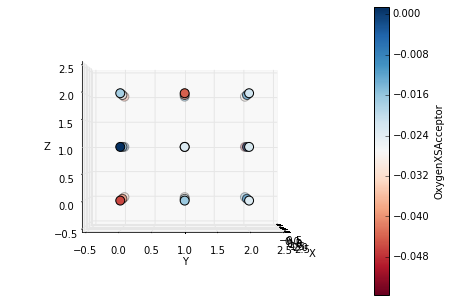

Filter 10 element OxygenXSDonorAcceptor


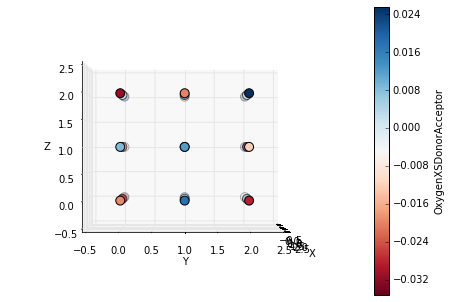

Filter 10 element Phosphorus


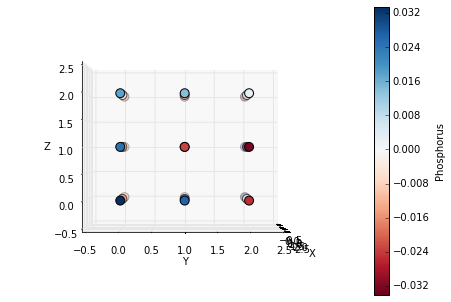

Filter 10 element Sulfur


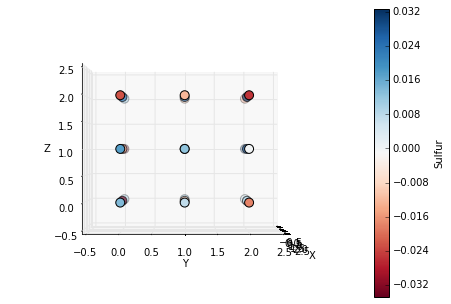

Filter 10 element Zinc


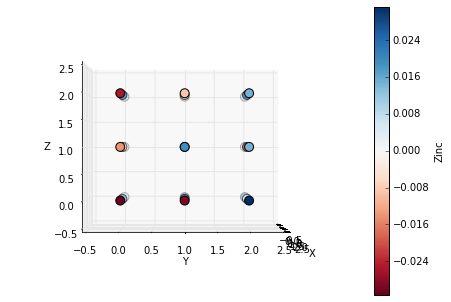

Filter 10 element AliphaticCarbonXSHydrophobe


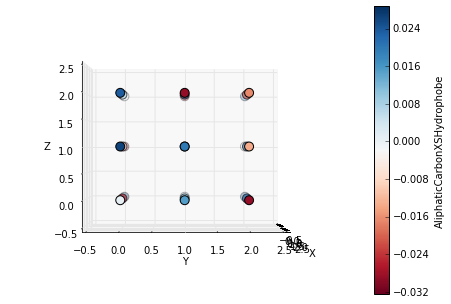

Filter 10 element AliphaticCarbonXSNonHydrophobe


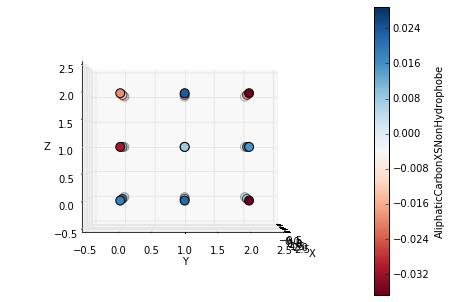

Filter 10 element AromaticCarbonXSHydrophobe


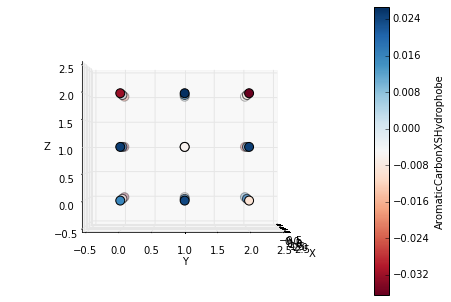

Filter 10 element AromaticCarbonXSNonHydrophobe


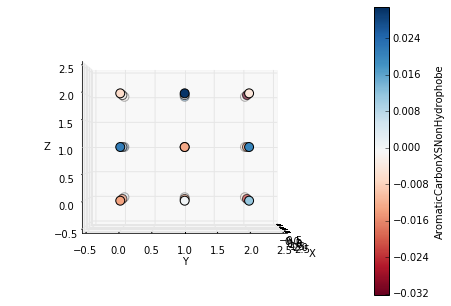

Filter 10 element Bromine


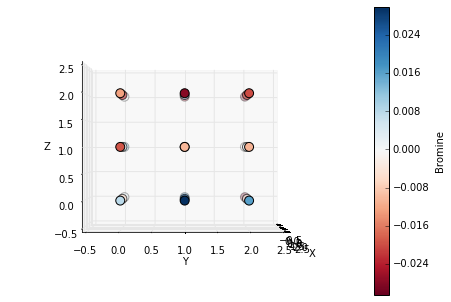

Filter 10 element Chlorine


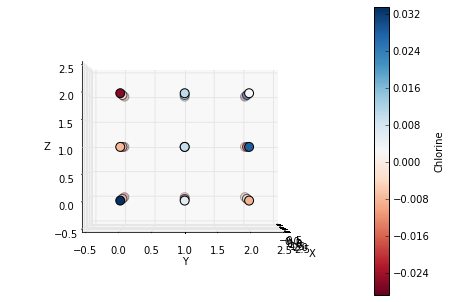

Filter 10 element Fluorine


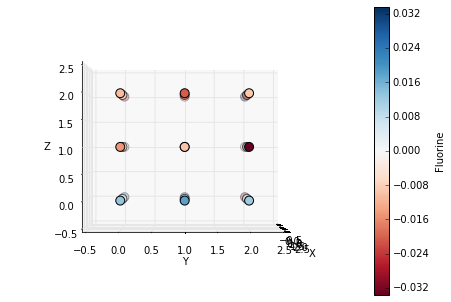

Filter 10 element Nitrogen


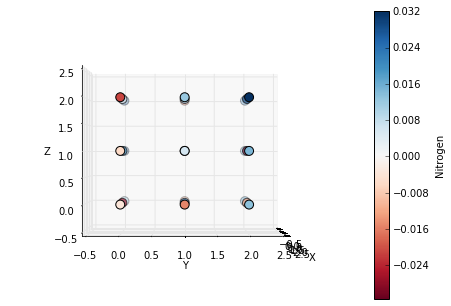

Filter 10 element NitrogenXSAcceptor


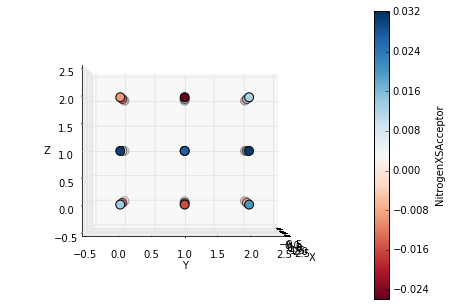

Filter 10 element NitrogenXSDonor


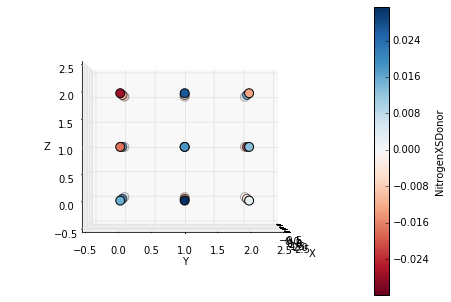

Filter 10 element NitrogenXSDonorAcceptor


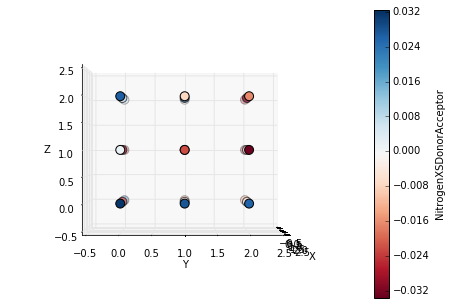

Filter 10 element Oxygen


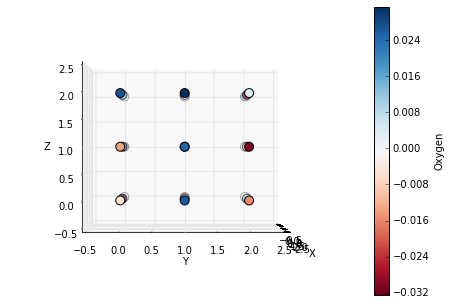

Filter 10 element OxygenXSAcceptor


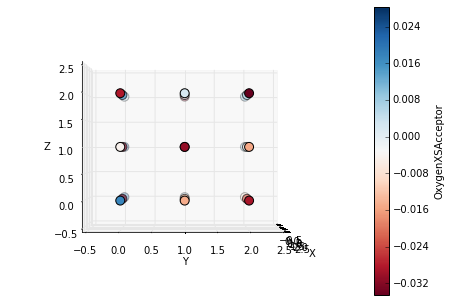

Filter 10 element OxygenXSDonorAcceptor


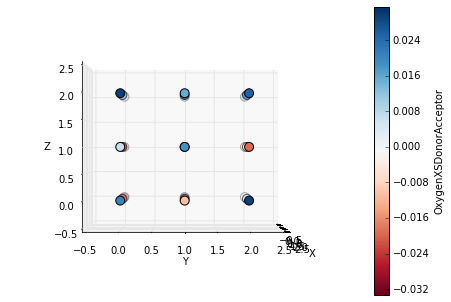

Filter 10 element Phosphorus


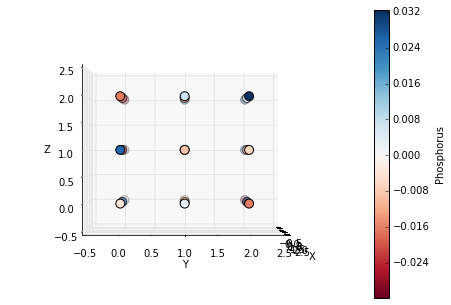

Filter 10 element Sulfur


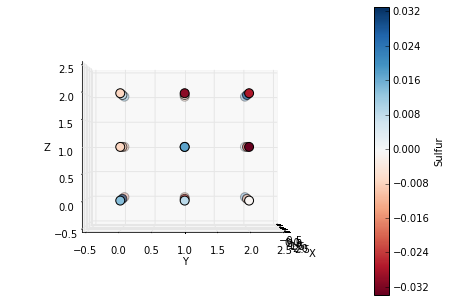

Filter 10 element SulfurAcceptor


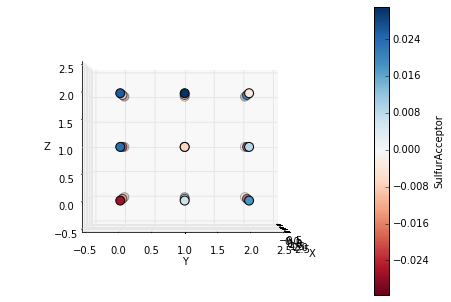

Filter 10 element Iodine


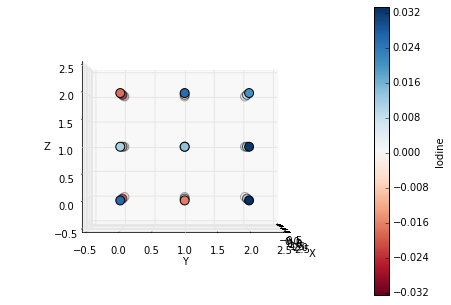

Filter 10 element Boron


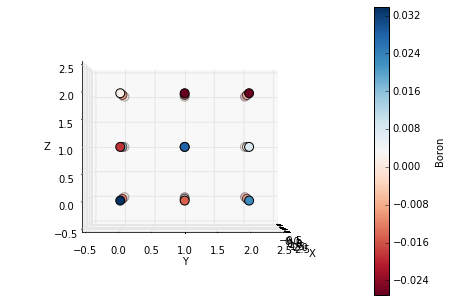

Filter 11 element AliphaticCarbonXSHydrophobe


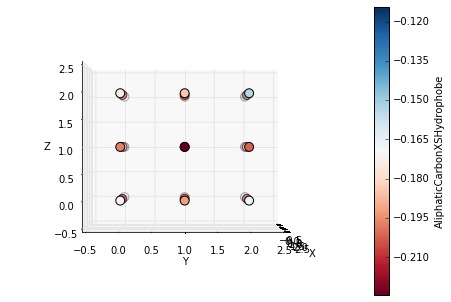

Filter 11 element AliphaticCarbonXSNonHydrophobe


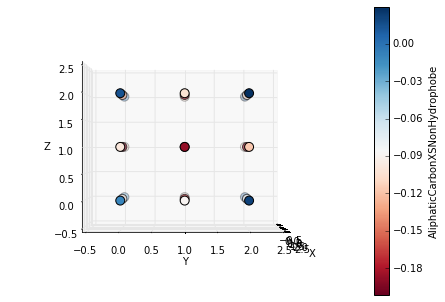

Filter 11 element AromaticCarbonXSHydrophobe


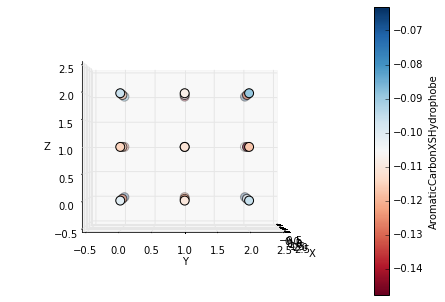

Filter 11 element AromaticCarbonXSNonHydrophobe


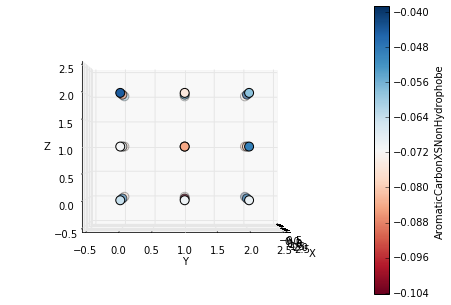

Filter 11 element Calcium


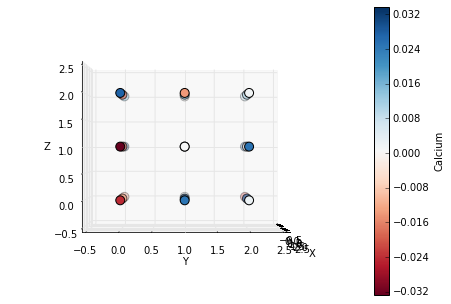

Filter 11 element Iron


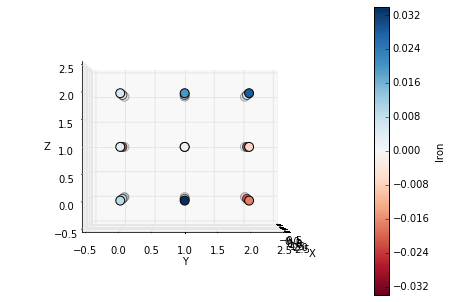

Filter 11 element Magnesium


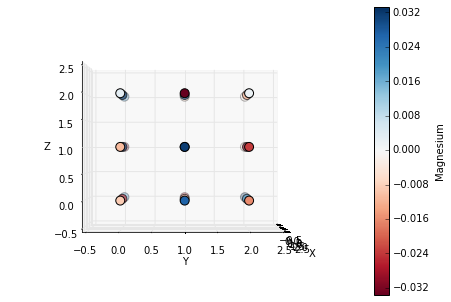

Filter 11 element Nitrogen


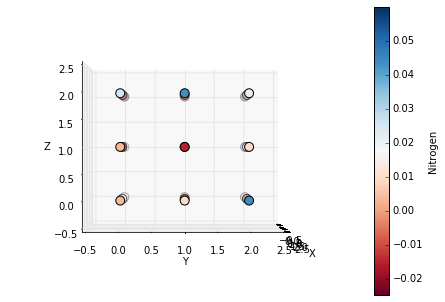

Filter 11 element NitrogenXSAcceptor


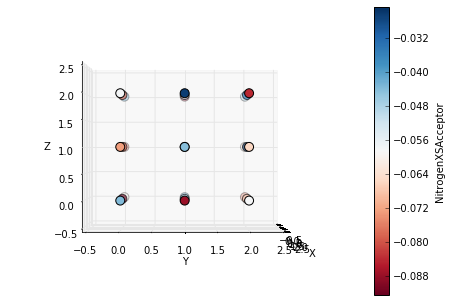

Filter 11 element NitrogenXSDonor


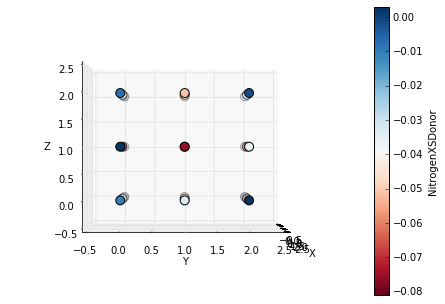

Filter 11 element NitrogenXSDonorAcceptor


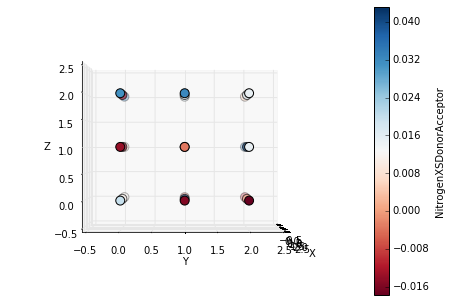

Filter 11 element OxygenXSAcceptor


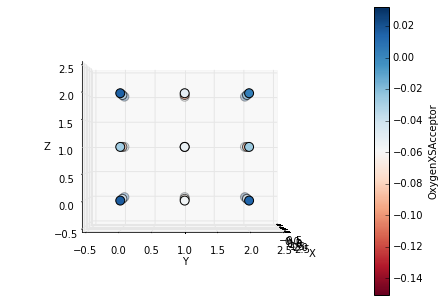

Filter 11 element OxygenXSDonorAcceptor


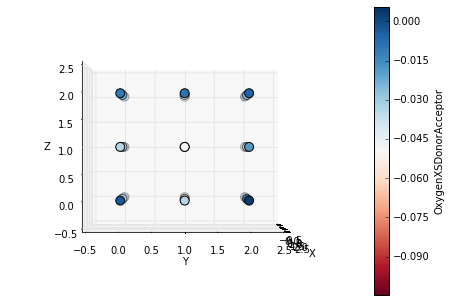

Filter 11 element Phosphorus


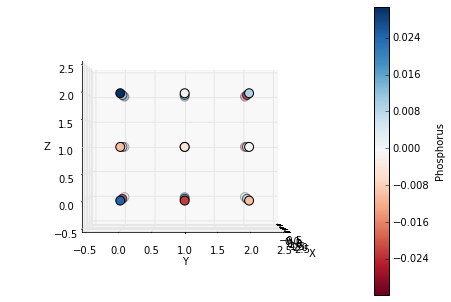

Filter 11 element Sulfur


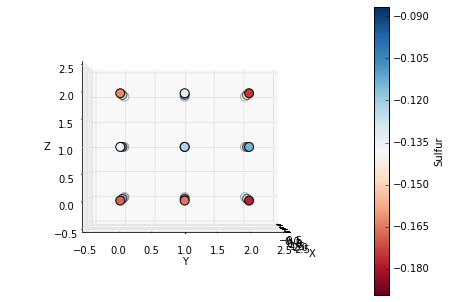

Filter 11 element Zinc


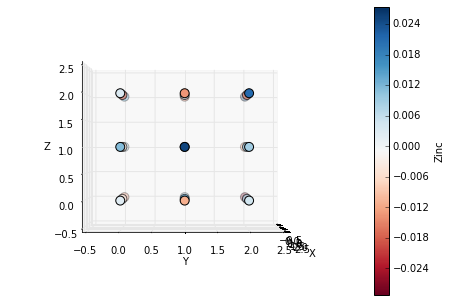

Filter 11 element AliphaticCarbonXSHydrophobe


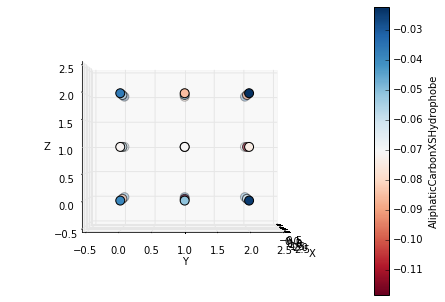

Filter 11 element AliphaticCarbonXSNonHydrophobe


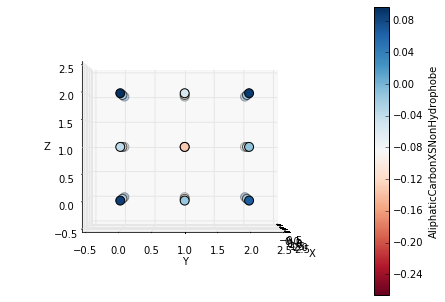

Filter 11 element AromaticCarbonXSHydrophobe


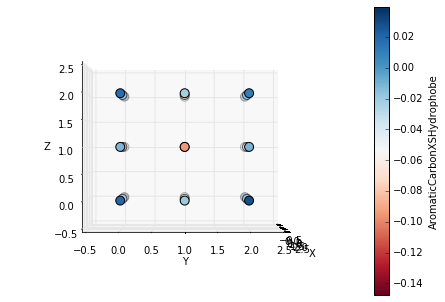

Filter 11 element AromaticCarbonXSNonHydrophobe


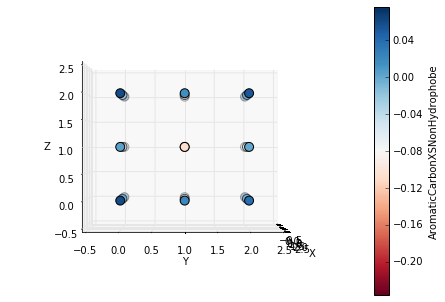

Filter 11 element Bromine


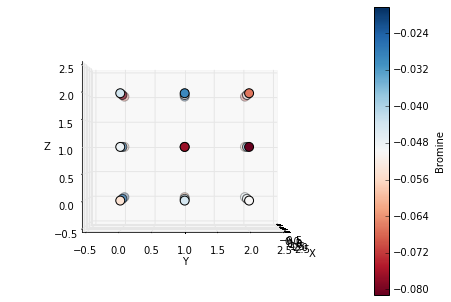

Filter 11 element Chlorine


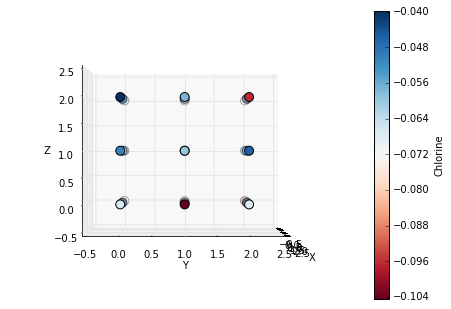

Filter 11 element Fluorine


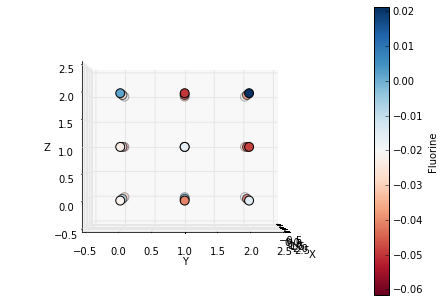

Filter 11 element Nitrogen


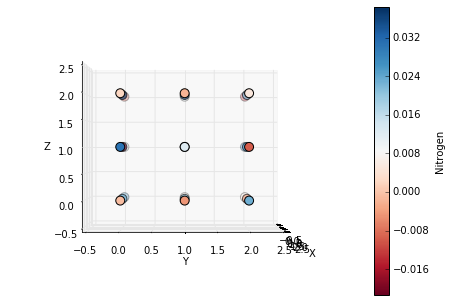

Filter 11 element NitrogenXSAcceptor


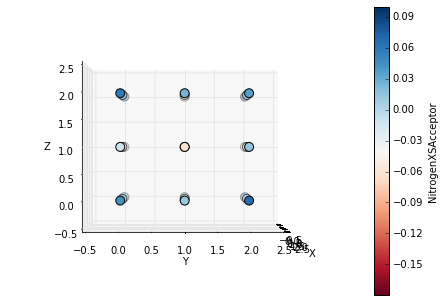

Filter 11 element NitrogenXSDonor


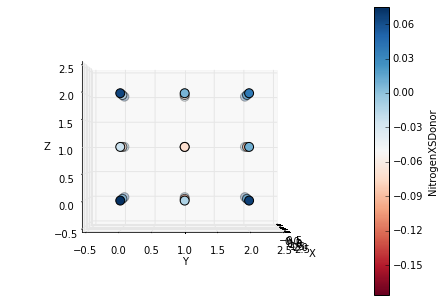

Filter 11 element NitrogenXSDonorAcceptor


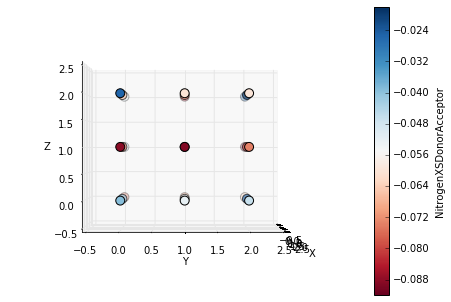

Filter 11 element Oxygen


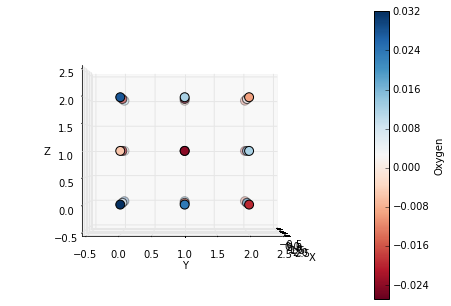

Filter 11 element OxygenXSAcceptor


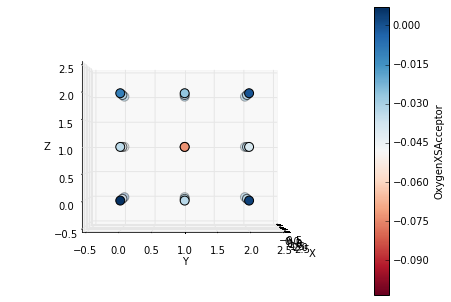

Filter 11 element OxygenXSDonorAcceptor


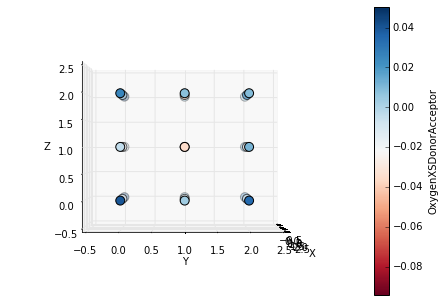

Filter 11 element Phosphorus


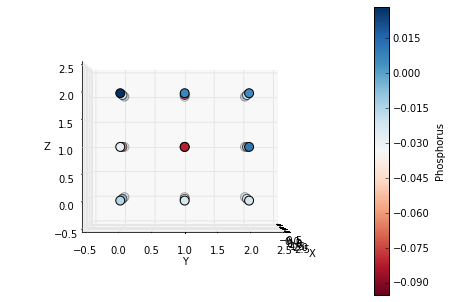

Filter 11 element Sulfur


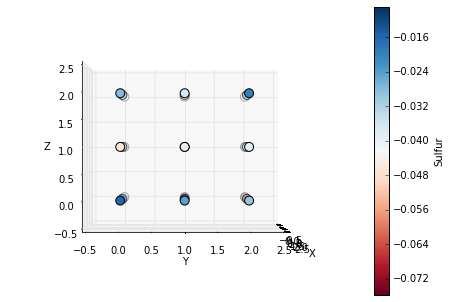

Filter 11 element SulfurAcceptor


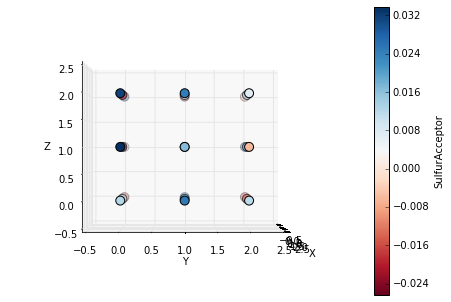

Filter 11 element Iodine


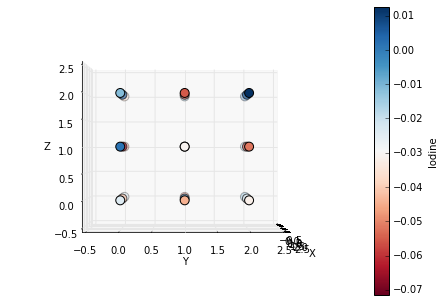

Filter 11 element Boron


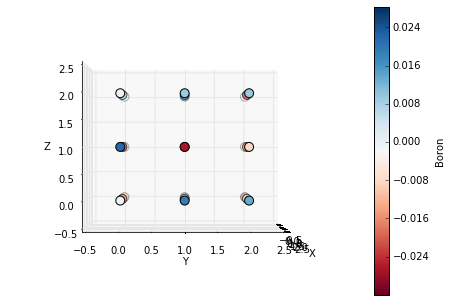

Filter 12 element AliphaticCarbonXSHydrophobe


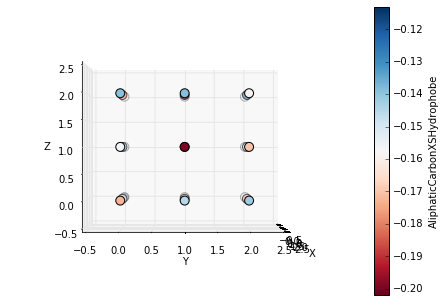

Filter 12 element AliphaticCarbonXSNonHydrophobe


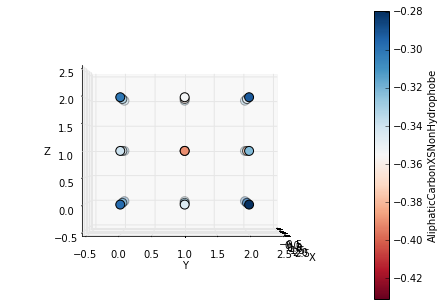

Filter 12 element AromaticCarbonXSHydrophobe


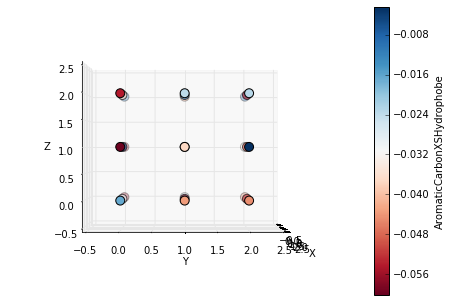

Filter 12 element AromaticCarbonXSNonHydrophobe


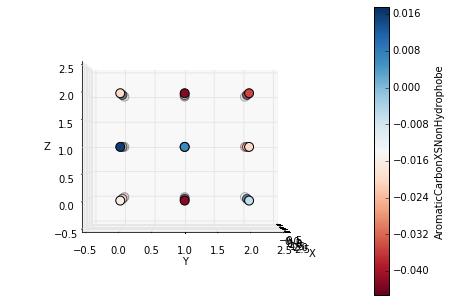

Filter 12 element Calcium


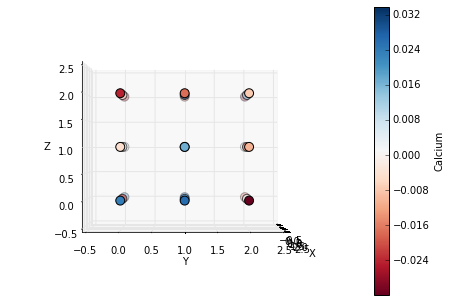

Filter 12 element Iron


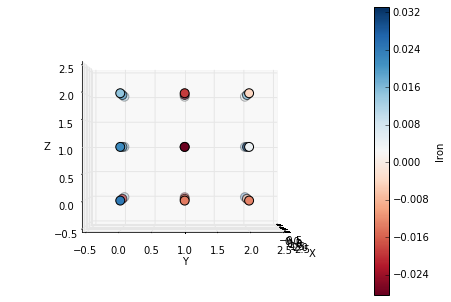

Filter 12 element Magnesium


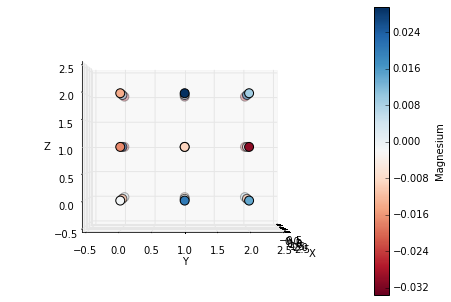

Filter 12 element Nitrogen


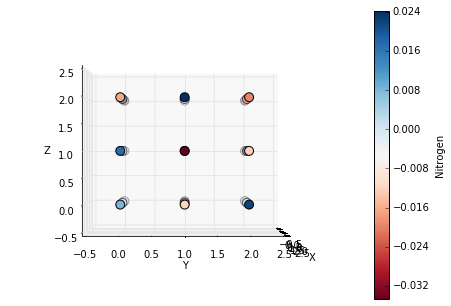

Filter 12 element NitrogenXSAcceptor


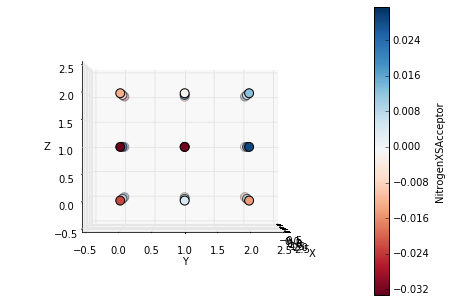

Filter 12 element NitrogenXSDonor


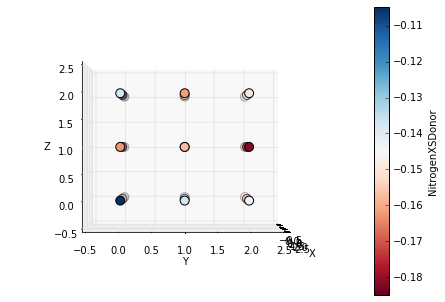

Filter 12 element NitrogenXSDonorAcceptor


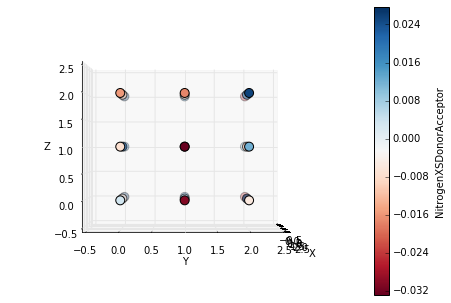

Filter 12 element OxygenXSAcceptor


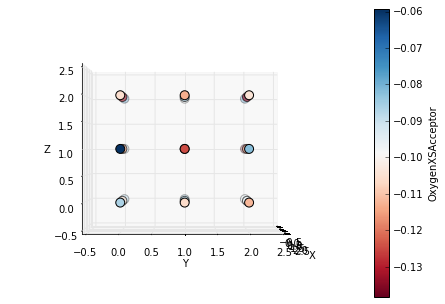

Filter 12 element OxygenXSDonorAcceptor


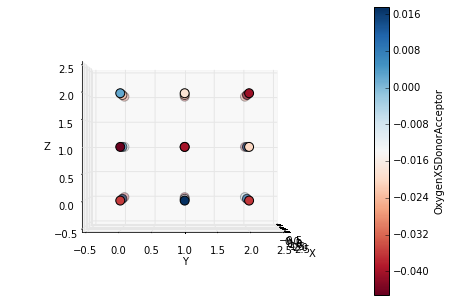

Filter 12 element Phosphorus


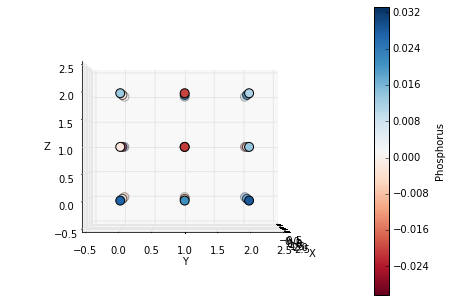

Filter 12 element Sulfur


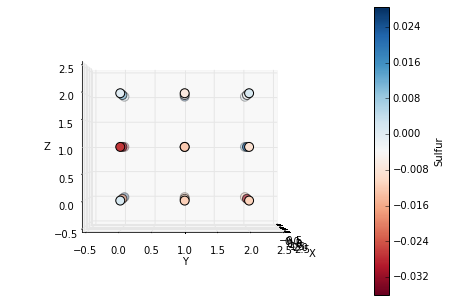

Filter 12 element Zinc


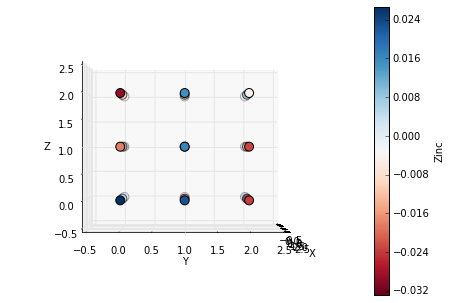

Filter 12 element AliphaticCarbonXSHydrophobe


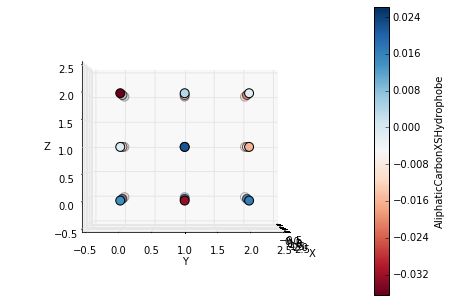

Filter 12 element AliphaticCarbonXSNonHydrophobe


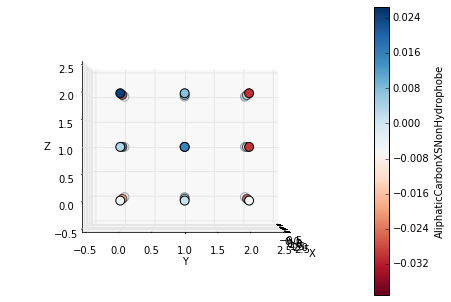

Filter 12 element AromaticCarbonXSHydrophobe


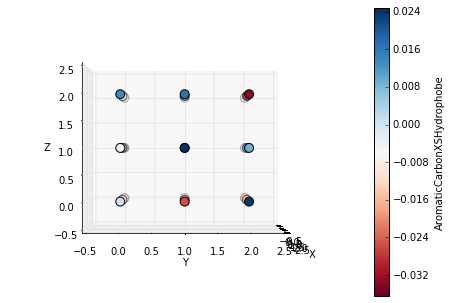

Filter 12 element AromaticCarbonXSNonHydrophobe


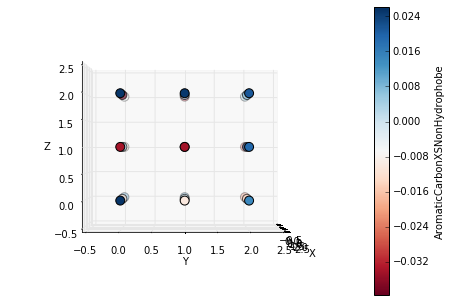

Filter 12 element Bromine


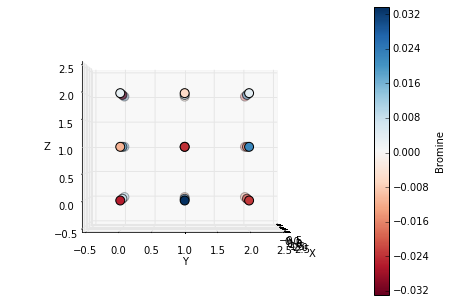

Filter 12 element Chlorine


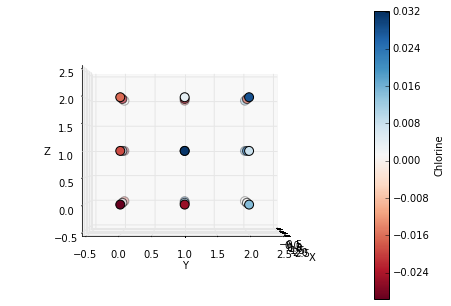

Filter 12 element Fluorine


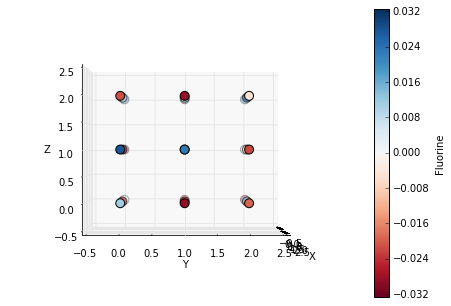

Filter 12 element Nitrogen


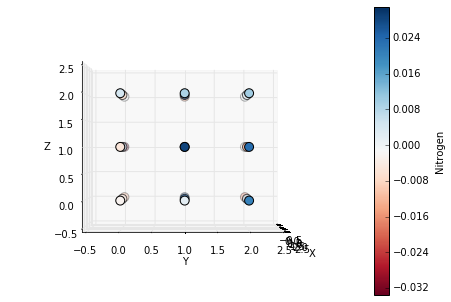

Filter 12 element NitrogenXSAcceptor


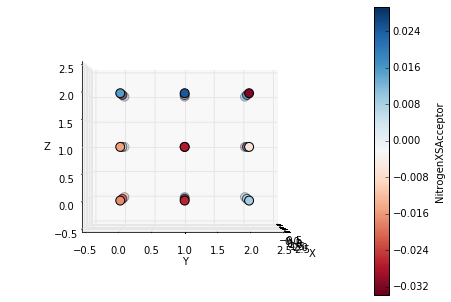

Filter 12 element NitrogenXSDonor


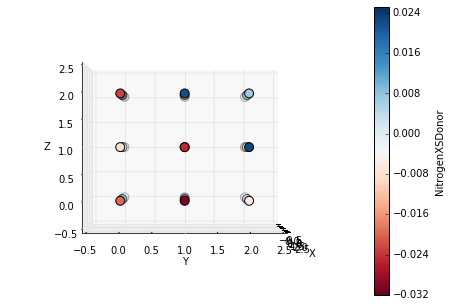

Filter 12 element NitrogenXSDonorAcceptor


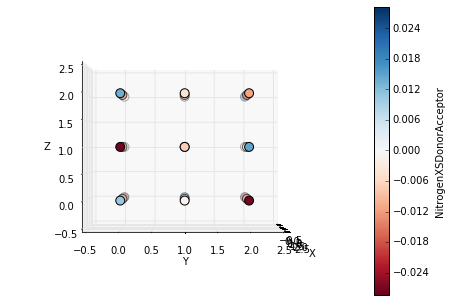

Filter 12 element Oxygen


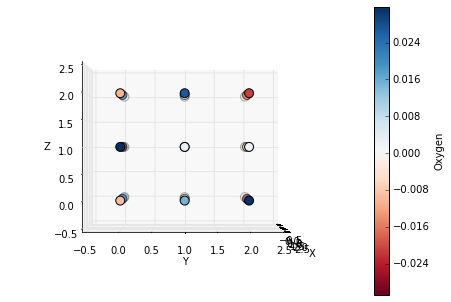

Filter 12 element OxygenXSAcceptor


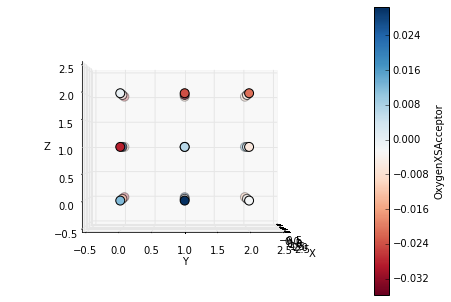

Filter 12 element OxygenXSDonorAcceptor


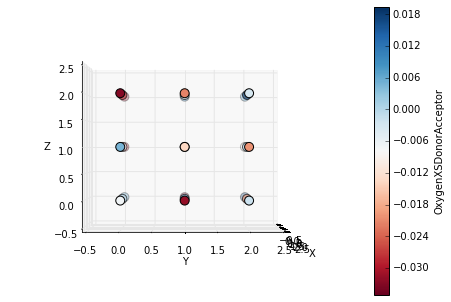

Filter 12 element Phosphorus


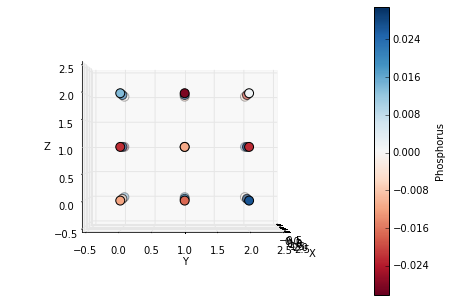

Filter 12 element Sulfur


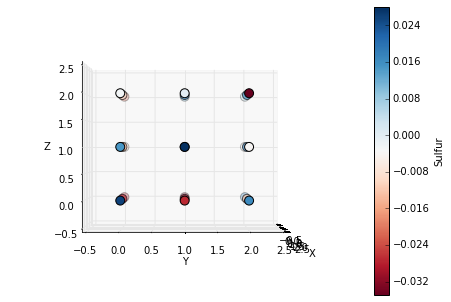

Filter 12 element SulfurAcceptor


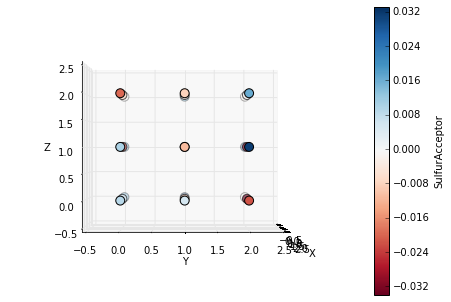

Filter 12 element Iodine


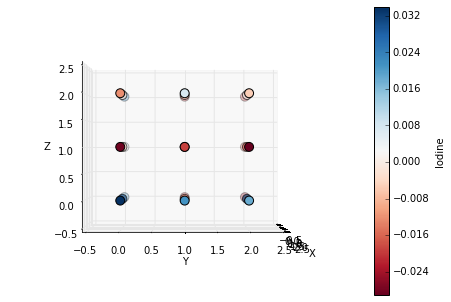

Filter 12 element Boron


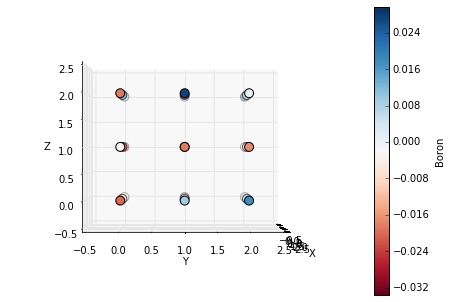

Filter 13 element AliphaticCarbonXSHydrophobe


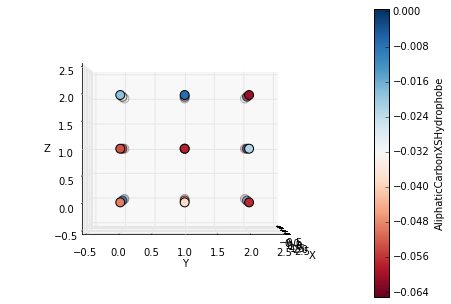

Filter 13 element AliphaticCarbonXSNonHydrophobe


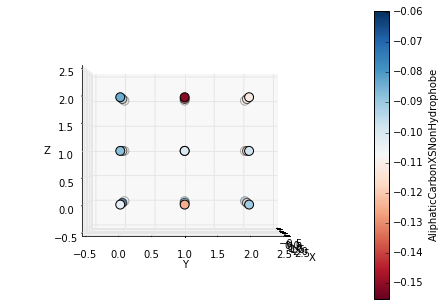

Filter 13 element AromaticCarbonXSHydrophobe


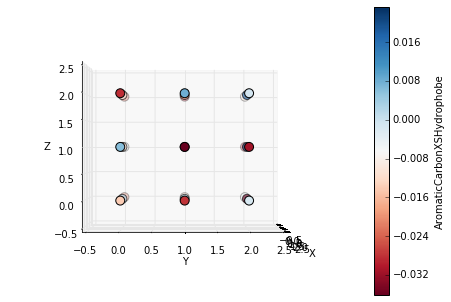

Filter 13 element AromaticCarbonXSNonHydrophobe


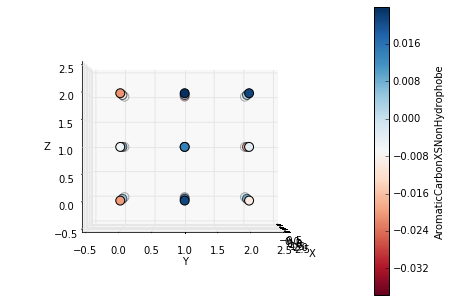

Filter 13 element Calcium


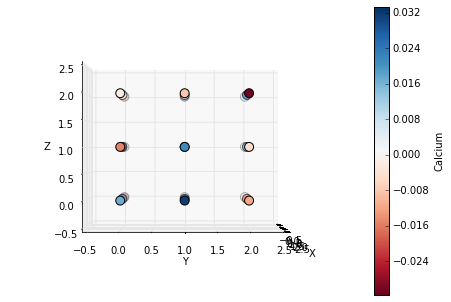

Filter 13 element Iron


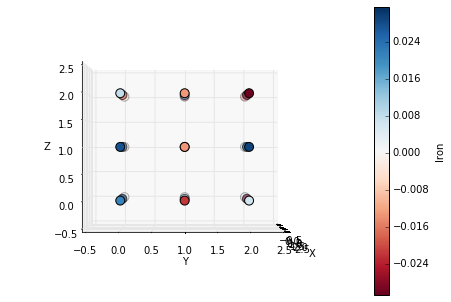

Filter 13 element Magnesium


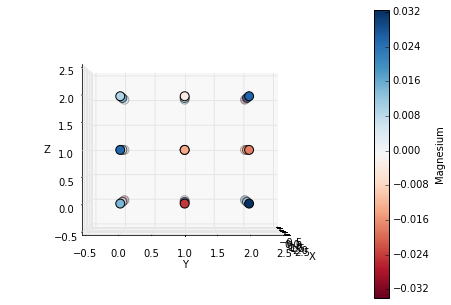

Filter 13 element Nitrogen


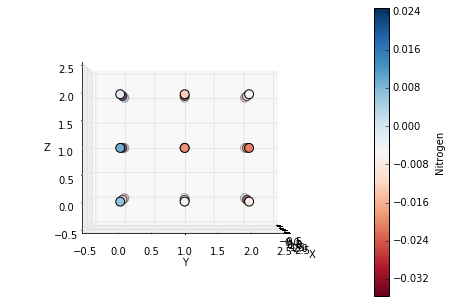

Filter 13 element NitrogenXSAcceptor


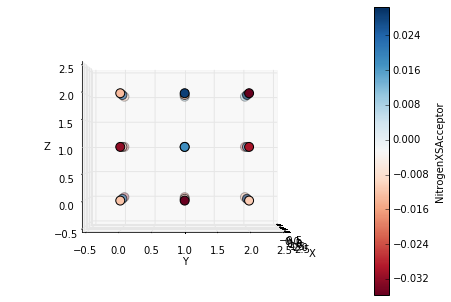

Filter 13 element NitrogenXSDonor


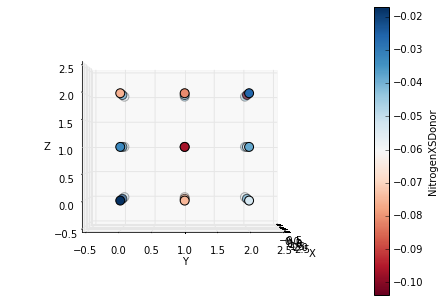

Filter 13 element NitrogenXSDonorAcceptor


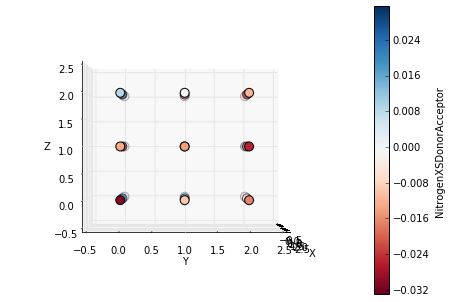

Filter 13 element OxygenXSAcceptor


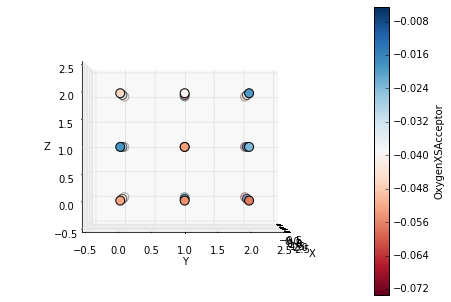

Filter 13 element OxygenXSDonorAcceptor


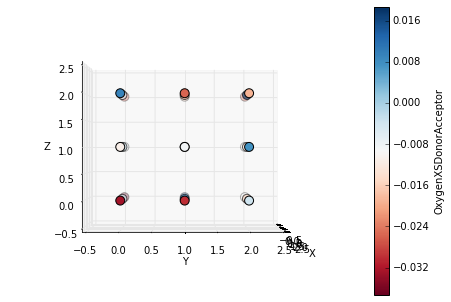

Filter 13 element Phosphorus


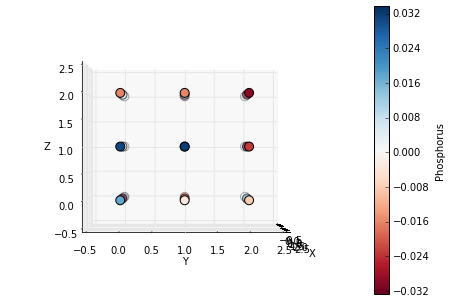

Filter 13 element Sulfur


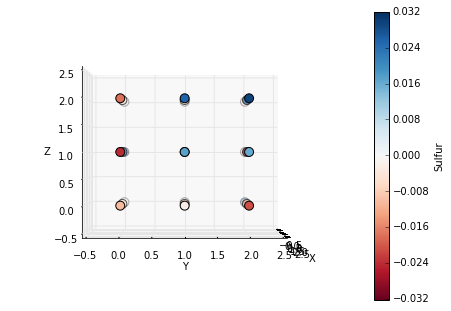

Filter 13 element Zinc


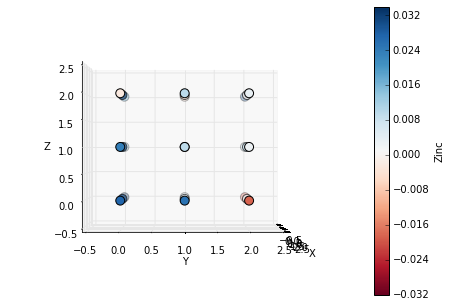

Filter 13 element AliphaticCarbonXSHydrophobe


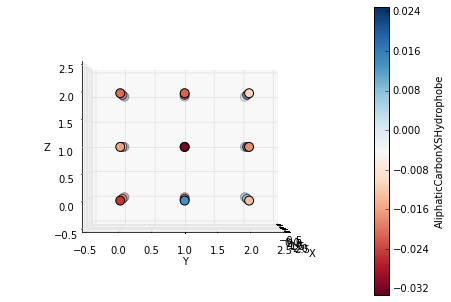

Filter 13 element AliphaticCarbonXSNonHydrophobe


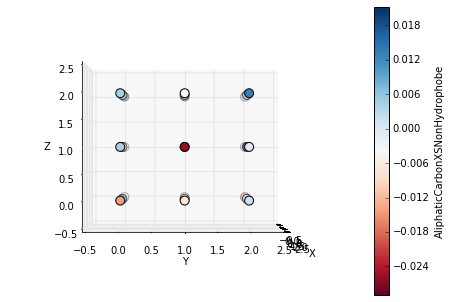

Filter 13 element AromaticCarbonXSHydrophobe


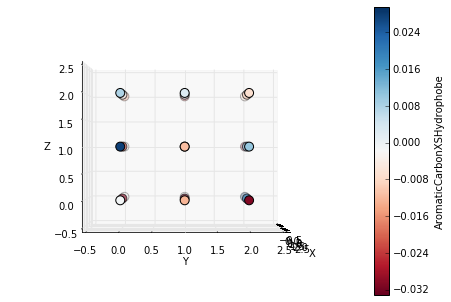

Filter 13 element AromaticCarbonXSNonHydrophobe


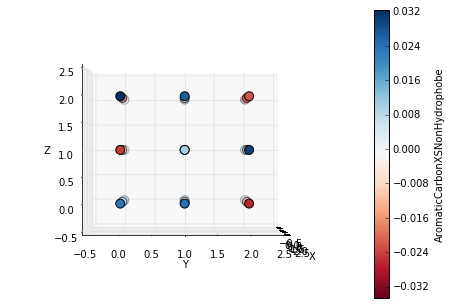

Filter 13 element Bromine


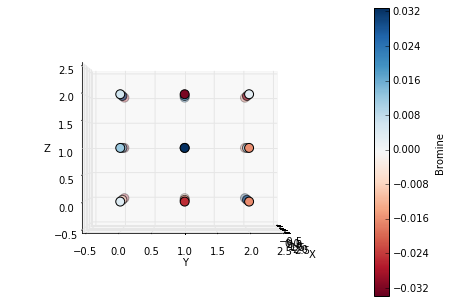

Filter 13 element Chlorine


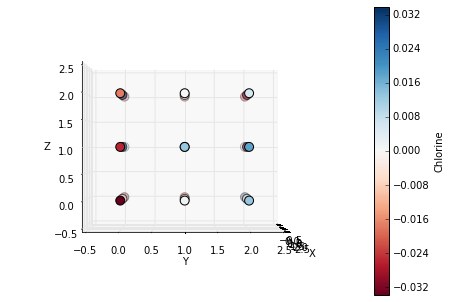

Filter 13 element Fluorine


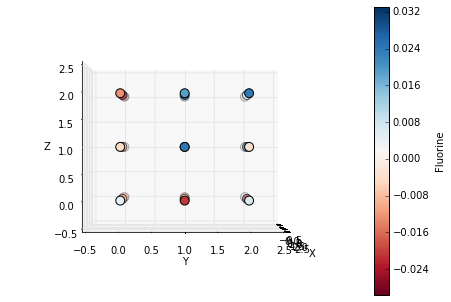

Filter 13 element Nitrogen


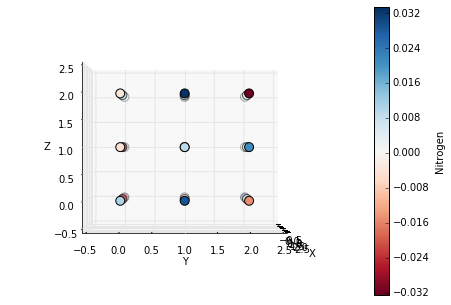

Filter 13 element NitrogenXSAcceptor


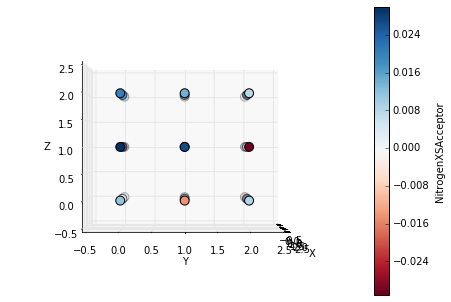

Filter 13 element NitrogenXSDonor


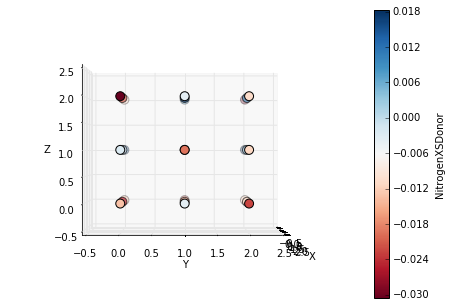

Filter 13 element NitrogenXSDonorAcceptor


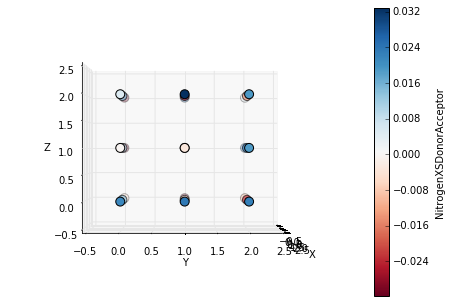

Filter 13 element Oxygen


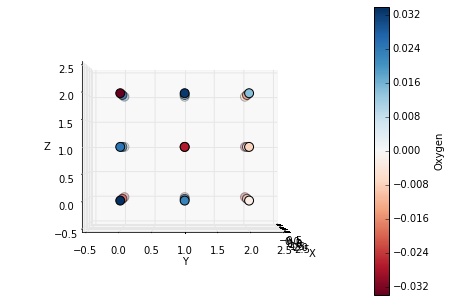

Filter 13 element OxygenXSAcceptor


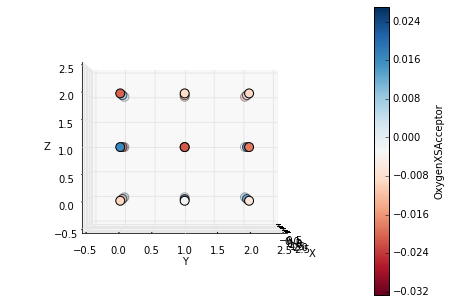

Filter 13 element OxygenXSDonorAcceptor


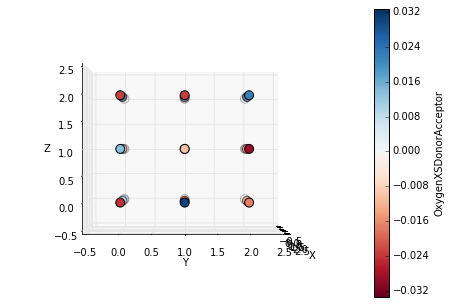

Filter 13 element Phosphorus


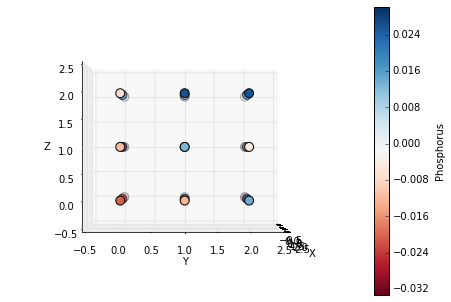

Filter 13 element Sulfur


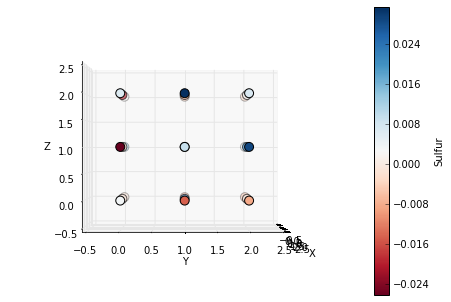

Filter 13 element SulfurAcceptor


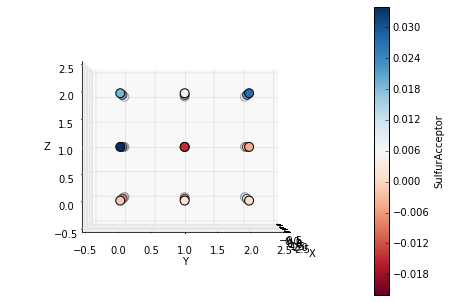

Filter 13 element Iodine


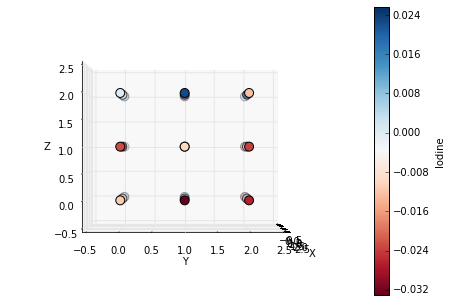

Filter 13 element Boron


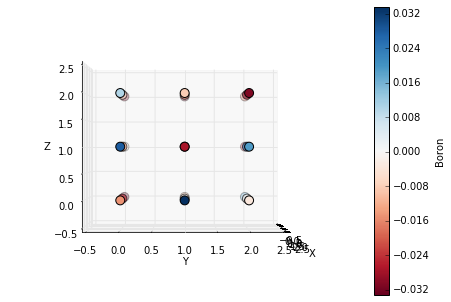

Filter 14 element AliphaticCarbonXSHydrophobe


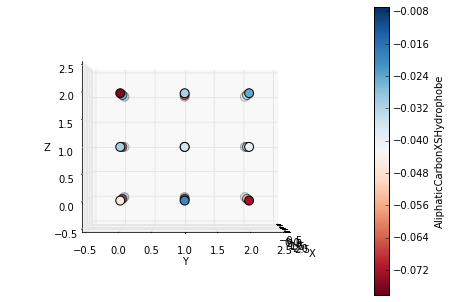

Filter 14 element AliphaticCarbonXSNonHydrophobe


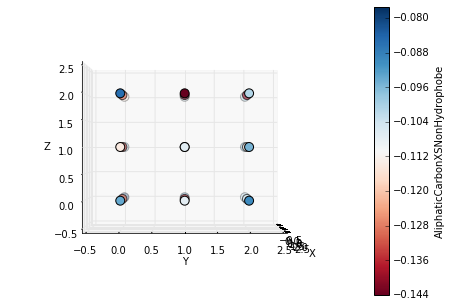

Filter 14 element AromaticCarbonXSHydrophobe


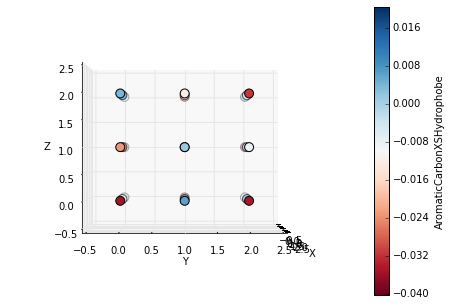

Filter 14 element AromaticCarbonXSNonHydrophobe


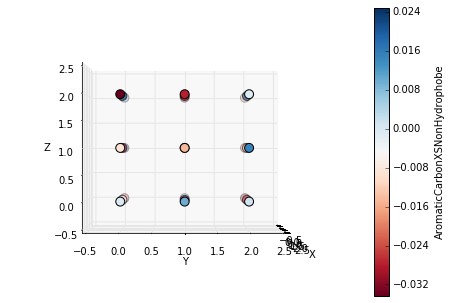

Filter 14 element Calcium


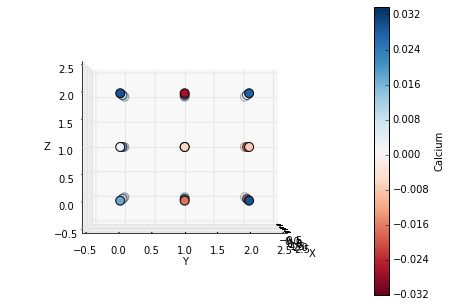

Filter 14 element Iron


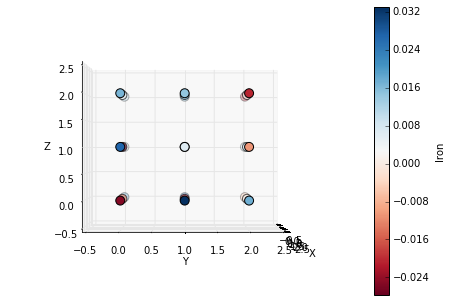

Filter 14 element Magnesium


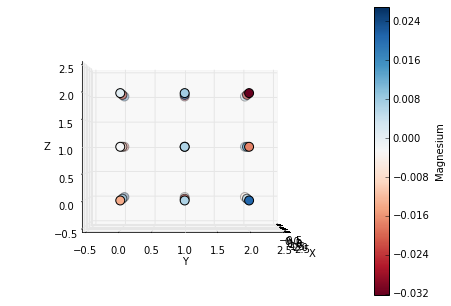

Filter 14 element Nitrogen


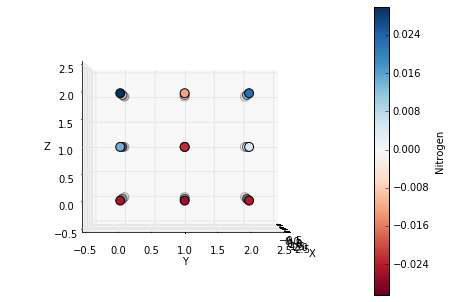

Filter 14 element NitrogenXSAcceptor


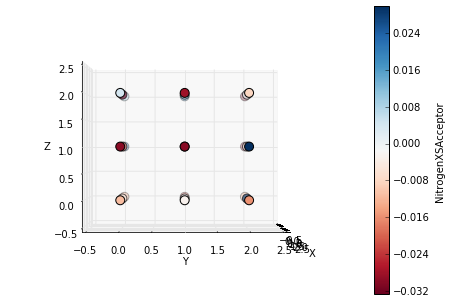

Filter 14 element NitrogenXSDonor


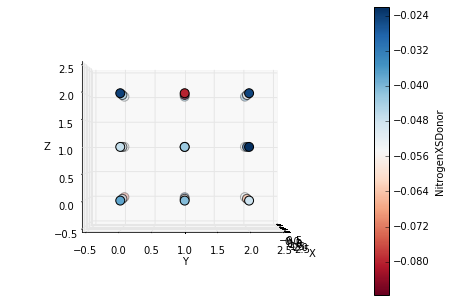

Filter 14 element NitrogenXSDonorAcceptor


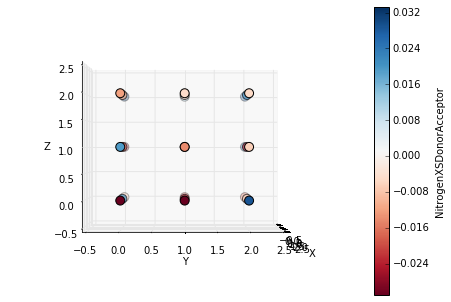

Filter 14 element OxygenXSAcceptor


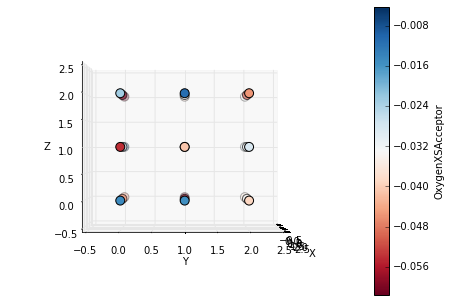

Filter 14 element OxygenXSDonorAcceptor


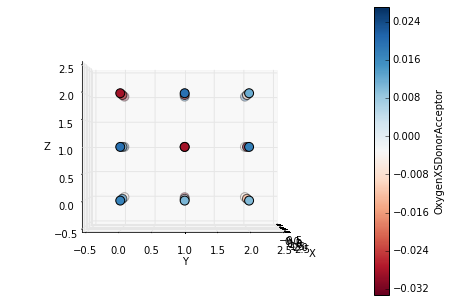

Filter 14 element Phosphorus


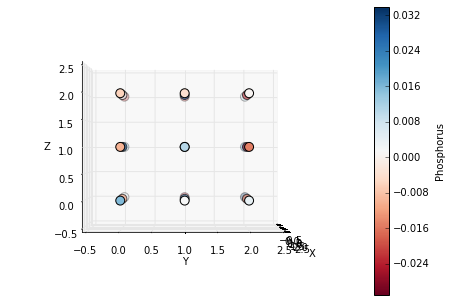

Filter 14 element Sulfur


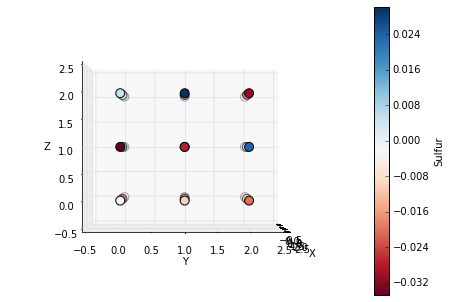

Filter 14 element Zinc


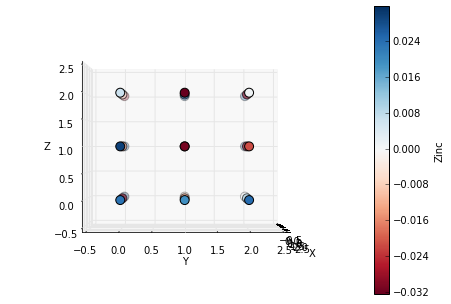

Filter 14 element AliphaticCarbonXSHydrophobe


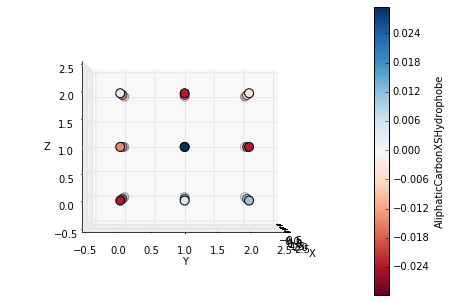

Filter 14 element AliphaticCarbonXSNonHydrophobe


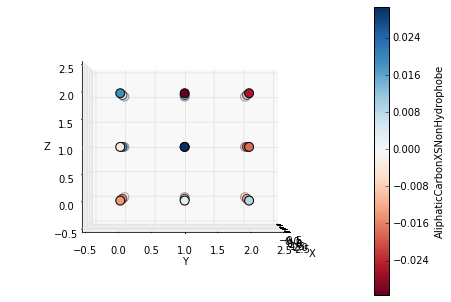

Filter 14 element AromaticCarbonXSHydrophobe


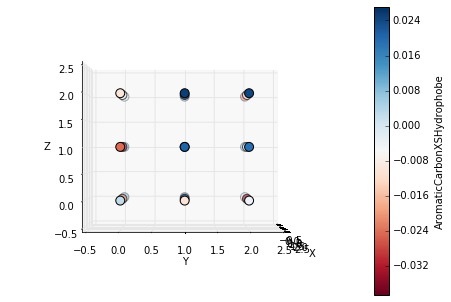

Filter 14 element AromaticCarbonXSNonHydrophobe


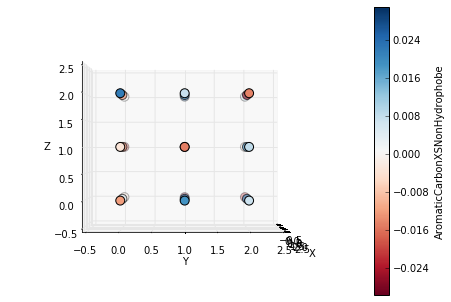

Filter 14 element Bromine


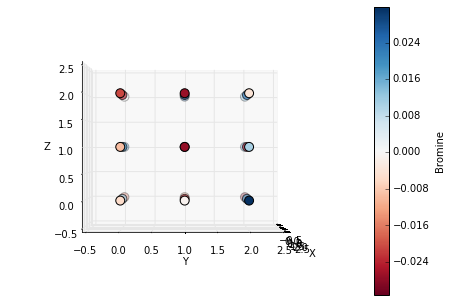

Filter 14 element Chlorine


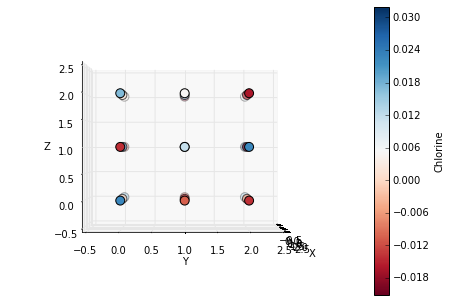

Filter 14 element Fluorine


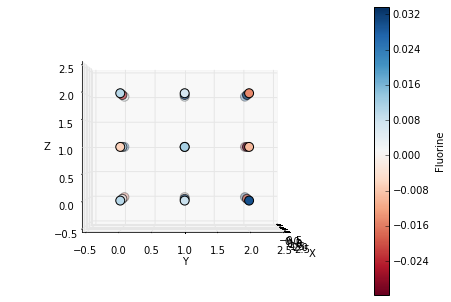

Filter 14 element Nitrogen


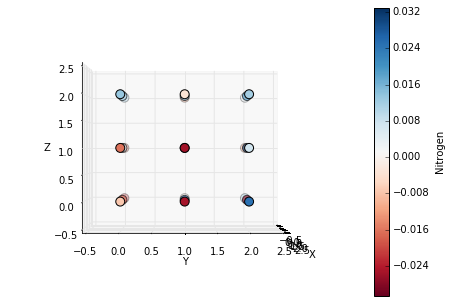

Filter 14 element NitrogenXSAcceptor


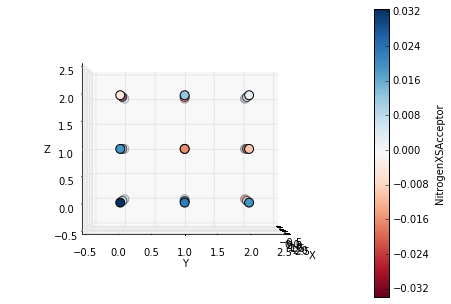

Filter 14 element NitrogenXSDonor


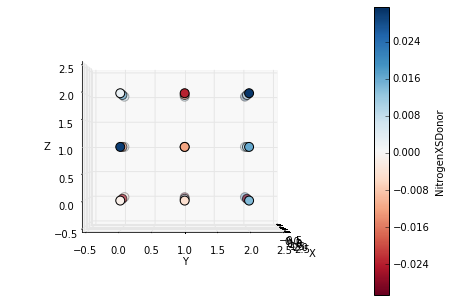

Filter 14 element NitrogenXSDonorAcceptor


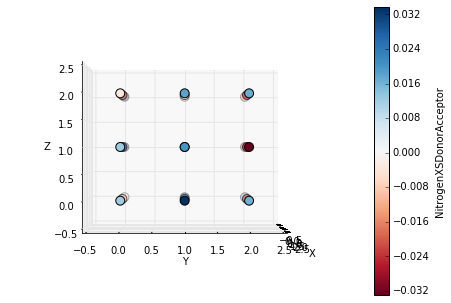

Filter 14 element Oxygen


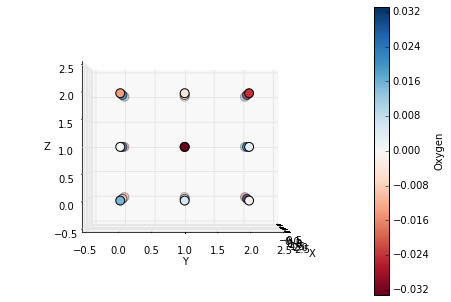

Filter 14 element OxygenXSAcceptor


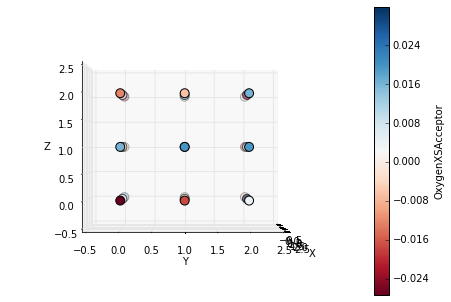

Filter 14 element OxygenXSDonorAcceptor


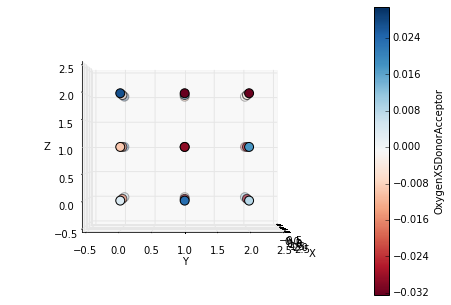

Filter 14 element Phosphorus


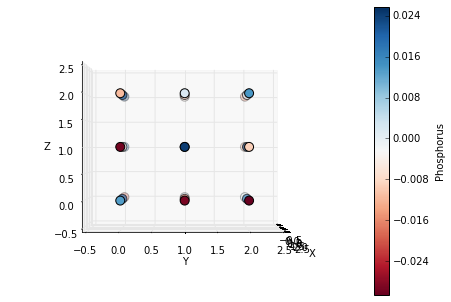

Filter 14 element Sulfur


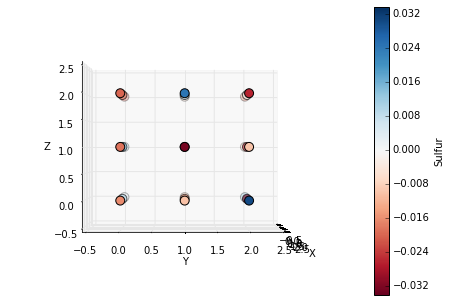

Filter 14 element SulfurAcceptor


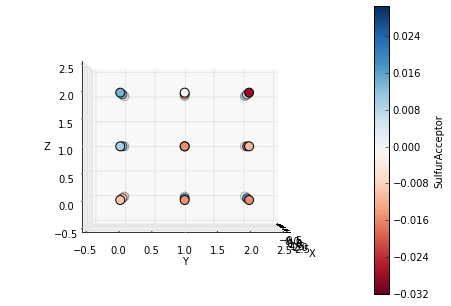

Filter 14 element Iodine


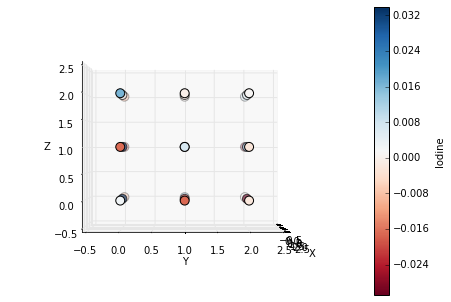

Filter 14 element Boron


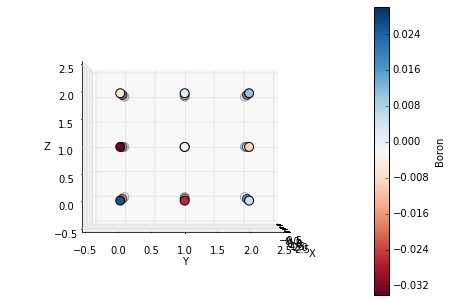

Filter 15 element AliphaticCarbonXSHydrophobe


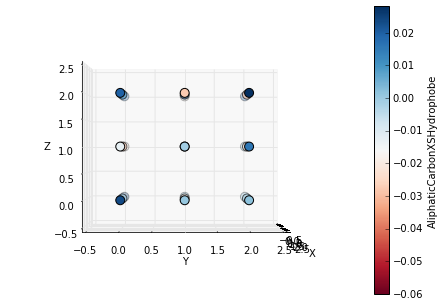

Filter 15 element AliphaticCarbonXSNonHydrophobe


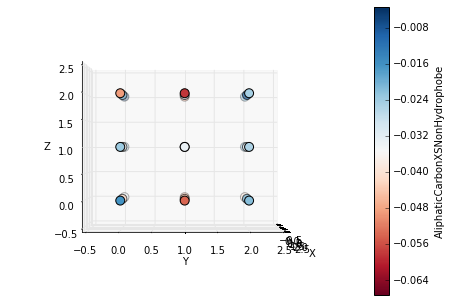

Filter 15 element AromaticCarbonXSHydrophobe


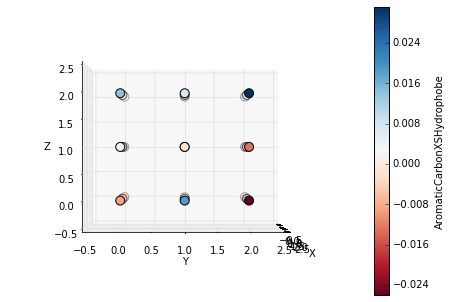

Filter 15 element AromaticCarbonXSNonHydrophobe


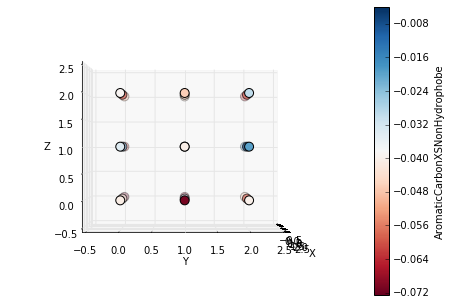

Filter 15 element Calcium


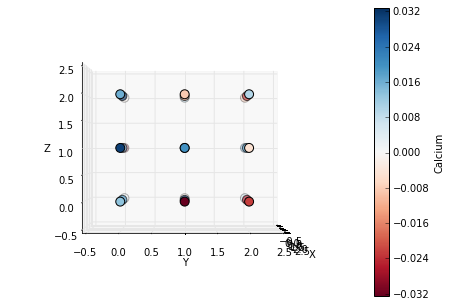

Filter 15 element Iron


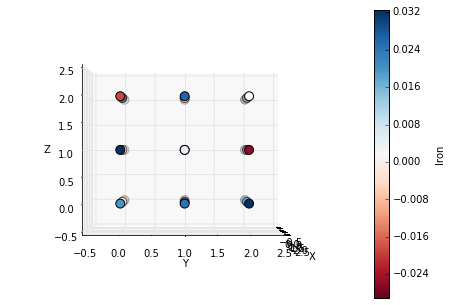

Filter 15 element Magnesium


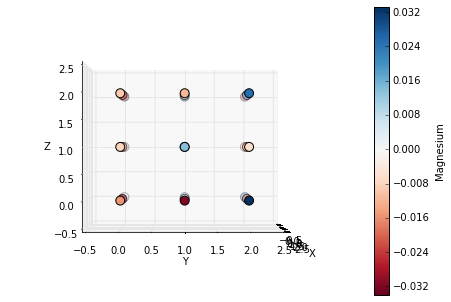

Filter 15 element Nitrogen


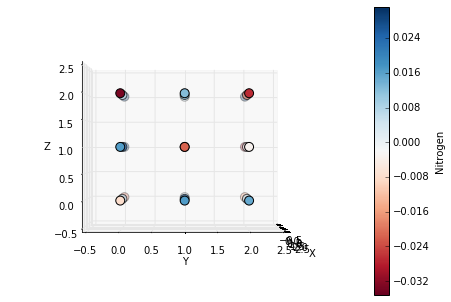

Filter 15 element NitrogenXSAcceptor


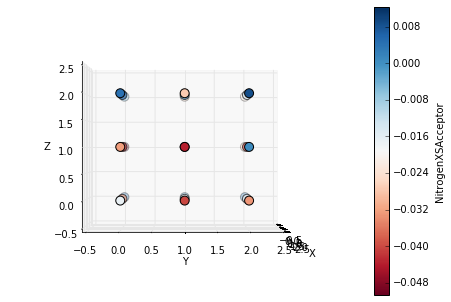

Filter 15 element NitrogenXSDonor


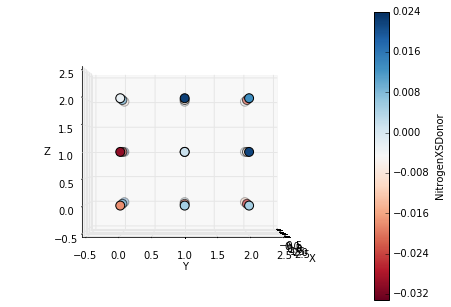

Filter 15 element NitrogenXSDonorAcceptor


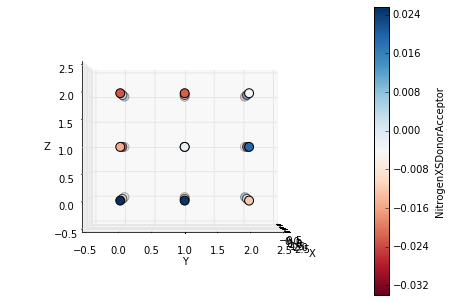

Filter 15 element OxygenXSAcceptor


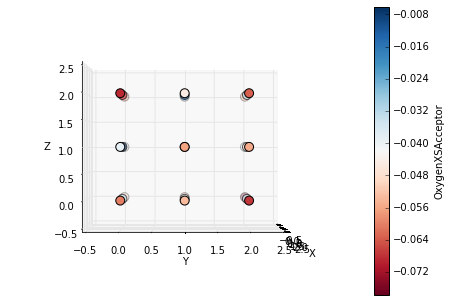

Filter 15 element OxygenXSDonorAcceptor


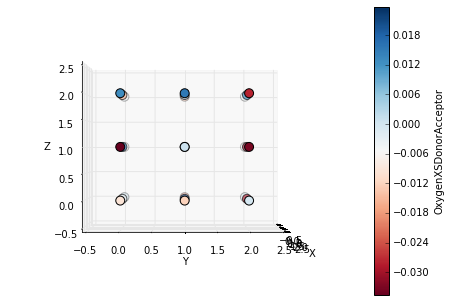

Filter 15 element Phosphorus


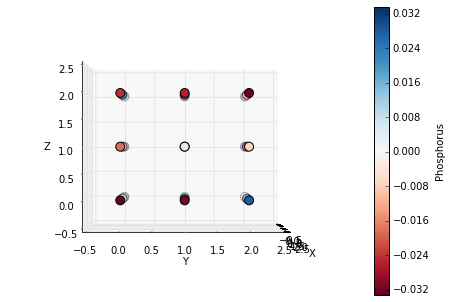

Filter 15 element Sulfur


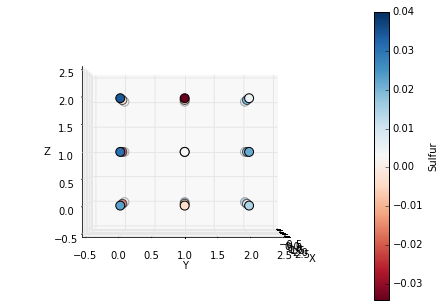

Filter 15 element Zinc


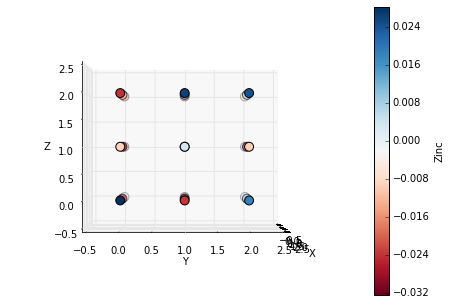

Filter 15 element AliphaticCarbonXSHydrophobe


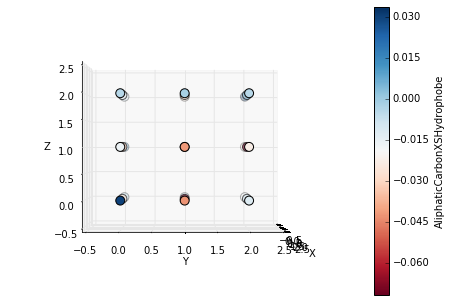

Filter 15 element AliphaticCarbonXSNonHydrophobe


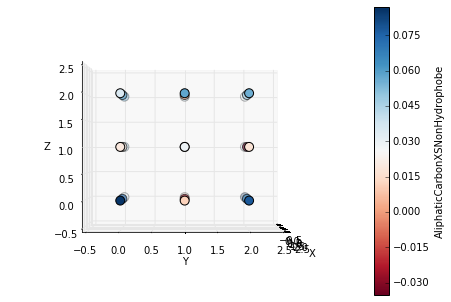

Filter 15 element AromaticCarbonXSHydrophobe


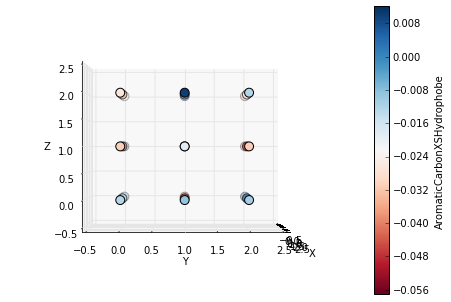

Filter 15 element AromaticCarbonXSNonHydrophobe


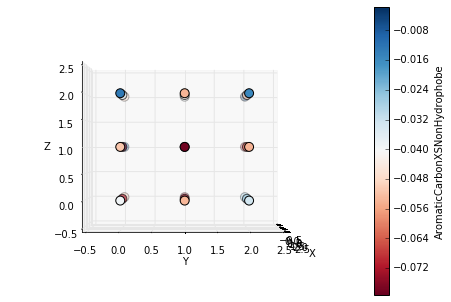

Filter 15 element Bromine


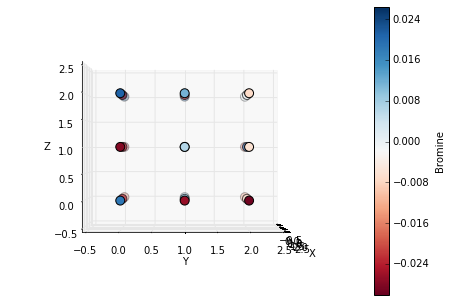

Filter 15 element Chlorine


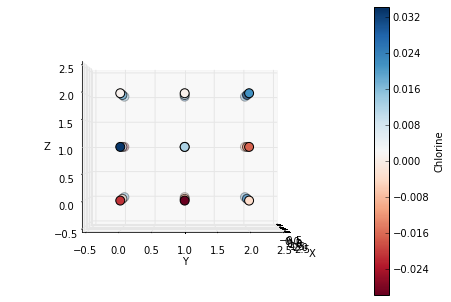

Filter 15 element Fluorine


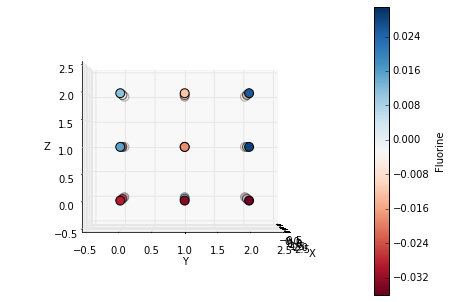

Filter 15 element Nitrogen


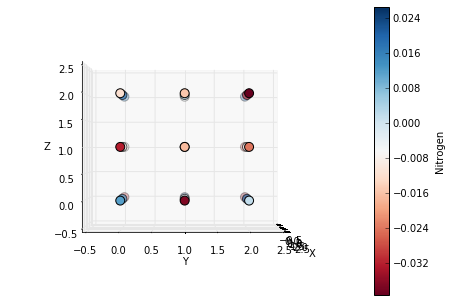

Filter 15 element NitrogenXSAcceptor


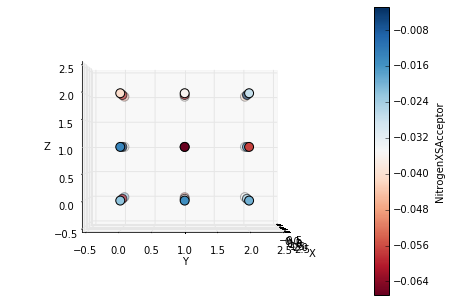

Filter 15 element NitrogenXSDonor


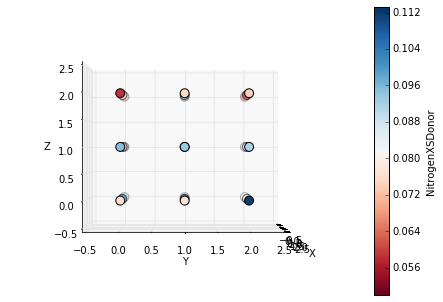

Filter 15 element NitrogenXSDonorAcceptor


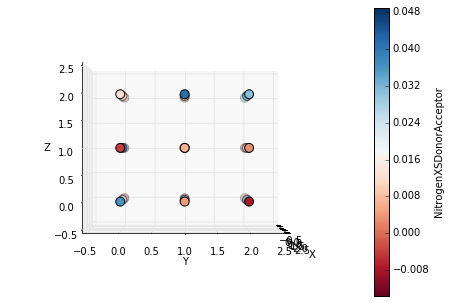

Filter 15 element Oxygen


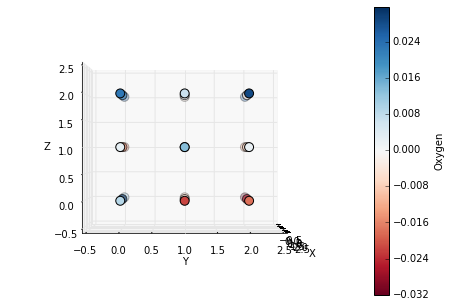

Filter 15 element OxygenXSAcceptor


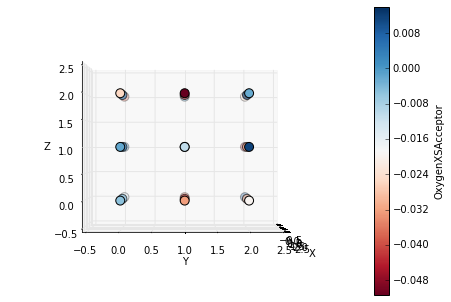

Filter 15 element OxygenXSDonorAcceptor


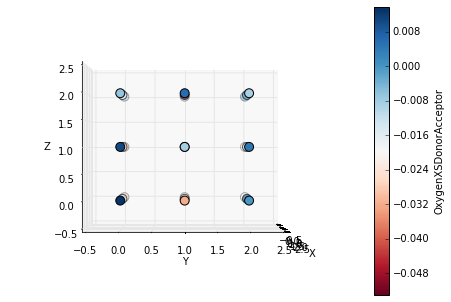

Filter 15 element Phosphorus


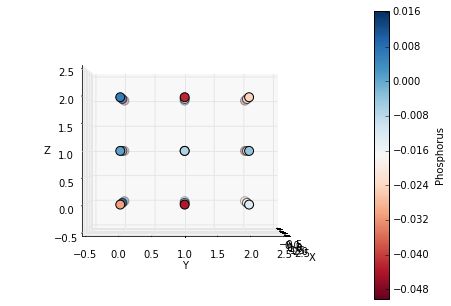

Filter 15 element Sulfur


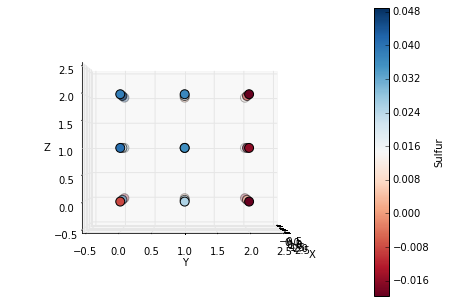

Filter 15 element SulfurAcceptor


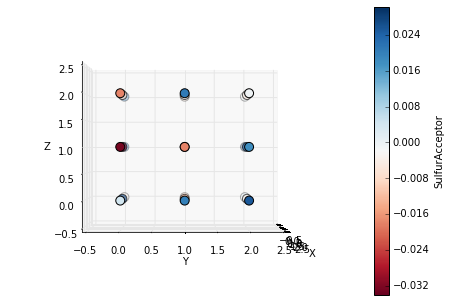

Filter 15 element Iodine


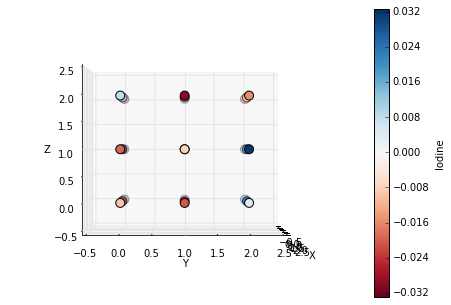

Filter 15 element Boron


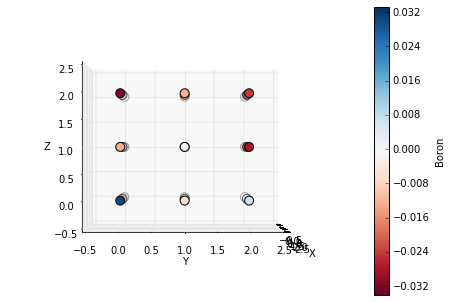

Filter 16 element AliphaticCarbonXSHydrophobe


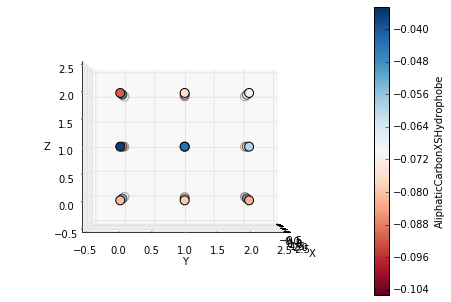

Filter 16 element AliphaticCarbonXSNonHydrophobe


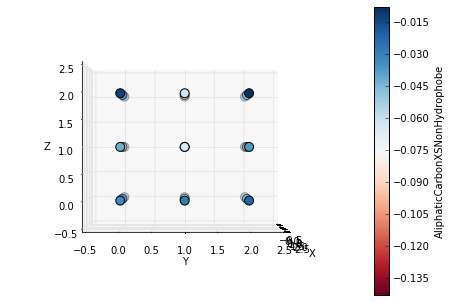

Filter 16 element AromaticCarbonXSHydrophobe


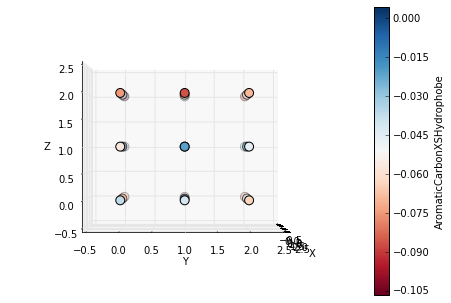

Filter 16 element AromaticCarbonXSNonHydrophobe


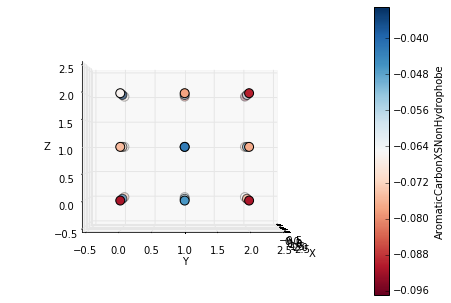

Filter 16 element Calcium


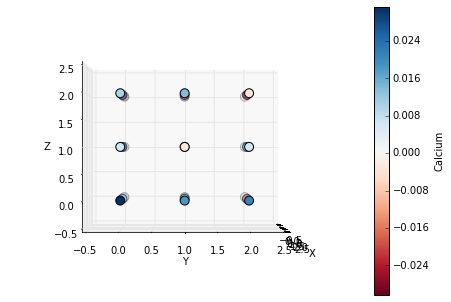

Filter 16 element Iron


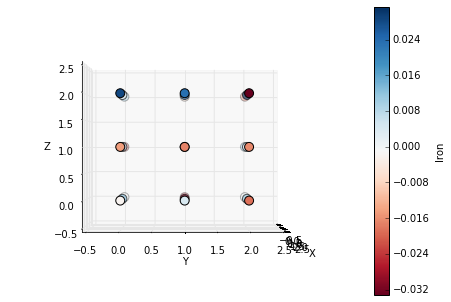

Filter 16 element Magnesium


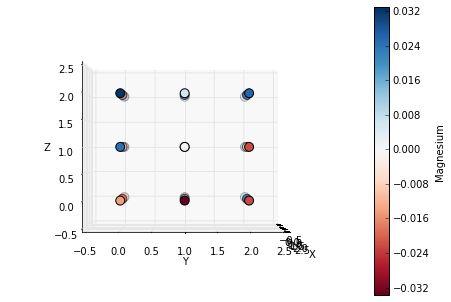

Filter 16 element Nitrogen


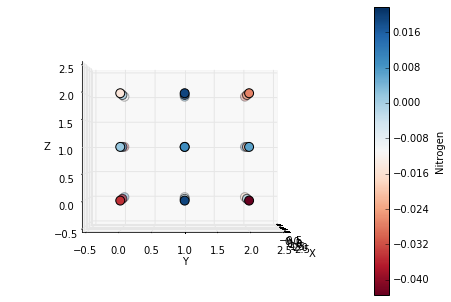

Filter 16 element NitrogenXSAcceptor


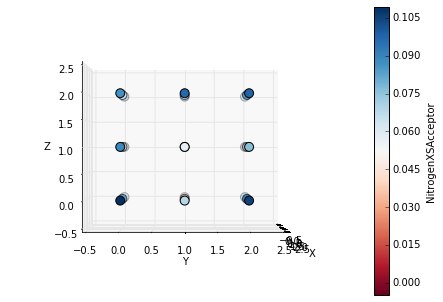

Filter 16 element NitrogenXSDonor


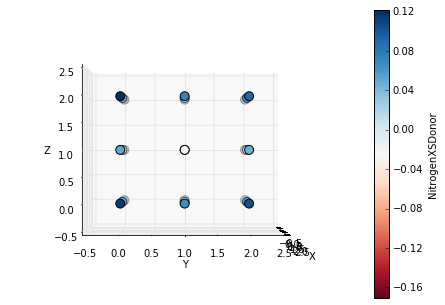

Filter 16 element NitrogenXSDonorAcceptor


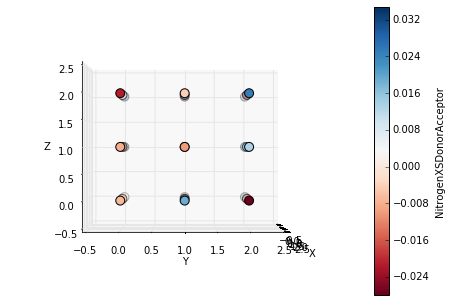

Filter 16 element OxygenXSAcceptor


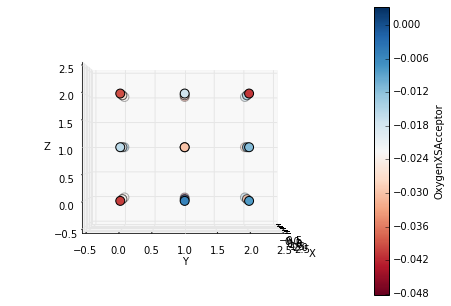

Filter 16 element OxygenXSDonorAcceptor


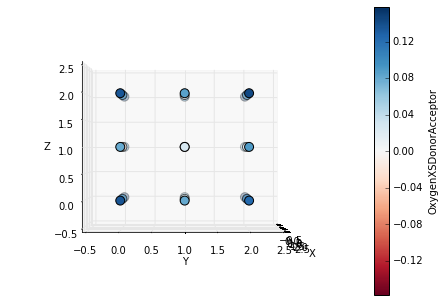

Filter 16 element Phosphorus


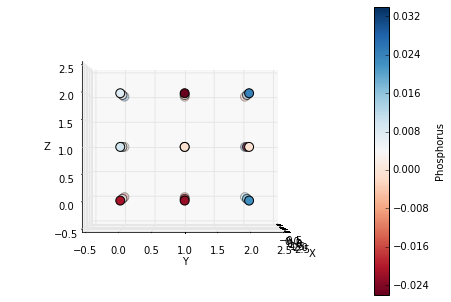

Filter 16 element Sulfur


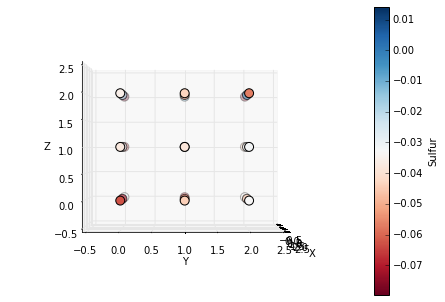

Filter 16 element Zinc


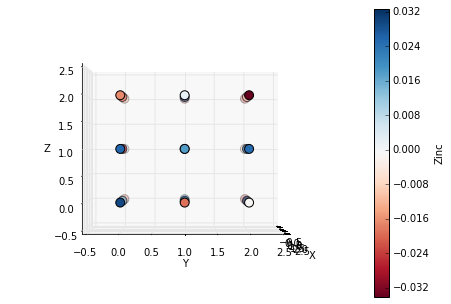

Filter 16 element AliphaticCarbonXSHydrophobe


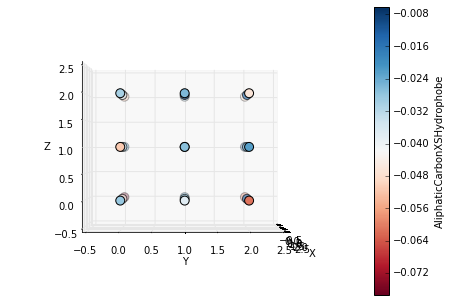

Filter 16 element AliphaticCarbonXSNonHydrophobe


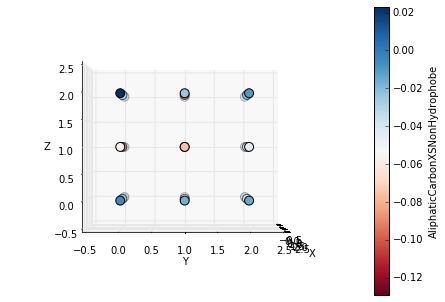

Filter 16 element AromaticCarbonXSHydrophobe


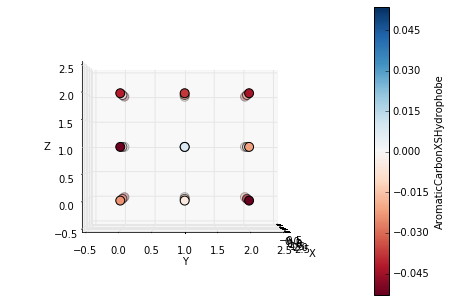

Filter 16 element AromaticCarbonXSNonHydrophobe


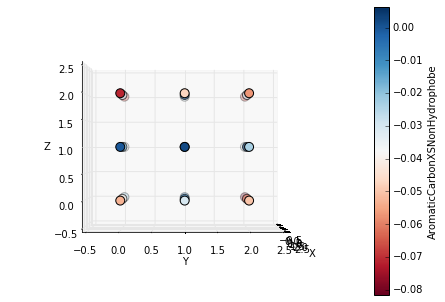

Filter 16 element Bromine


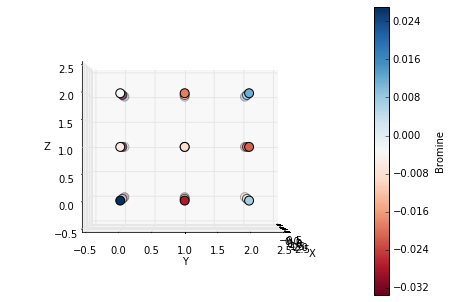

Filter 16 element Chlorine


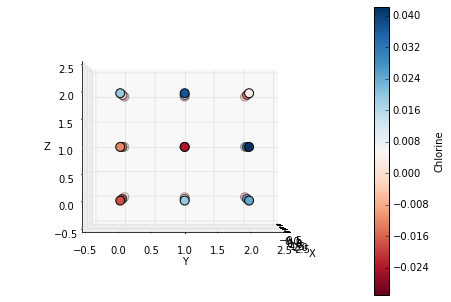

Filter 16 element Fluorine


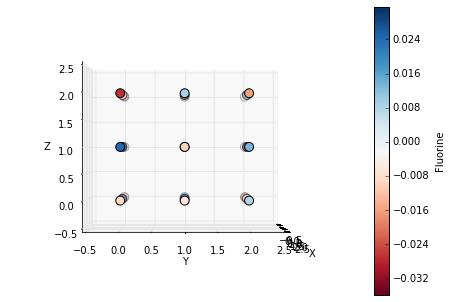

Filter 16 element Nitrogen


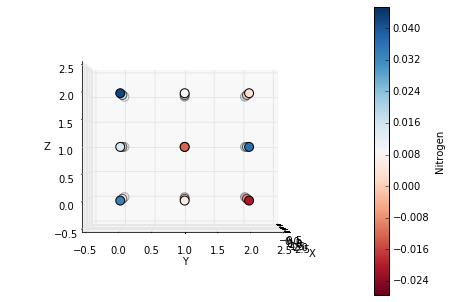

Filter 16 element NitrogenXSAcceptor


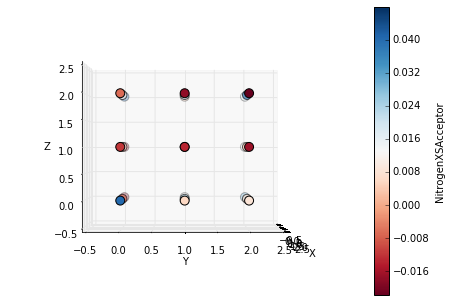

Filter 16 element NitrogenXSDonor


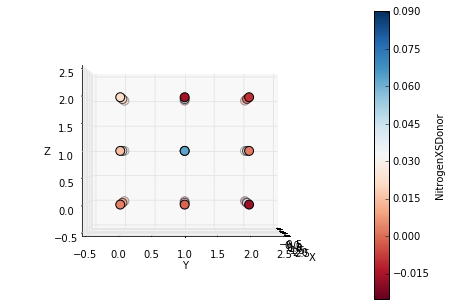

Filter 16 element NitrogenXSDonorAcceptor


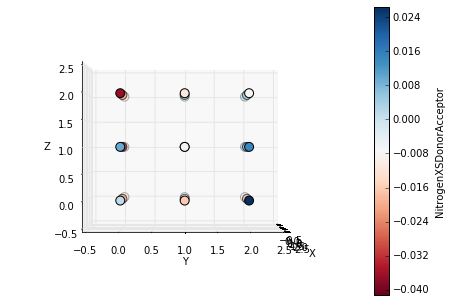

Filter 16 element Oxygen


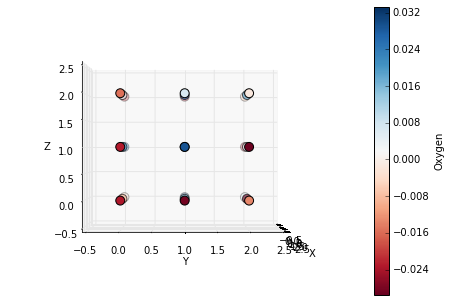

Filter 16 element OxygenXSAcceptor


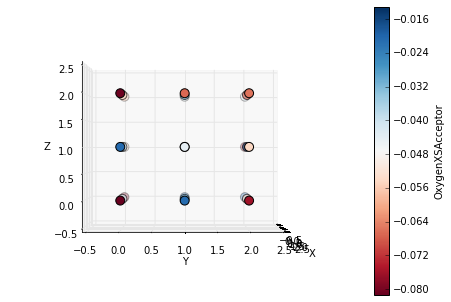

Filter 16 element OxygenXSDonorAcceptor


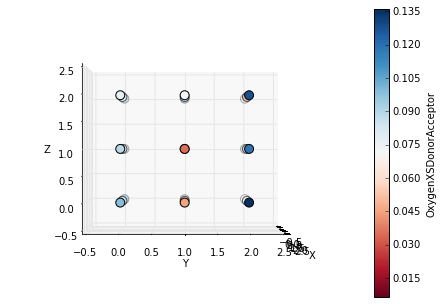

Filter 16 element Phosphorus


KeyboardInterrupt: 

In [8]:
print(np.shape(weights))
means = np.mean(weights,axis=0)

x ,y,z = [],[],[]

for xs in range(3):
    for ys in range(3):
        for zs in range(3):
            x.append(xs)
            y.append(ys)
            z.append(zs)

for i in range(32):
    for j in range(35):
        print("Filter "+str(i)+" element "+ str(elements[j]))
        p = weights[i][j].flatten()
        grid = np.meshgrid(x,y,z)
        scatter3d(x,y,z,p,elements[j])


In [ ]:
fig = plt.figure()
ax = fig.gca(projection='3d')

# Make data.
X = np.arange(-5, 5, 0.25)
Y = np.arange(-5, 5, 0.25)
X, Y = np.meshgrid(X, Y)
R = np.sqrt(X**2 + Y**2)
Z = np.sin(R)

# Plot the surface.
surf = ax.plot_surface(X, Y, Z, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)

# Customize the z axis.
ax.set_zlim(-1.01, 1.01)
ax.zaxis.set_major_locator(LinearLocator(10))
ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.show()

In [ ]:
filts = []
elems = []
filters = conv.blobs[0].data
for i,filter in enumerate(filters):
    for j,element in enumerate(filter):
        if(i == 0):
           elems.append([0,0,0])
        x,y,z = calculate_deviation(element)
        elems[j][0]+=x
        elems[j][1]+=y
        elems[j][2]+=z
        xarr = []
yarr = []
zarr = []
for axis in range(3):
    for elem in elems:
        if(axis == 0):
            xarr.append(elem[axis])
        if(axis == 1):
            yarr.append(elem[axis])
        if(axis == 2):
            zarr.append(elem[axis])
            
make_plot(elements, xarr)
make_plot(elements,yarr)
make_plot(elements, zarr)

In [9]:
#take the mean deviation of each element to each other element
differences = []
for filter in weights:
    means = filter.mean(axis=(1,2,3))
    diff =[]
    for i,mean in enumerate(means):
        elem_diff = []
        for j,other_mean in enumerate(means):
            if(i == j):
                elem_diff.append(0)
            else:
                elem_diff.append(mean-other_mean)
        diff.append(elem_diff)
    differences.append(diff)


In [ ]:
#take the mean deviation of each element to each other element
differences = []
for filter in weights:
    means = filter.mean(axis=(1,2,3))
    diff =[]
    for i,mean in enumerate(means):
        elem_diff = []
        for j,other_mean in enumerate(means):
            if(i == j):
                elem_diff.append(0)
            else:
                elem_diff.append(mean-other_mean)
        diff.append(elem_diff)
    differences.append(diff)

means = []
for num,filt in enumerate(differences):
    for i,elem in enumerate(filt):
        if(num ==0):
            means.append(elem)
        else:
            np.add(elem,means[i])
            
for i,diffs in enumerate(means):
    make_plot(elements,diffs,(-.15,.15),title=elements[i]) 
#make means from deviation list

In [ ]:
differences = []
for filt_i, filter in enumerate(weights):
    filt_diffs = []
    for elem_i, elem in enumerate(filter):
        mean = np.mean(elem)
        elem_diff = []
        for elem_j, elem_1 in enumerate(filter):
            elem_diff.append(mean-np.mean(elem_1))
        filt_diffs.append(elem_diff)
    differences.append(filt_diffs)
    
for i,filt in enumerate(differences):
    for j, elem in enumerate(filt):
        make_plot(elements,elem,(-.15,.15),title=elements[j]+" "+str(i)+" "+str(j)) 
    

In [ ]:
#take the mean deviation of each element to each other element
differences =apply_operation(weights,compute_difference_two)   
print(np.shape(differences))
means1 = np.mean(differences,axis=0)
print(means1)


In [ ]:
fig,ax = plt.subplots(figsize=(14,12))
sns.set(font='helvetica')
sns.heatmap(means1,cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=elements,yticklabels=elements)
ax.invert_yaxis()

In [ ]:
differences = []
for filt_i, filter in enumerate(weights):
    filt_diffs = []
    for elem_i, elem in enumerate(filter):
        mean = np.mean(elem)
        elem_diff = []
        for elem_j, elem_1 in enumerate(filter):
            elem_diff.append(mean-np.mean(elem_1))
        filt_diffs.append(elem_diff)
    differences.append(filt_diffs)
    
for i,filt in enumerate(differences):
    for j, elem in enumerate(filt):
        make_plot(elements,elem,(-.15,.15),title=elements[j]+" "+str(i)+" "+str(j)) 
    

In [ ]:
for i,diff in enumerate(differences):
    print(i)
    for j, differ in enumerate(diff):
        print("    "+str(j))
        make_plot(elements,differ,(-.2,.2),title=elements[j])
    if(i == 1):
        break

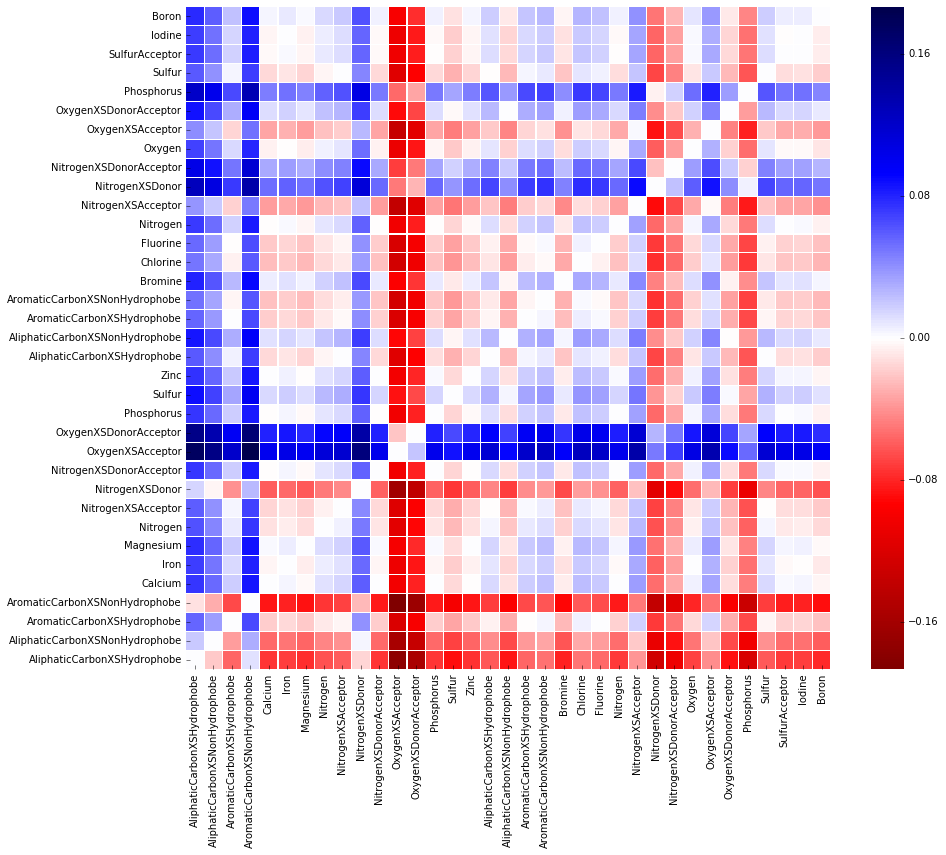

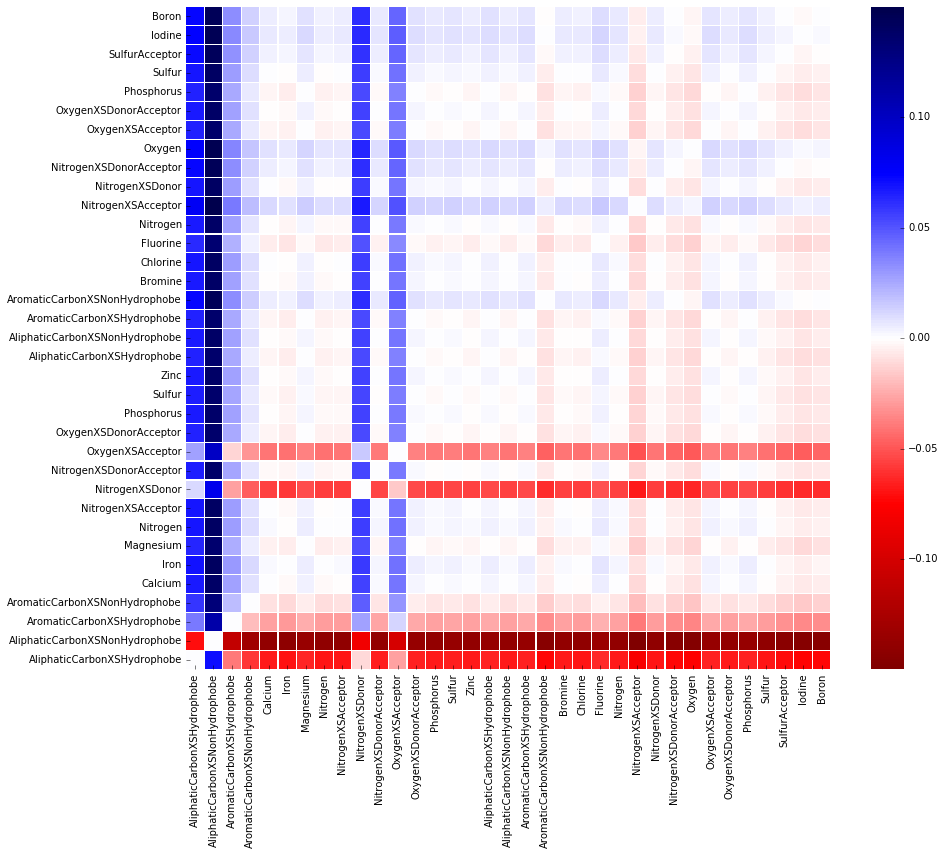

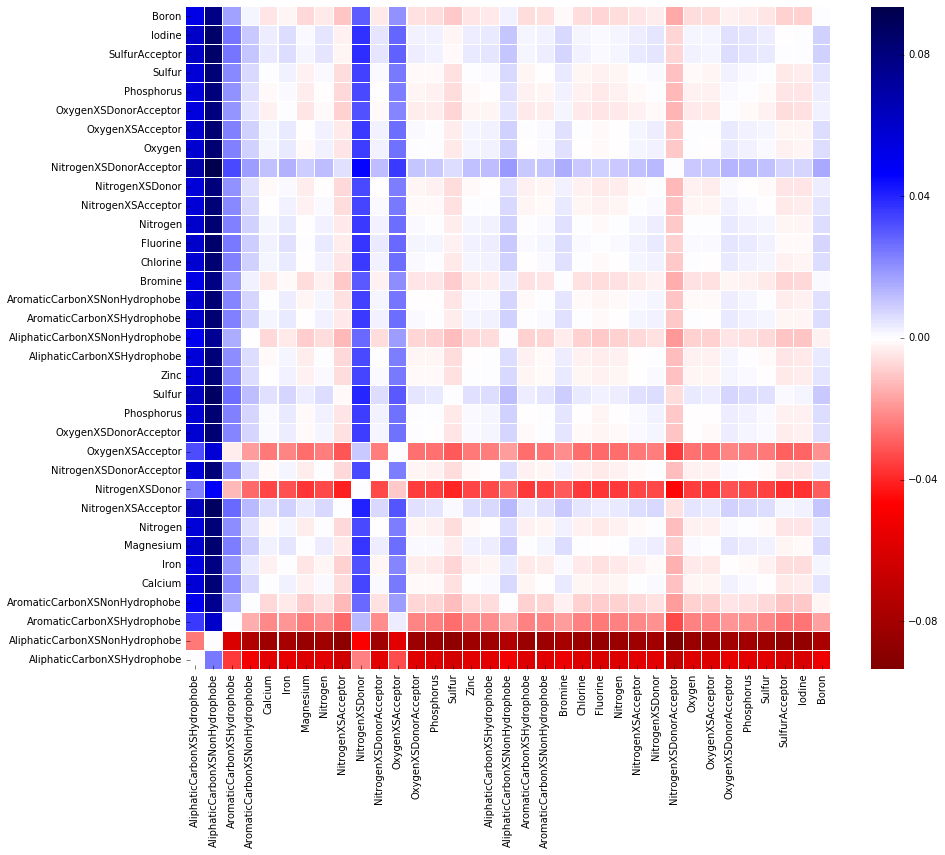

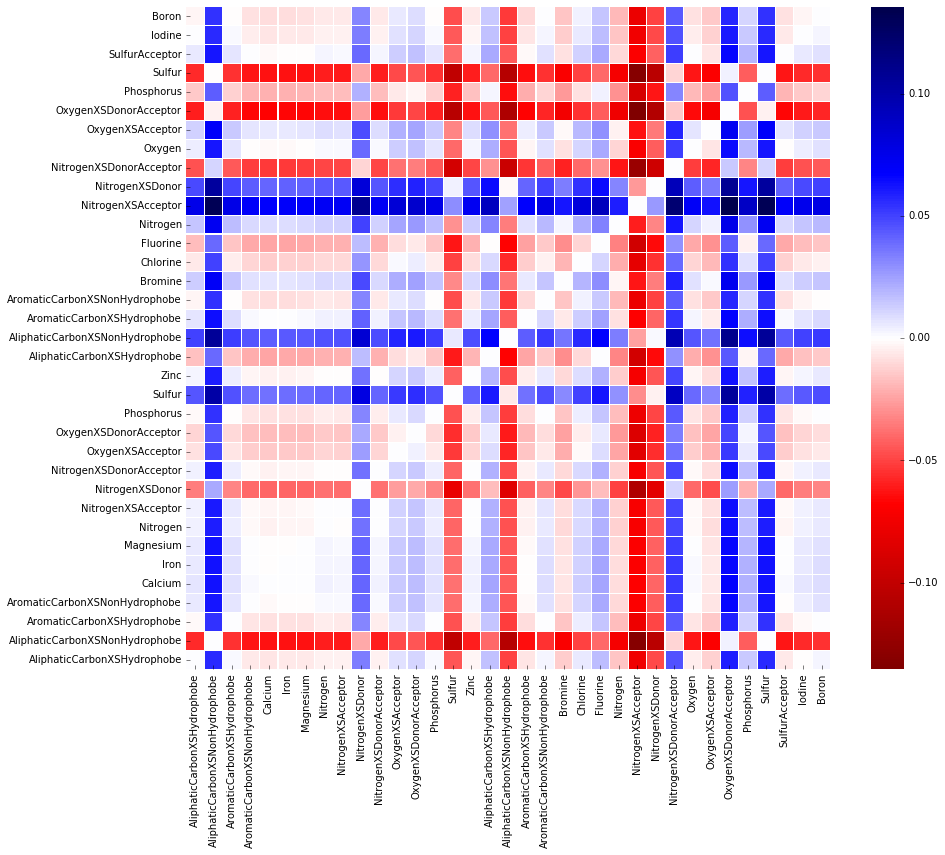

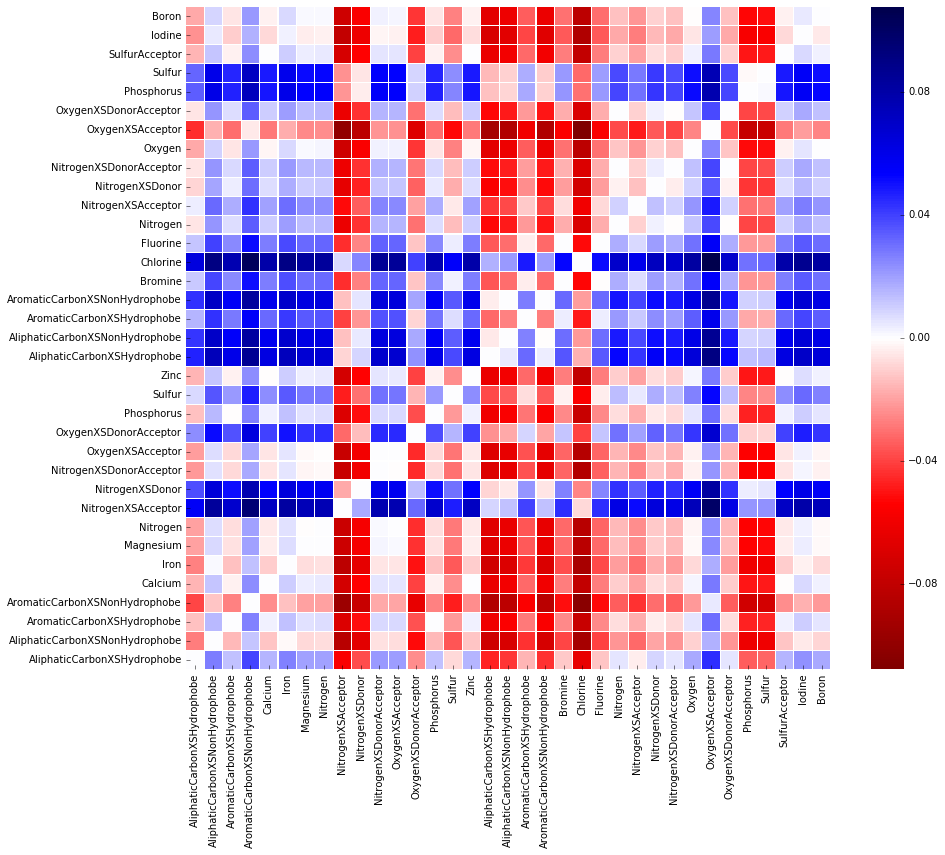

...

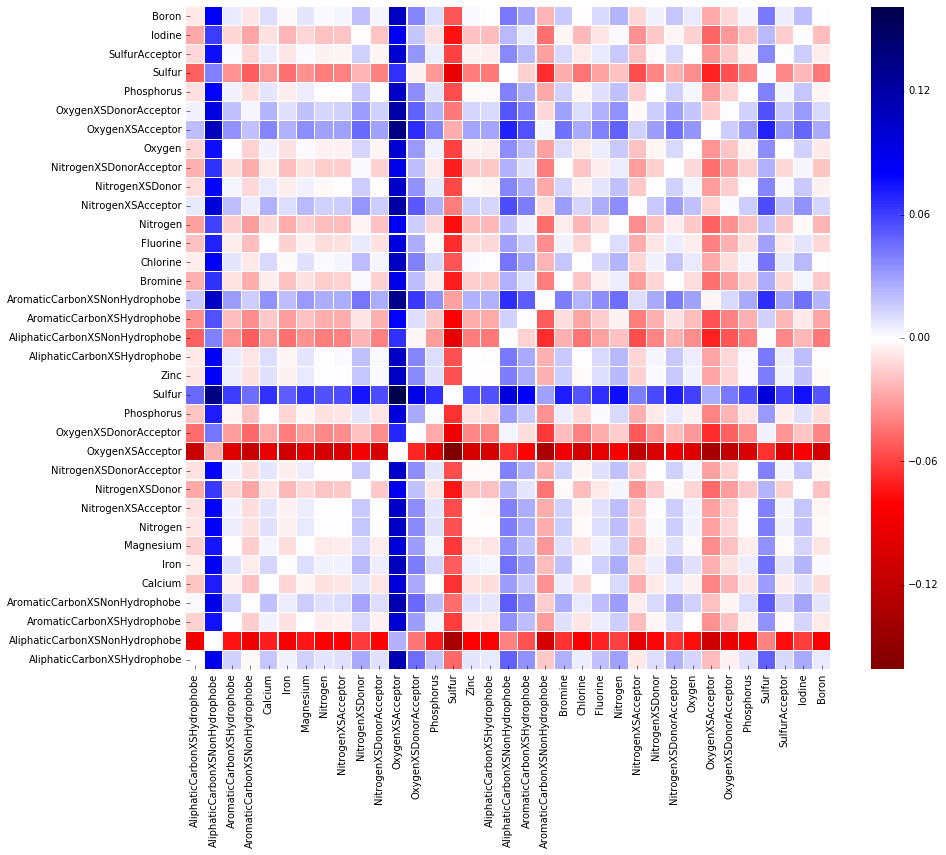

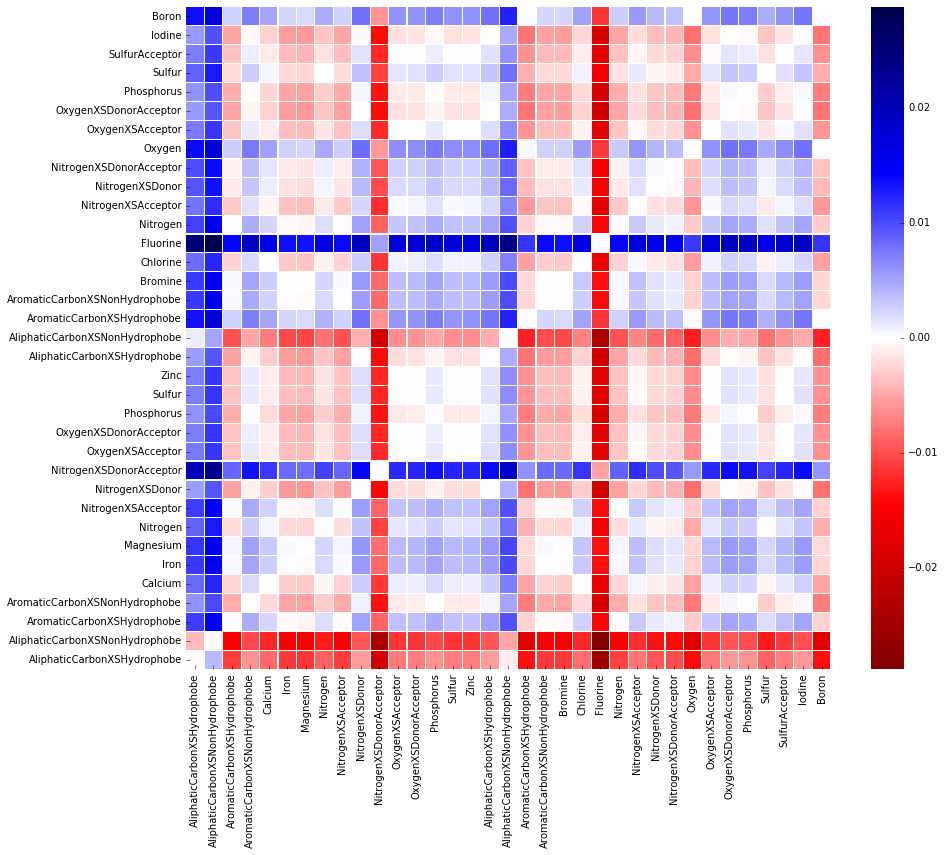

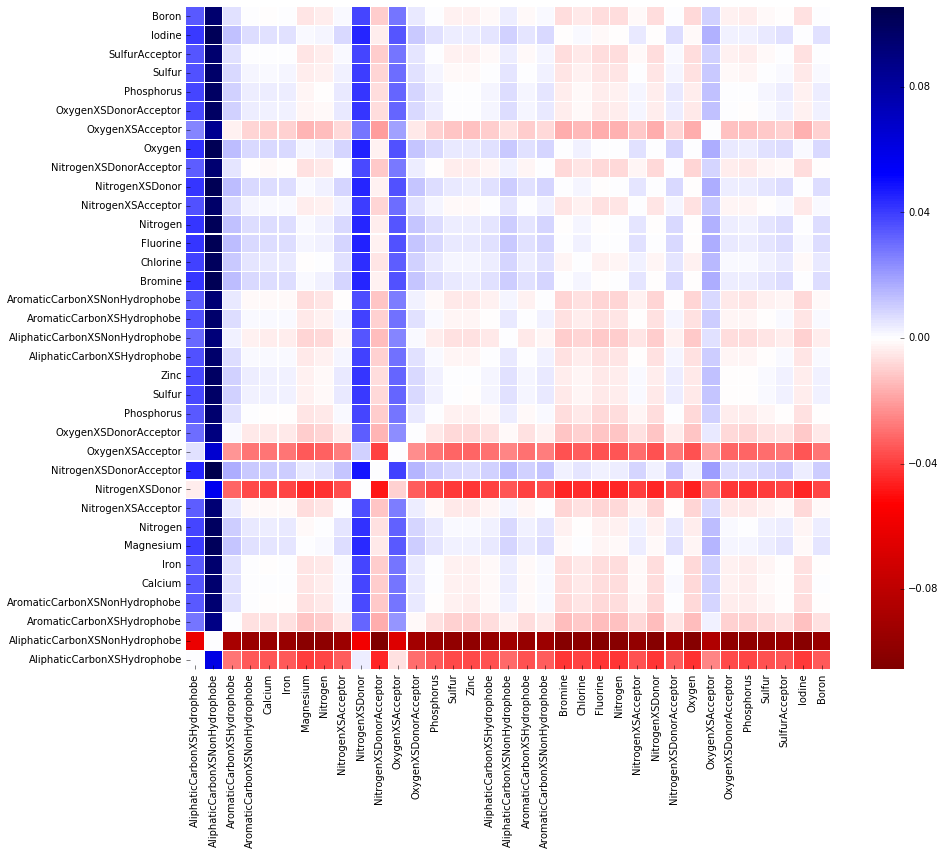

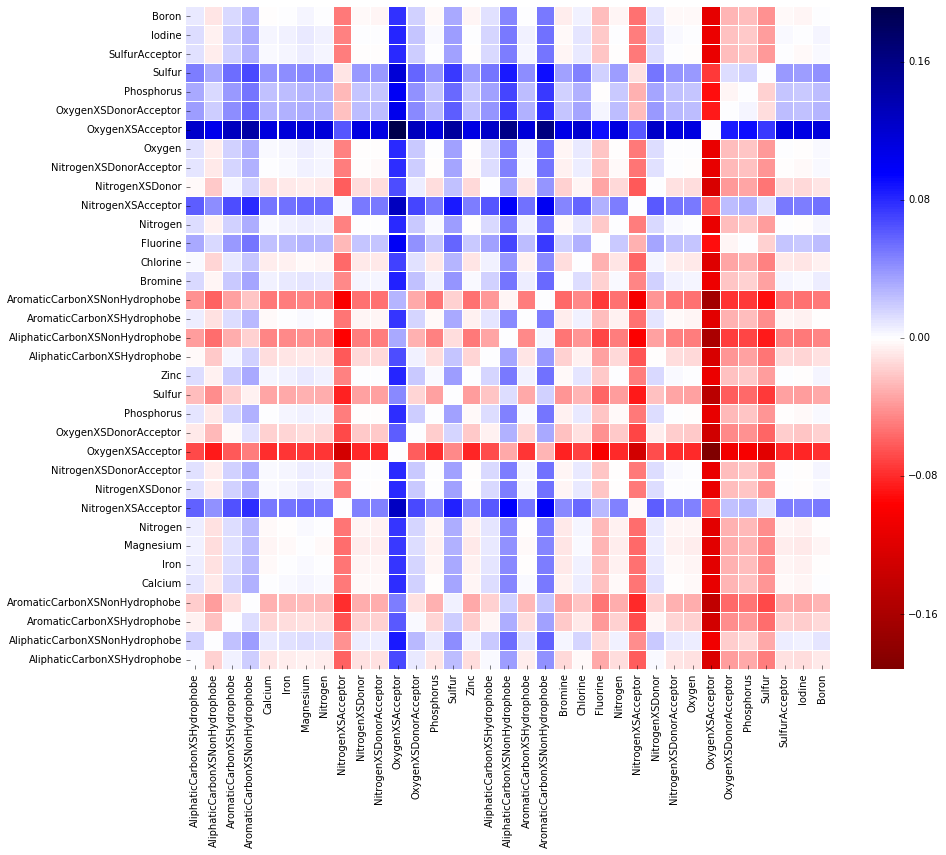

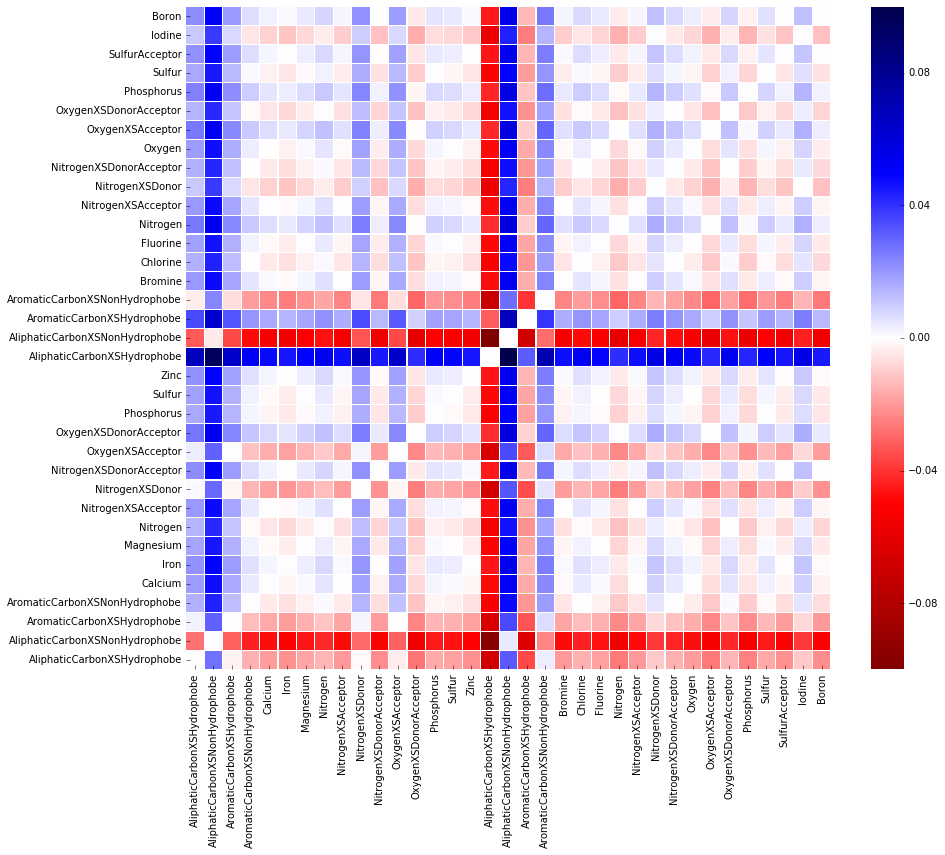

In [14]:
for i,diff in enumerate(differences):
    fig,ax = plt.subplots(figsize=(14,12))
    sns.heatmap(diff,cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=elements,yticklabels=elements)
    ax.invert_yaxis()
    plt.tight_layout()
    fig.savefig("imgs/fig"+str(i)+".png")

(32, 35, 35)


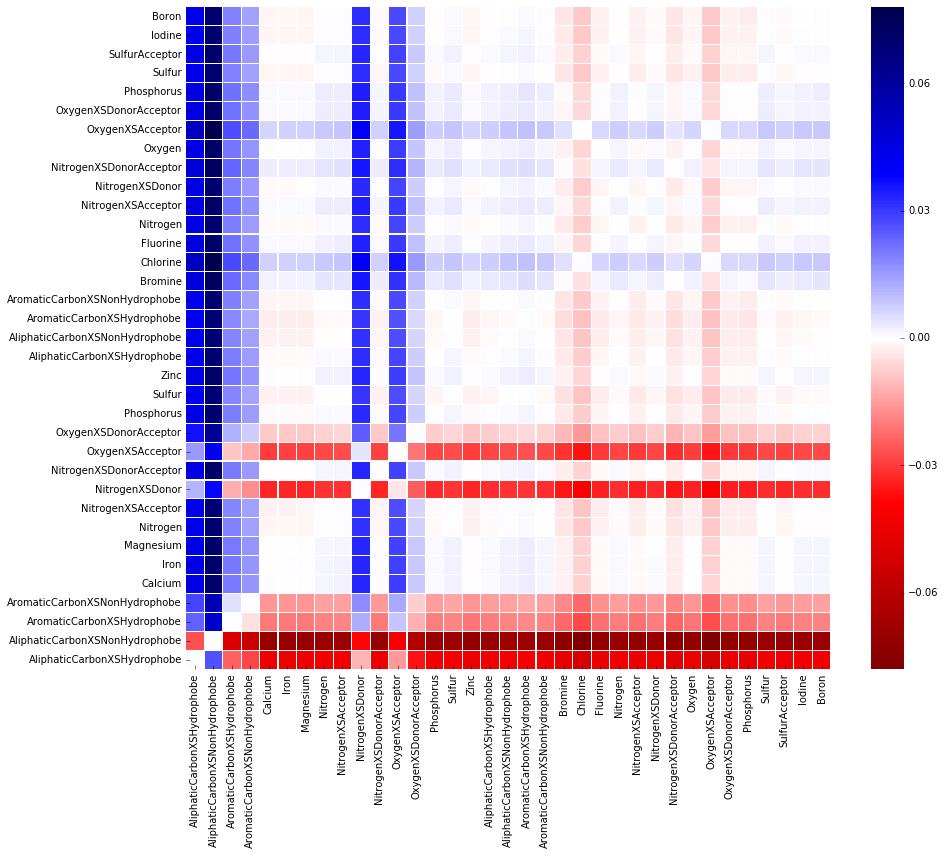

In [20]:
fig,ax = plt.subplots(figsize=(14,12))
print(np.shape(differences))
sns.heatmap(np.mean(differences,axis=0),cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=elements,yticklabels=elements)
ax.invert_yaxis()
plt.tight_layout()
fig.savefig("imgs/fig"+str(i)+".png")

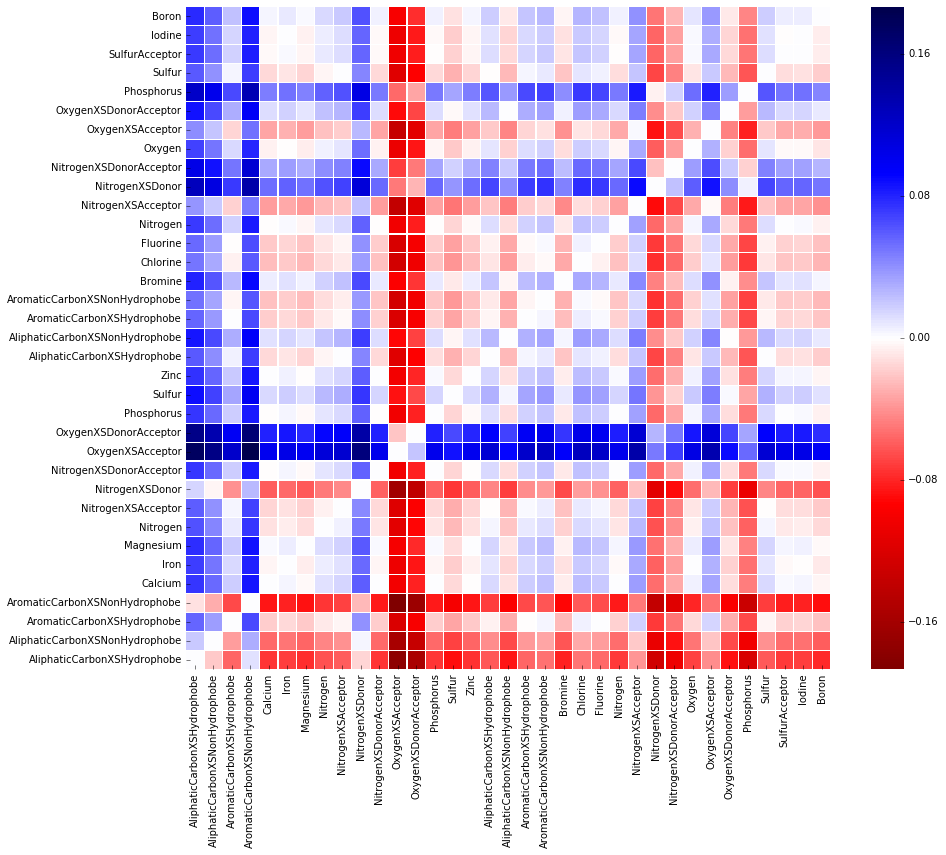

In [10]:
#take the mean deviation of each element to each other element
differences = apply_operation(weights,compute_difference_two)   
fig,ax = plt.subplots(figsize=(14,12))
sns.heatmap(differences[0],cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=elements,yticklabels=elements)
ax.invert_yaxis()
plt.tight_layout()
fig.savefig("imgs/fig"+str(i)+".png")


/usr/lib/python2.7/dist-packages/matplotlib/figure.py:1744: UserWarning: This figure includes Axes that are not compatible with tight_layout, so its results might be incorrect.
  warnings.warn("This figure includes Axes that are not "


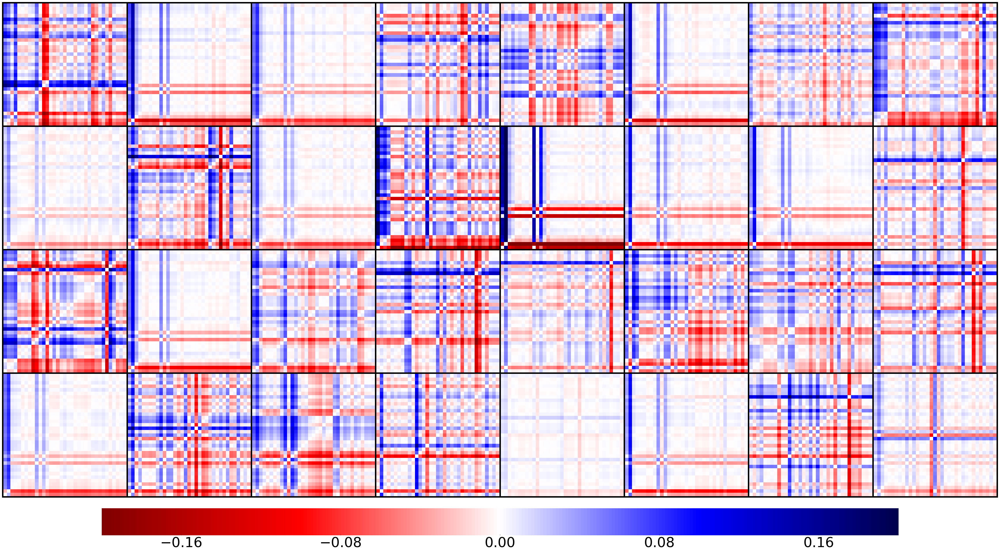

In [11]:
differences = apply_operation(weights,compute_difference_two)   
display_heatmap_grid((4,8),differences,[-.2,.2])

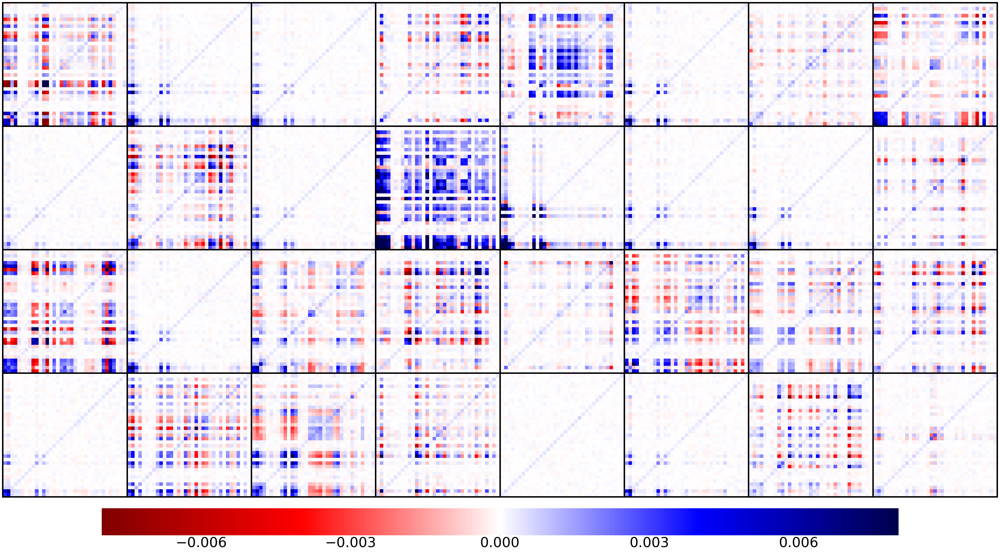

In [12]:
products = apply_operation(weights,compute_product_two)   
display_heatmap_grid((4,8),products,[-.008,.008])

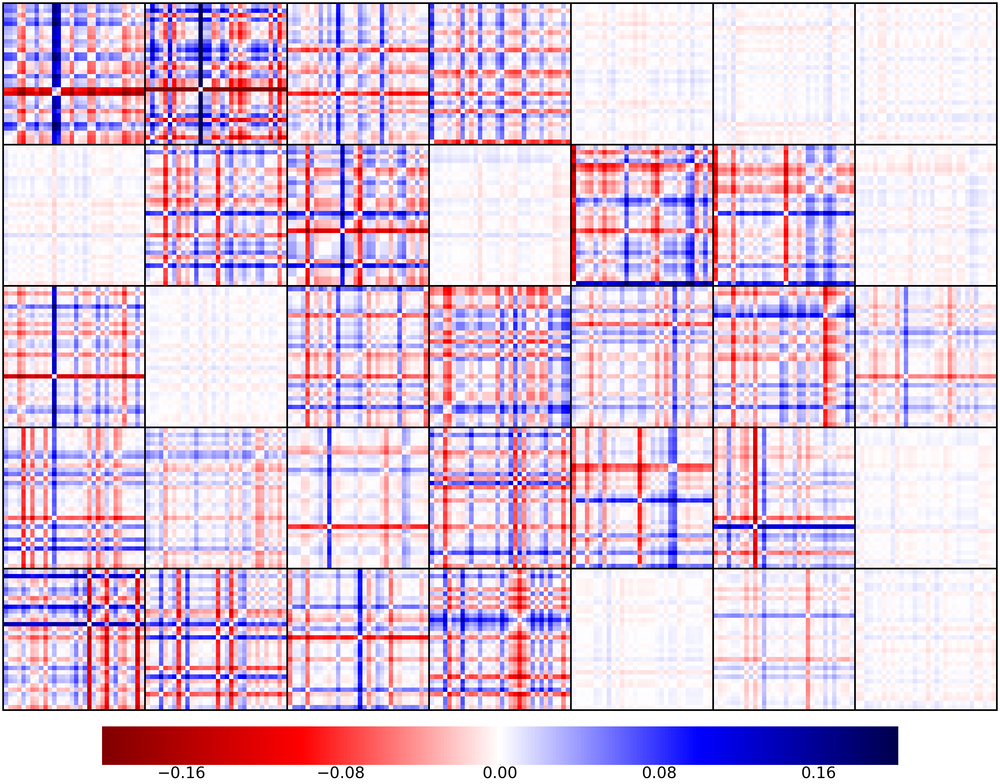

In [13]:
new_weights = weights[:]
new_weights = np.rollaxis(new_weights,axis=1)
diffs = apply_operation(new_weights,compute_difference_two)    
display_heatmap_grid((5,7),diffs,[-.2,.2])

In [15]:
new_weights = weights[:]
print(np.shape(vals))
vals = []
for filter in new_weights:
    diff =[]
    for i,elem in enumerate(filter):
        diff.append(np.mean(calculate_deviation(elem)))
    vals.append(diff)
fig,ax = plt.subplots(figsize=(14,12))
sns.heatmap(vals,cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=elements, vmin=-.05,vmax=.05)
ax.invert_yaxis()
plt.tight_layout()

NameError: name 'vals' is not defined

In [ ]:
new_weights = weights[:]

print(np.shape(norms))
vals = []
for filter in new_weights:
    diff =[]
    for i,elem in enumerate(filter):
        elem_diff = []
        for j,elem1 in enumerate(filter):
            elem_diff.append(np.mean(calculate_deviation(elem))-np.mean(calculate_deviation(elem1)))
        #elem_diff.insert(16,0.0)
        diff.append(elem_diff)
    
    #diff.insert(16,np.asarray(np.zeros((36))))
    vals.append(diff)
vals = np.mean(vals,axis=0)
print(np.shape(vals))
print(np.max(vals))
fig,ax = plt.subplots(figsize=(14,12))
sns.heatmap(vals,cmap='Reds',ax = ax, linewidths = 0.1,xticklabels=elements, yticklabels=elements,vmin=0,vmax=1000)
ax.invert_yaxis()
plt.tight_layout()


In [ ]:
fig,ax = plt.subplots(figsize=(14,12))
sns.heatmap(differences[1],cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=new_elements,yticklabels=new_elements)
ax.invert_yaxis()
plt.tight_layout()


fig,ax = plt.subplots(figsize=(14,12))
sns.heatmap(differences[5],cmap='seismic_r',ax = ax, linewidths = 0.1,xticklabels=new_elements,yticklabels=new_elements)
ax.invert_yaxis()
plt.tight_layout()

data = []
nums=[]
cnt=0
for filt in weights:
    data.append(compute_deviation_two(weights[1],filt))
    nums.append(cnt)
    cnt=cnt+1
print(len(data))
make_plot(nums,data)

In [ ]:
std = np.mean(np.std(weights,axis=(2,3,4)),axis=(0,1))
mean = np.mean(weights,axis=(0,1,2,3,4))
#random_arr = np.random.rand(32,35,3,3,3)*2 -1
random_arr = np.random.normal(loc=mean,scale = std,size =(32,35,3,3,3))
average = 0
cnt = 0
for filter in weights:
    for elem in filter:
        cnt+=1
        average+= compute_symetry(elem)
average_rand = 0

for filter in random_arr:
    for elem in filter:
        average_rand+= compute_symetry(elem)
        
average_rand/=cnt
average/=cnt

print(average,average_rand)

In [ ]:
syms = []
for filter in weights:
    filt = []
    syms.append(filt)
    for elem in filter:
        sym = compute_symetry(elem)
        filt.append(sym)
        
flat =np.array(syms).flatten()

fig = matplotlib.pyplot.figure()
ax = fig.add_subplot(1,1,1)
n,bins,patches = ax.hist(flat,bins=100)


In [ ]:
flat = np.ndarray.flatten(weights)

matplotlib.pyplot.hist(flat,1000)
matplotlib.pyplot.hist(flat,1000,range=[-0.2,0.2])

In [ ]:
for filt in weights:
    for elem in filt:
        flat = np.ndarray.flatten(elem)
        fig = matplotlib.pyplot.figure()
        ax = fig.add_subplot(1,1,1)
        n,bins,patches = ax.hist(flat,bins=100)
        #matplotlib.pyplot.hist(flat)


In [ ]:
reduced = np.mean(weights,axis=0)
print(np.shape(reduced))

for i,elem in enumerate(reduced):
    flat = np.ndarray.flatten(elem)
    fig = matplotlib.pyplot.figure()
    ax = fig.add_subplot(1,1,1)
    n,bins,patches = ax.hist(flat,100,range=[-.1,.1])
    ax.set_title(elements[i])

In [ ]:
copy = np.copy(weights)
print(np.shape(copy))
copy = np.swapaxes(copy,0,1)
copy = np.reshape(copy,(35,864))
print(np.shape(copy))
for i,elem in enumerate(copy):
    flat = np.ndarray.flatten(elem)
    fig = matplotlib.pyplot.figure()
    ax = fig.add_subplot(1,1,1)
    n,bins,patches = ax.hist(flat,400,range=[-.2,.2])
    ax.set_title(elements[i])

In [ ]:
indices = [[],[],[]]

for filter in weights:
    for element in filter:
        comp = compute_edge_index(element)
        indices[0].append(comp[0])
        indices[1].append(comp[1])
        indices[2].append(comp[2])
axis = ["x","y","z"]
for i,ind in enumerate(indices):
    fig = matplotlib.pyplot.figure()
    ax = fig.add_subplot(1,1,1)
    n,bins,patches = ax.hist(ind,150,range=[0,1])
    ax.set_ylim([0,70])
    ax.set_title(axis[i])
    print(scipy.stats.skew(ind))

In [ ]:
threshold = .4
locs = []
for i,filter in enumerate(weights):
    for j,elem in enumerate(filter):
        edge = compute_edge_index(elem)
        for p,t in enumerate(edge):
            if(t > threshold):
                print("edge index : "+str(t)+" location : "+ str((i,elements[j],p)))
                locs.append((i,j,p,t))

In [ ]:
#creates a 3d plot for all of the outstanding grids
x,y,z=[],[],[]
for xs in range(3):
    for ys in range(3):
        for zs in range(3):
            x.append(xs)
            y.append(ys)
            z.append(zs)
for grid in locs:
    p = weights[grid[0]][grid[1]].flatten()
    grids = np.meshgrid(x,y,z)
    print(x,y,z)
    scatter3d(x,y,z,p,"edge index : " + str(grid[3]) + " location : " + str((grid[0],elements[grid[1]],grid[2])),rotate=(90,0))
  
    

In [ ]:
indices = []

for i,filter in enumerate(weights):
    for j,element in enumerate(filter):
        if(i == 0):
            elem = [[],[],[]]
            indices.append(elem)
        comp = compute_edge_index(element)
        indices[j][0].append(comp[0])
        indices[j][1].append(comp[1])
        indices[j][2].append(comp[2])
        
axis = ["x","y","z"]
for i,ind in enumerate(indices):
    for j,axis in enumerate(ind):
        fig = matplotlib.pyplot.figure()
        ax = fig.add_subplot(1,1,1)
        n,bins,patches = ax.hist(axis,50)
        ax.set_title(str(elements[i]))

In [ ]:
elements = []
for i,filter in enumerate(weights):
    for j,element in enumerate(filter):
        if(i == 0):
            elements.append([])
        elements[j]=np.concatenate((elements[j],element.flatten()))
        
for i,elem in enumerate(elements):
    fig = matplotlib.pyplot.figure()
    ax = fig.add_subplot(1,1,1)
    n,bins,patches = ax.hist(elem,100,range=[-.1,.1])
    ax.set_title(elements[i])     

In [ ]:

    
for i,filter in enumerate(weights):
    for j,element in enumerate(filter):
        print("filter "+str(i)+"  element  "+ elements[j])
        create_image(element)

    


In [ ]:
def create_img(arr,scale=30):
    maximum = 1
    minimum = -1
    range_ = maximum-minimum
    if range_ ==0:
        range_ = 2
    img = np.array([((num+abs(minimum))/range_ * 255) for num in arr.flatten()]).reshape(3,3,3)
    print("create")
    img=scipy.misc.imresize(img,(300,300),interp='nearest')
    showarray(img)
create_img(np.zeros((3,3,3)))

In [ ]:
create_img(np.zeros((3,3,3)))
create_img(np.full_like(np.zeros((3,3,3)),1))
edge = np.append([],[np.full_like(np.zeros((3,3)),-1),np.full_like(np.zeros((3,3)),0),np.full_like(np.zeros((3,3)),1)])
create_img(edge)
edge = np.append([],[np.full_like(np.zeros((3,3)),1),np.full_like(np.zeros((3,3)),0),np.full_like(np.zeros((3,3)),-1)])
create_img(edge)


In [ ]:
for i in range(-100,100):
    edge = np.append([],[np.full_like(np.zeros((3,3)),i/100),np.full_like(np.zeros((3,3)),0),np.full_like(np.zeros((3,3)),-1)])
    create_image(edge)